# First look at the LoVoCCs sample as observed by XMM

## Import Statements

In [236]:
import pandas as pd
from astropy.units import Quantity, Unit
from astropy.cosmology import Planck15, LambdaCDM
from astropy.coordinates import SkyCoord
from matplotlib import pyplot as plt
from matplotlib.patches import Circle
from matplotlib.lines import Line2D
import numpy as np
from tqdm import tqdm
import os
from random import randint
from subprocess import Popen, PIPE
import pickle

import xga
xga.NUM_CORES = 40
from xga.samples import ClusterSample
from xga.imagetools.misc import physical_rad_to_pix
from xga.sourcetools.misc import rad_to_ang, nh_lookup
from xga import CENSUS, COUNTRATE_CONV_SCRIPT
from xga.relations.clusters.LT import xcs_sdss_r500_52
from xga.products.relation import ScalingRelation
from xga.sourcetools.match import simple_xmm_match

## Useful functions

In [2]:
def match_obs_pos(obs_ids):
    rel_census = CENSUS[CENSUS['ObsID'].isin(obs_ids)][['RA_PNT', 'DEC_PNT']]
    return rel_census

## Setting up cosmology

Using the same cosmology as in the LoVoCCs sample paper (https://iopscience.iop.org/article/10.3847/1538-4357/ac68e8#artAbst):

In [3]:
cosmo = LambdaCDM(71, 0.2648, 0.6904, 0.0448)

## Reading in the sample file

In [4]:
sample = pd.read_csv("lovoccs_southnorth.csv")
sample.head(10)

,name,MCXC,ra,dec,redshift,L500,M500,R500,alt_name,other_names,Notes
0,MCXCJ0005.3+1612,J0005.3+1612,1.344167,16.210556,0.1164,1.579007,2.4929,0.9218,RXCJ0005.3+1612,A2703,B
1,MCXCJ0006.0-3443,J0006.0-3443,1.512500,-34.724167,0.1147,1.809494,2.7122,0.9486,RXCJ0006.0-3443,A2721,NaN
2,MCXCJ0011.3-2851,J0011.3-2851,2.836250,-28.855000,0.0620,1.086002,2.0611,0.8807,RXCJ0011.3-2851,A2734,losStr
3,MCXCJ0011.7+3225,J0011.7+3225,2.935000,32.416944,0.1073,2.571958,3.3785,1.0232,RXCJ0011.7+3225,A7,NaN
4,MCXCJ0013.6-1930,J0013.6-1930,3.409583,-19.502222,0.0940,1.236332,2.1818,0.8883,RXCJ0013.6-1930,A13,losStr
5,MCXCJ0020.6+2840,J0020.6+2840,5.170417,28.675000,0.0940,1.434697,2.3890,0.9156,RXCJ0020.6+2840,A21,NaN
6,MCXCJ0028.6-2338,J0028.6-2338,7.163750,-23.637222,0.1120,1.404549,2.3285,0.9024,RXCJ0028.6-2338,A42,NaN
7,MCXCJ0034.2-0204,J0034.2-0204,8.557917,-2.075278,0.0822,1.230023,2.1930,0.8933,RXCJ0034.2-0204,SH518,NaN
8,MCXCJ0034.6-0208,J0034.6-0208,8.650000,-2.140000,0.0812,1.253723,2.2202,0.8972,RXCJ0034.6-0208,NaN,"DL,two maxima/E-W"
9,MCXCJ0041.7+2124,J0041.7+2124,10.446250,21.413889,0.1014,1.000012,1.9071,0.8473,RXCJ0041.7+2124,A84,NaN


## Declaring an XGA sample

In [5]:
ra = sample['ra'].values
dec = sample['dec'].values
z = sample['redshift'].values
name = sample['name'].values
r500 = Quantity(sample['R500'].values, 'Mpc')
lovoccs_noclean = ClusterSample(sample['ra'].values, sample['dec'].values, sample['redshift'].values, 
                                sample['name'].values, r500=r500, use_peak=False, clean_obs=False)

Declaring BaseSource Sample:   4%|█▊                                          | 6/144 [00:14<05:33,  2.42s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/samples/base.py:90: UserWarning: Source MCXCJ0028.6-2338 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:   6%|██▊                                         | 9/144 [00:19<04:08,  1.84s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/samples/base.py:90: UserWarning: Source MCXCJ0041.7+2124 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ0041.8-0918 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0744411701/0744411701_pn_MCXCJ0041.8-0918_ra10.45875_dec-9.3019444

Declaring BaseSource Sample:  24%|██████████▏                                | 34/144 [01:16<06:51,  3.74s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/samples/base.py:90: UserWarning: Source MCXCJ0704.4+6318 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/samples/base.py:90: UserWarning: Source MCXCJ0726.0+4122 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/samples/base.py:90: UserWarning: Source MCXCJ0736.4+3925 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  26%|███████████                                

Declaring BaseSource Sample:  39%|████████████████▋                          | 56/144 [01:45<00:56,  1.55it/s]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1217.6+0339 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0744413201/0744413201_mos2_MCXCJ1217.6x0339_ra184.4191667_dec3.6625_ri0.0_ro0.05558832233548602_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1217.6+0339 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0744413201/0744413201_pn_MCXCJ1217.6x0339_ra184.4191667_dec3.6625_ri0.0_ro0.05558832233548602_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in ava

Declaring BaseSource Sample:  44%|███████████████████                        | 64/144 [02:09<02:53,  2.17s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1327.9-3130 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0744930201/0744930201_pn_MCXCJ1327.9-3130_ra201.9895833_dec-31.5025_ri0.0_ro0.08576134693978738_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1327.9-3130 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0601980101/0601980101_pn_MCXCJ1327.9-3130_ra201.9895833_dec-31.5025_ri0.0_ro0.08576134693978738_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in a

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1510.9+0543 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0744411101/0744411101_pn_MCXCJ1510.9x0543_ra227.7291667_dec5.72_ri0.0_ro0.05558832233548602_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1510.9+0543 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0744410901/0744410901_mos1_MCXCJ1510.9x0543_ra227.7291667_dec5.72_ri0.0_ro0.05558832233548602_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1510.9+0543 spectrum /

Declaring BaseSource Sample:  67%|████████████████████████████▋              | 96/144 [03:16<02:12,  2.76s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/samples/base.py:90: UserWarning: Source MCXCJ1601.3+5354 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  69%|█████████████████████████████▌             | 99/144 [03:20<01:27,  1.95s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1628.6+3932 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0784521201/0784521201_pn_MCXCJ1628.6x3932_ra247.1583333_dec39.54861111_ri0.0_ro0.1347193456515133_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
Declaring BaseSource Sample:  72%|███████████████████████

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ2312.3-2130 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0783380150/0783380150_pn_MCXCJ2312.3-2130_ra348.08625_dec-21.50055556_ri0.0_ro0.039983803787957246_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ2312.3-2130 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0783380153/0783380153_mos1_MCXCJ2312.3-2130_ra348.08625_dec-21.50055556_ri0.0_ro0.039983803787957246_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ2312.3-2

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/general.py:124: UserWarning: MCXCJ0034.2-0204 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters:   8%|███▌                                         | 9/112 [00:06<01:17,  1.34it/s]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ0041.8-0918 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0744411701/0744411701_pn_MCXCJ0041.8-0918_ra10.45875_dec-9.301944444_ri0.0_ro0.07483683952865848_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ0041.8-0918 spectru

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/general.py:124: UserWarning: MCXCJ0342.8-5338 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters:  27%|███████████▊                                | 30/112 [00:30<01:30,  1.10s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/extended.py:221: UserWarning: A point source has been detected in 0300210401 and is very close to the user supplied coordinates of MCXCJ0425.8-0833. It will not be excluded from analysis due to the possibility of a mis-identified cool core
  warnings.warn("A point source has been detected in {o} and is very close to the user supplied "
Setting up Galaxy Clusters:  28%|████████████▏                               | 31/112 [00:30<01:17,  1.05it/s]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/extended.py:225: UserWarning: A PSF sized extended source has been detected in 0109980301 and is very close to the user supplied coordinates of MCXCJ0918.1-1205. It will not be excluded from analysis due to the possibility of a mis-identified cool core
  warnings.warn("A PSF sized extended source has been detected in {o} and is very close to the "
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/general.py:124: UserWarning: MCXCJ0918.1-1205 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters:  47%|████████████████████▊                       | 53/112 [01:12<00:45,  1.29it/s]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1217.6+0339 spectrum /mnt/lustre/projects/astro/general/dt237/lovoc

Setting up Galaxy Clusters:  54%|███████████████████████▌                    | 60/112 [01:20<01:08,  1.31s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1257.2-3022 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0861150301/0861150301_pn_MCXCJ1257.2-3022_ra194.3204167_dec-30.37694444_ri0.0_ro0.07496302538808206_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1257.2-3022 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0861150301/0861150301_mos2_MCXCJ1257.2-3022_ra194.3204167_dec-30.37694444_ri0.0_ro0.07496302538808206_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mis

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/general.py:124: UserWarning: MCXCJ1413.7+4339 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters:  71%|███████████████████████████████▍            | 80/112 [01:36<00:15,  2.06it/s]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1510.9+0543 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0823650101/0823650101_mos1_MCXCJ1510.9x0543_ra227.7291667_dec5.72_ri0.0_ro0.05558832233548602_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ1510.9+0543 spectrum /

Setting up Galaxy Clusters:  75%|█████████████████████████████████           | 84/112 [01:48<00:39,  1.43s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/extended.py:225: UserWarning: A PSF sized extended source has been detected in 0109920101 and is very close to the user supplied coordinates of MCXCJ1516.7+0701. It will not be excluded from analysis due to the possibility of a mis-identified cool core
  warnings.warn("A PSF sized extended source has been detected in {o} and is very close to the "
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/extended.py:225: UserWarning: A PSF sized extended source has been detected in 0401520501 and is very close to the user supplied coordinates of MCXCJ1516.7+0701. It will not be excluded from analysis due to the possibility of a mis-identified cool core
  warnings.warn("A PSF sized extended source has been detected in {o} and is very close to the "
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/extended.py:225: UserWarning: A

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/general.py:124: UserWarning: MCXCJ1558.3+2713 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters:  86%|█████████████████████████████████████▋      | 96/112 [02:13<00:30,  1.92s/it]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/extended.py:221: UserWarning: A point source has been detected in 0800760101 and is very close to the user supplied coordinates of MCXCJ1602.3+1601. It will not be excluded from analysis due to the possibility of a mis-identified cool core
  warnings.warn("A point source has been detected in {o} and is very close to the user supplied "
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/extended.py:221: UserWarning: A point source has been detected in 0505210601 and is very close to the user sup

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/general.py:124: UserWarning: MCXCJ2143.9-5637 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters: 100%|███████████████████████████████████████████| 112/112 [02:28<00:00,  1.71it/s]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/extended.py:221: UserWarning: A point source has been detected in 0720250301 and is very close to the user supplied coordinates of MCXCJ2154.1-5751. It will not be excluded from analysis due to the possibility of a mis-identified cool core
  warnings.warn("A point source has been detected in {o} and is very close to the user supplied "
Setting up Galaxy Clusters: 114it [02:29,  1.95it/s]                                                          /mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/general.py:124: UserWarning: MCXCJ2312.3-2130 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters: 129it [02:40,  1.18it/s]/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ2313.0-2137 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/xga_output/0783380137/0783380137_pn_MCXCJ2313.0-2137_ra348.25375_dec-21.63194444_ri0.0_ro0.0494899668135281_grpTrue_mincnt5_spec.fits cannot be loaded in due to a mismatch in available ancillary files
  warnings.warn("{src} spectrum {sp} cannot be loaded in due to a mismatch in available"
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/sources/base.py:870: UserWarning: MCXCJ2313.0-2137 spectrum /mnt/lustre/projects/astro/general/dt237/lovoccs_prelim/

## LoVoCCs clusters with XMM observations and detections

In [6]:
det = lovoccs_noclean.names[np.array([any(src.detected.values()) for src in lovoccs_noclean])]

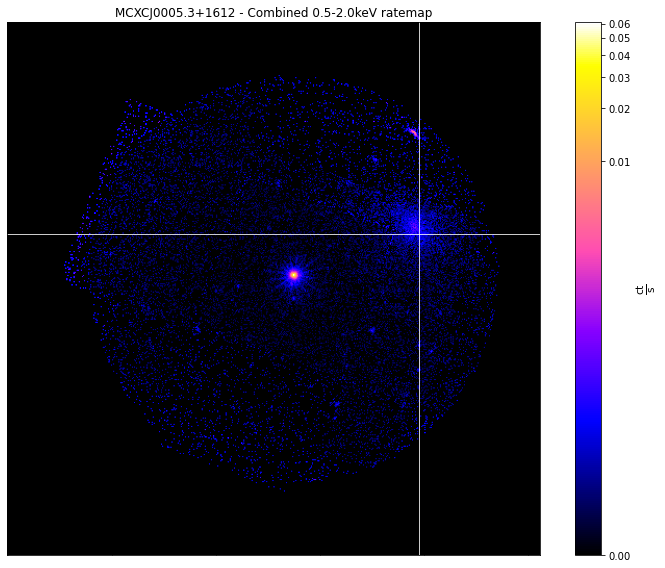


-----------------------------------------------------
Source Name - MCXCJ0005.3+1612
User Coordinates - (1.344166667, 16.21055556) degrees
X-ray Peak - (1.344166667, 16.21055556) degrees
nH - 0.0366 1e+22 / cm2
Redshift - 0.116
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 0
With regions - 1
Total regions - 15
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 921.8 kpc
R500 SNR - 74.01
-----------------------------------------------------



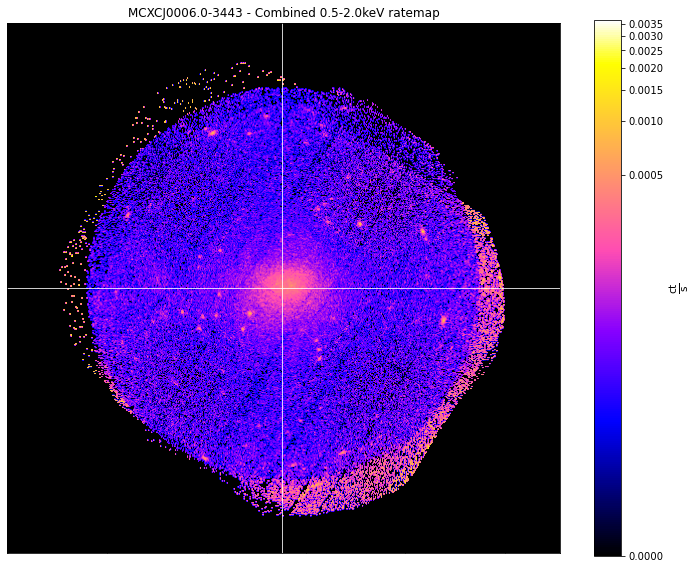


-----------------------------------------------------
Source Name - MCXCJ0006.0-3443
User Coordinates - (1.5125, -34.72416667) degrees
X-ray Peak - (1.5125, -34.72416667) degrees
nH - 0.0146 1e+22 / cm2
Redshift - 0.115
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 3
With regions - 3
Total regions - 89
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 948.6 kpc
R500 SNR - 185.8
-----------------------------------------------------



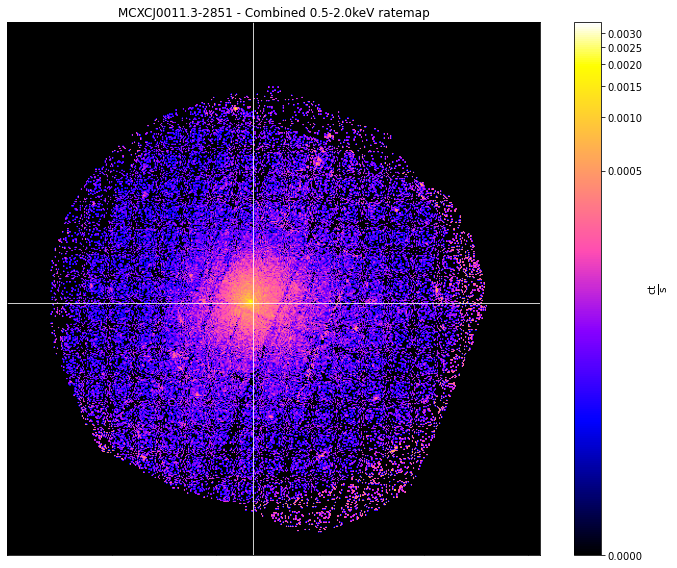


-----------------------------------------------------
Source Name - MCXCJ0011.3-2851
User Coordinates - (2.83625, -28.855) degrees
X-ray Peak - (2.83625, -28.855) degrees
nH - 0.0114 1e+22 / cm2
Redshift - 0.062
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 25
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 880.7 kpc
R500 SNR - 225.67
-----------------------------------------------------



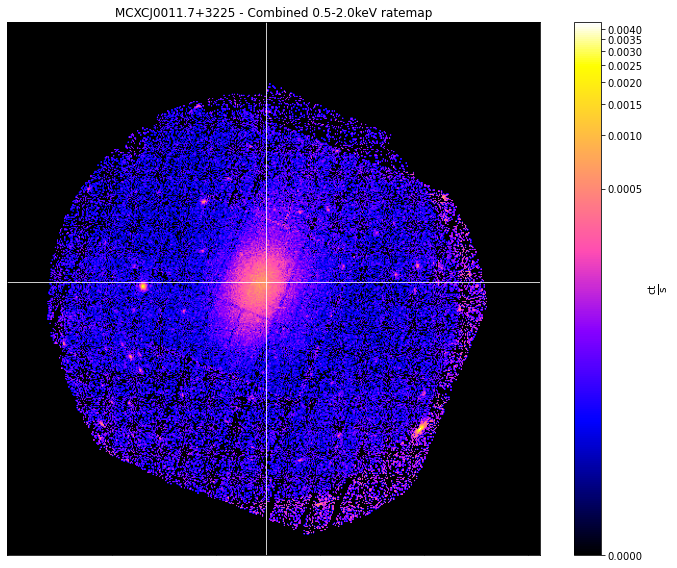


-----------------------------------------------------
Source Name - MCXCJ0011.7+3225
User Coordinates - (2.935, 32.41694444) degrees
X-ray Peak - (2.935, 32.41694444) degrees
nH - 0.044 1e+22 / cm2
Redshift - 0.107
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 53
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1023.2000000000002 kpc
R500 SNR - 256.62
-----------------------------------------------------



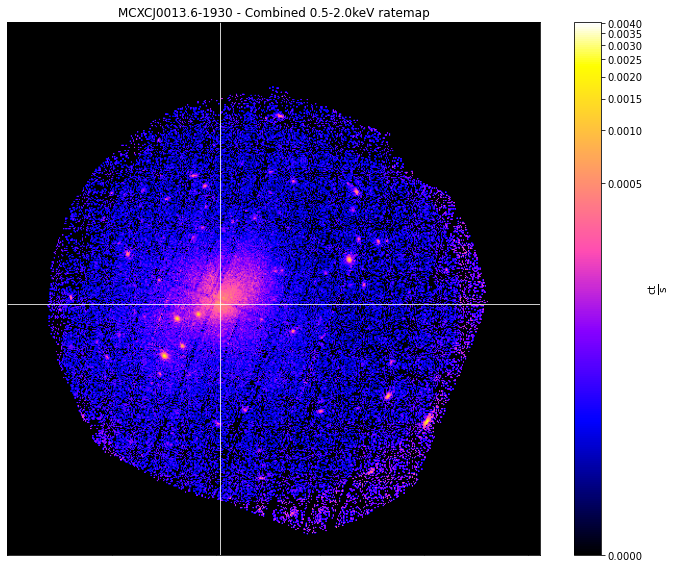


-----------------------------------------------------
Source Name - MCXCJ0013.6-1930
User Coordinates - (3.409583333, -19.50222222) degrees
X-ray Peak - (3.409583333, -19.50222222) degrees
nH - 0.0195 1e+22 / cm2
Redshift - 0.094
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 71
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 888.3 kpc
R500 SNR - 242.69
-----------------------------------------------------



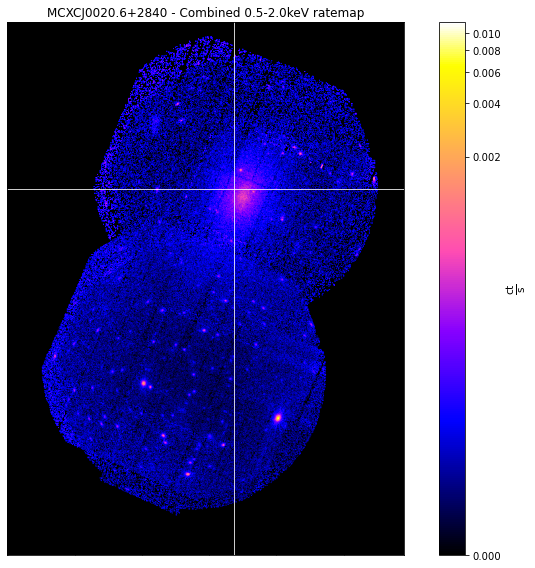


-----------------------------------------------------
Source Name - MCXCJ0020.6+2840
User Coordinates - (5.170416667, 28.675) degrees
X-ray Peak - (5.170416667, 28.675) degrees
nH - 0.0384 1e+22 / cm2
Redshift - 0.094
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 1
With regions - 3
Total regions - 207
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 915.6 kpc
R500 SNR - 223.49
-----------------------------------------------------



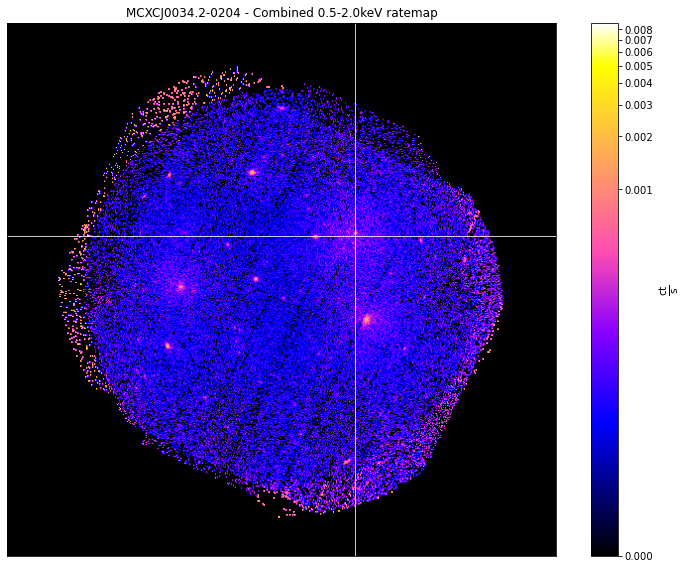


-----------------------------------------------------
Source Name - MCXCJ0034.2-0204
User Coordinates - (8.557916667, -2.075277778) degrees
X-ray Peak - (8.557916667, -2.075277778) degrees
nH - 0.0284 1e+22 / cm2
Redshift - 0.082
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 0
With regions - 4
Total regions - 35
Obs with 1 detection - 0
Obs with >1 matches - 1
Images associated - 21
Exposure maps associated - 21
Combined Ratemaps associated - 1
Spectra associated - 12
R500 - 893.3 kpc
R500 SNR - 100.72
-----------------------------------------------------



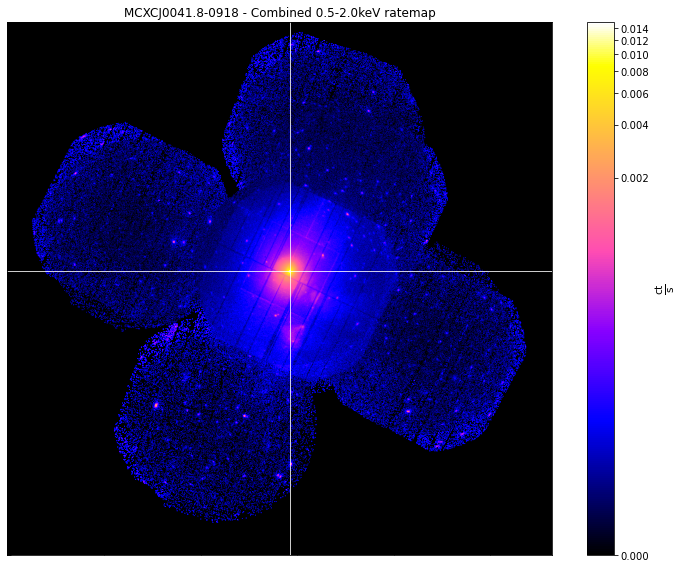


-----------------------------------------------------
Source Name - MCXCJ0041.8-0918
User Coordinates - (10.45875, -9.301944444) degrees
X-ray Peak - (10.45875, -9.301944444) degrees
nH - 0.0274 1e+22 / cm2
Redshift - 0.056
XMM ObsIDs - 8
PN Observations - 8
MOS1 Observations - 8
MOS2 Observations - 8
On-Axis - 2
With regions - 8
Total regions - 442
Obs with 1 detection - 4
Obs with >1 matches - 0
Images associated - 48
Exposure maps associated - 48
Combined Ratemaps associated - 1
Spectra associated - 20
R500 - 1210.3 kpc
R500 SNR - 2256.85
-----------------------------------------------------



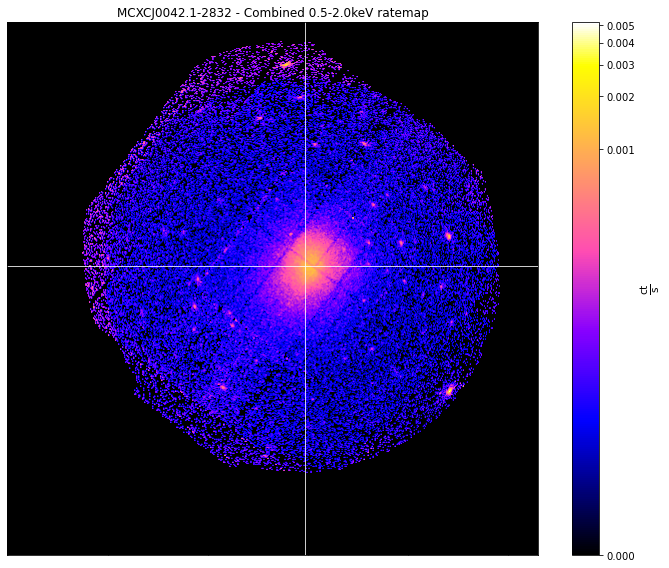


-----------------------------------------------------
Source Name - MCXCJ0042.1-2832
User Coordinates - (10.53625, -28.53583333) degrees
X-ray Peak - (10.53625, -28.53583333) degrees
nH - 0.0155 1e+22 / cm2
Redshift - 0.108
XMM ObsIDs - 2
PN Observations - 1
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 57
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 8
Exposure maps associated - 8
Combined Ratemaps associated - 1
Spectra associated - 5
R500 - 1035.5 kpc
R500 SNR - 300.65
-----------------------------------------------------



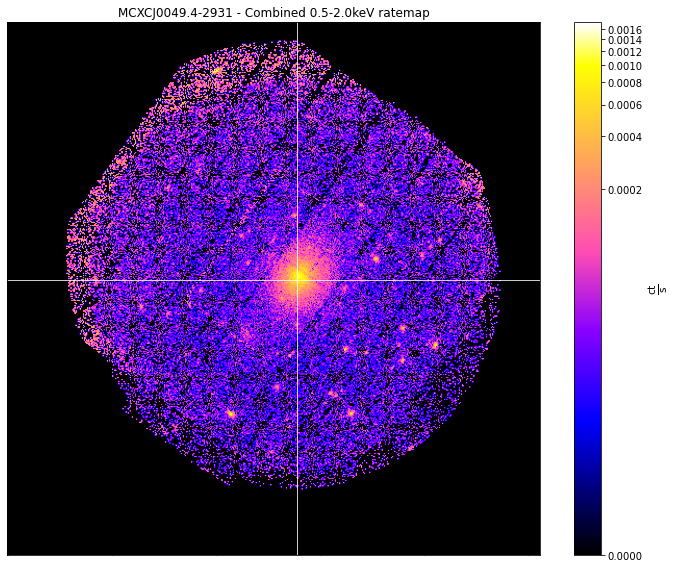


-----------------------------------------------------
Source Name - MCXCJ0049.4-2931
User Coordinates - (12.35, -29.52444444) degrees
X-ray Peak - (12.35, -29.52444444) degrees
nH - 0.0173 1e+22 / cm2
Redshift - 0.108
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 55
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 908.5999999999999 kpc
R500 SNR - 158.09
-----------------------------------------------------



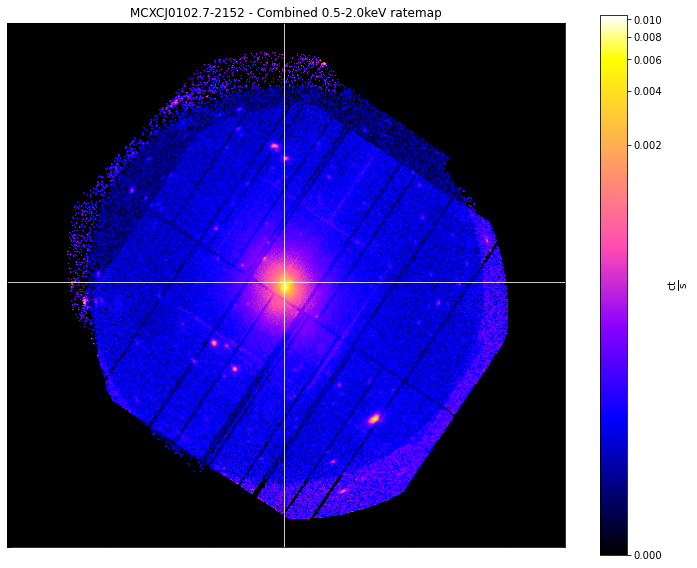


-----------------------------------------------------
Source Name - MCXCJ0102.7-2152
User Coordinates - (15.67541667, -21.87361111) degrees
X-ray Peak - (15.67541667, -21.87361111) degrees
nH - 0.0148 1e+22 / cm2
Redshift - 0.057
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 3
With regions - 3
Total regions - 205
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 937.9 kpc
R500 SNR - 724.76
-----------------------------------------------------



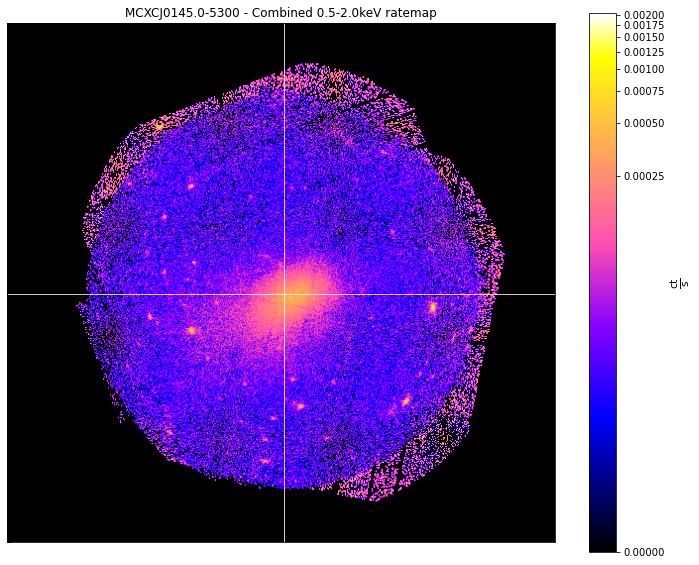


-----------------------------------------------------
Source Name - MCXCJ0145.0-5300
User Coordinates - (26.25958333, -53.01388889) degrees
X-ray Peak - (26.25958333, -53.01388889) degrees
nH - 0.0253 1e+22 / cm2
Redshift - 0.117
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 3
With regions - 3
Total regions - 84
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 968.0 kpc
R500 SNR - 280.94
-----------------------------------------------------



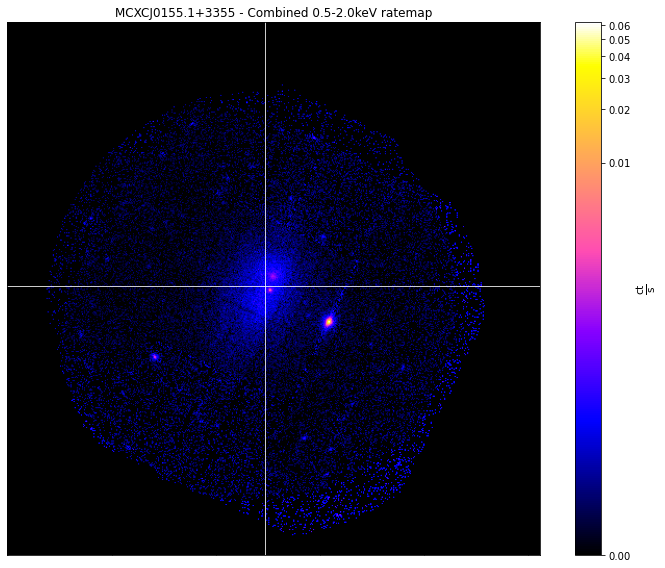


-----------------------------------------------------
Source Name - MCXCJ0155.1+3355
User Coordinates - (28.78958333, 33.92222222) degrees
X-ray Peak - (28.78958333, 33.92222222) degrees
nH - 0.048 1e+22 / cm2
Redshift - 0.087
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 38
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 863.0 kpc
R500 SNR - 188.91
-----------------------------------------------------



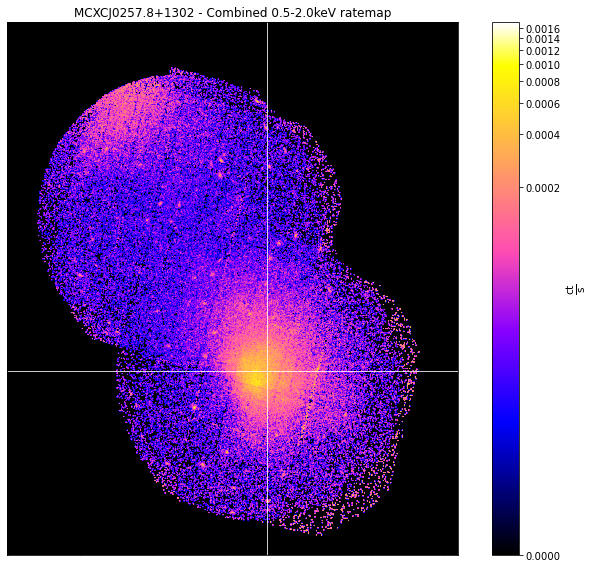


-----------------------------------------------------
Source Name - MCXCJ0257.8+1302
User Coordinates - (44.4575, 13.04916667) degrees
X-ray Peak - (44.4575, 13.04916667) degrees
nH - 0.099 1e+22 / cm2
Redshift - 0.072
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 1
With regions - 2
Total regions - 68
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 1116.9 kpc
R500 SNR - 285.07
-----------------------------------------------------



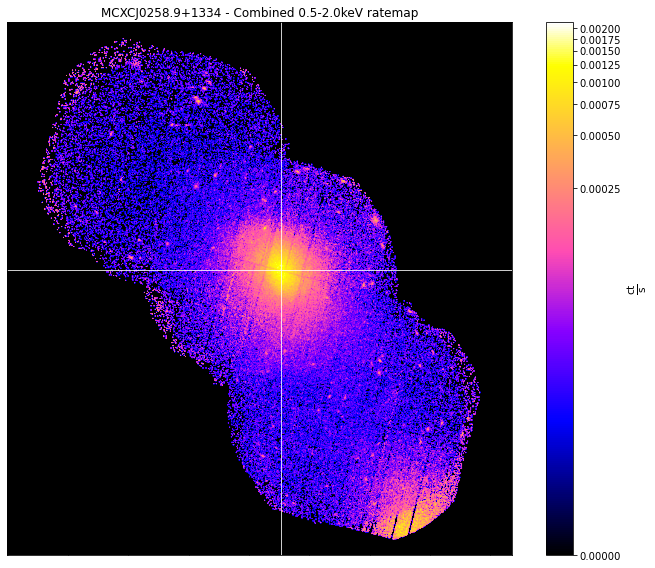


-----------------------------------------------------
Source Name - MCXCJ0258.9+1334
User Coordinates - (44.73958333, 13.57944444) degrees
X-ray Peak - (44.73958333, 13.57944444) degrees
nH - 0.1 1e+22 / cm2
Redshift - 0.074
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 1
With regions - 3
Total regions - 90
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 5
R500 - 1242.1 kpc
R500 SNR - 411.2
-----------------------------------------------------



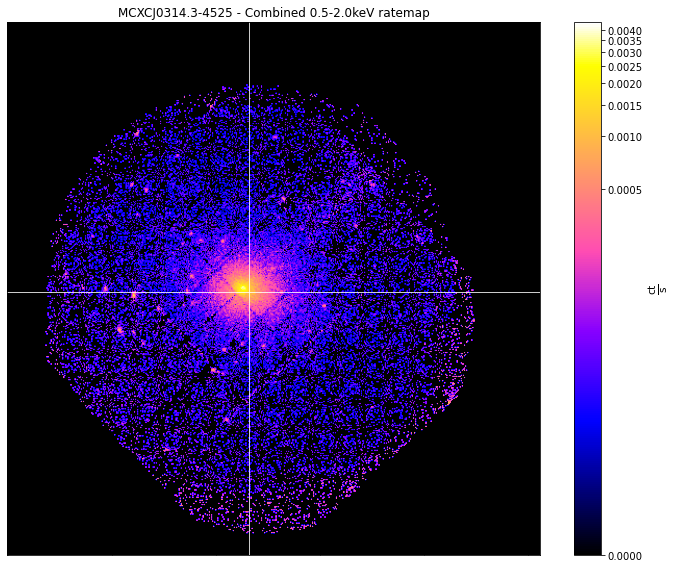


-----------------------------------------------------
Source Name - MCXCJ0314.3-4525
User Coordinates - (48.5825, -45.42416667) degrees
X-ray Peak - (48.5825, -45.42416667) degrees
nH - 0.0201 1e+22 / cm2
Redshift - 0.072
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 44
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 866.1999999999999 kpc
R500 SNR - 229.19
-----------------------------------------------------



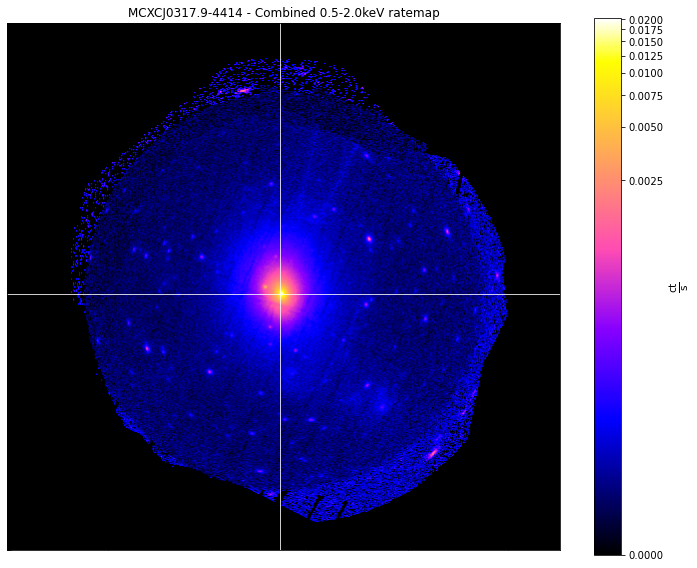


-----------------------------------------------------
Source Name - MCXCJ0317.9-4414
User Coordinates - (49.49375, -44.23888889) degrees
X-ray Peak - (49.49375, -44.23888889) degrees
nH - 0.0112 1e+22 / cm2
Redshift - 0.075
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 3
With regions - 3
Total regions - 277
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 1128.8 kpc
R500 SNR - 1302.76
-----------------------------------------------------



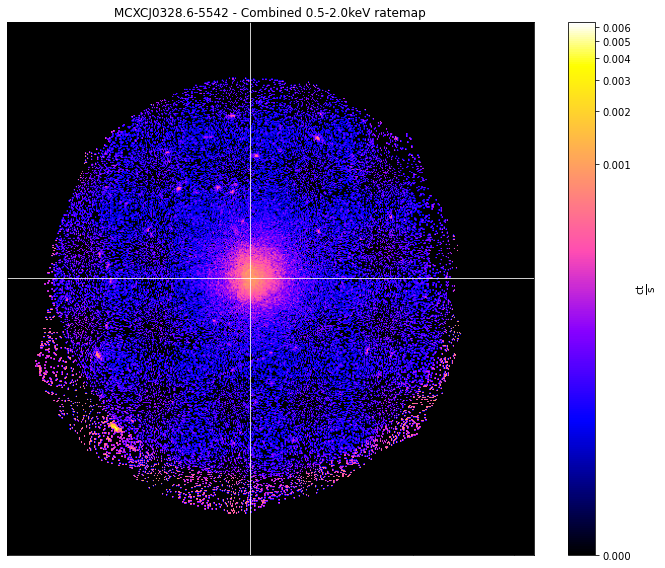


-----------------------------------------------------
Source Name - MCXCJ0328.6-5542
User Coordinates - (52.15625, -55.71277778) degrees
X-ray Peak - (52.15625, -55.71277778) degrees
nH - 0.0138 1e+22 / cm2
Redshift - 0.085
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 44
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 924.3 kpc
R500 SNR - 210.75
-----------------------------------------------------



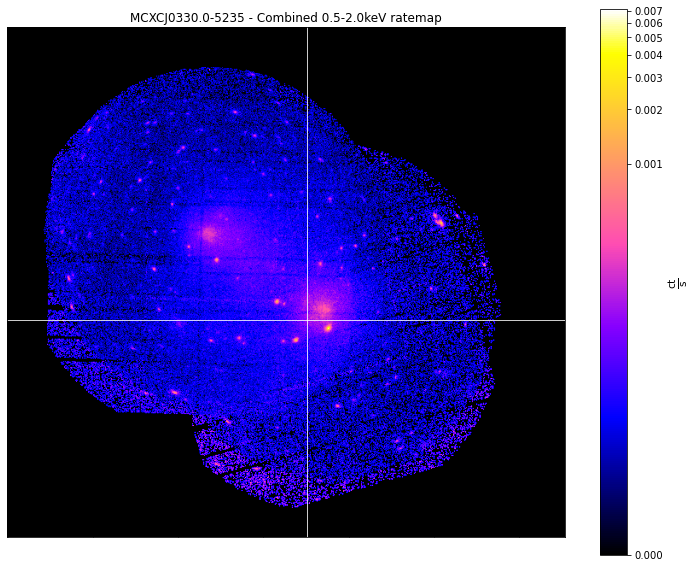


-----------------------------------------------------
Source Name - MCXCJ0330.0-5235
User Coordinates - (52.50291667, -52.59611111) degrees
X-ray Peak - (52.50291667, -52.59611111) degrees
nH - 0.0128 1e+22 / cm2
Redshift - 0.062
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 0
With regions - 2
Total regions - 174
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 883.1 kpc
R500 SNR - 319.82
-----------------------------------------------------



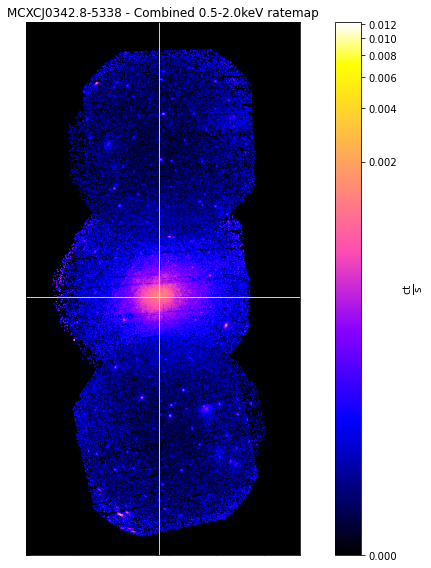


-----------------------------------------------------
Source Name - MCXCJ0342.8-5338
User Coordinates - (55.72458333, -53.63527778) degrees
X-ray Peak - (55.72458333, -53.63527778) degrees
nH - 0.0118 1e+22 / cm2
Redshift - 0.059
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 2
With regions - 4
Total regions - 171
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 8
R500 - 1066.7 kpc
R500 SNR - 442.74
-----------------------------------------------------



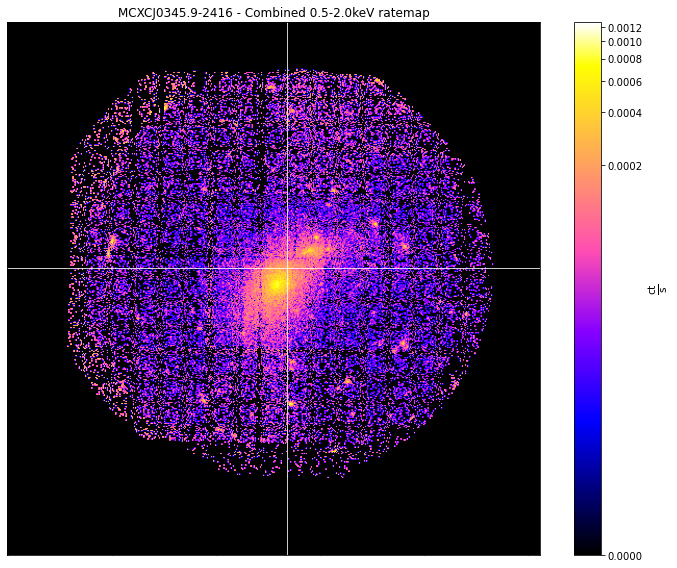


-----------------------------------------------------
Source Name - MCXCJ0345.9-2416
User Coordinates - (56.48333333, -24.28027778) degrees
X-ray Peak - (56.48333333, -24.28027778) degrees
nH - 0.011 1e+22 / cm2
Redshift - 0.106
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 48
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 913.1 kpc
R500 SNR - 170.89
-----------------------------------------------------



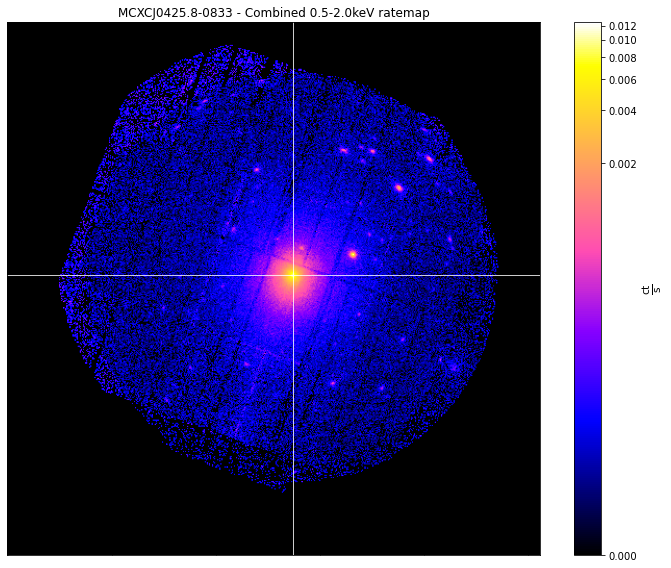


-----------------------------------------------------
Source Name - MCXCJ0425.8-0833
User Coordinates - (66.46416667, -8.559166667) degrees
X-ray Peak - (66.46416667, -8.559166667) degrees
nH - 0.0836 1e+22 / cm2
Redshift - 0.04
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 70
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 890.5 kpc


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:2962: RuntimeWarning: invalid value encountered in double_scalars
  av_back = (self.data * back_mask).sum() / back_area


R500 SNR - nan
-----------------------------------------------------



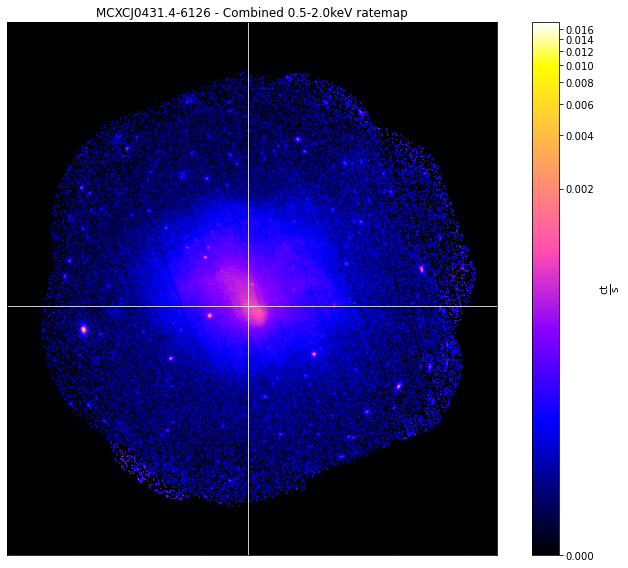


-----------------------------------------------------
Source Name - MCXCJ0431.4-6126
User Coordinates - (67.85041667, -61.44388889) degrees
X-ray Peak - (67.85041667, -61.44388889) degrees
nH - 0.0213 1e+22 / cm2
Redshift - 0.059
XMM ObsIDs - 10
PN Observations - 9
MOS1 Observations - 10
MOS2 Observations - 10
On-Axis - 0
With regions - 10
Total regions - 310
Obs with 1 detection - 9
Obs with >1 matches - 0
Images associated - 56
Exposure maps associated - 56
Combined Ratemaps associated - 1
Spectra associated - 29
R500 - 1148.5 kpc
R500 SNR - 934.68
-----------------------------------------------------



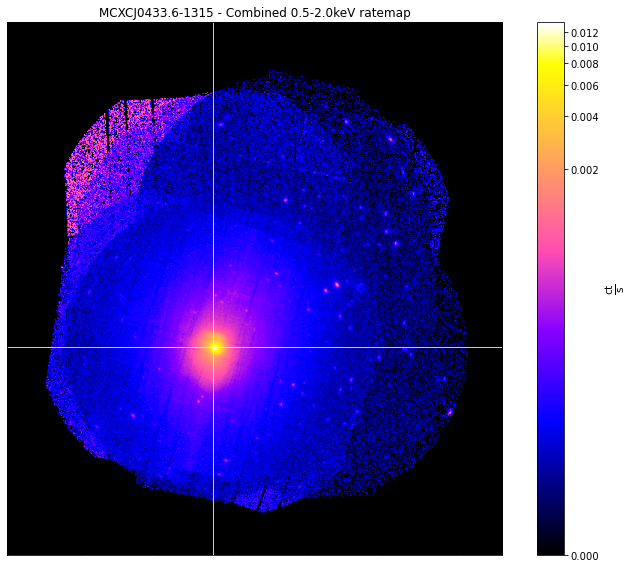


-----------------------------------------------------
Source Name - MCXCJ0433.6-1315
User Coordinates - (68.41, -13.25916667) degrees
X-ray Peak - (68.41, -13.25916667) degrees
nH - 0.0431 1e+22 / cm2
Redshift - 0.033
XMM ObsIDs - 8
PN Observations - 7
MOS1 Observations - 8
MOS2 Observations - 7
On-Axis - 4
With regions - 8
Total regions - 314
Obs with 1 detection - 7
Obs with >1 matches - 0
Images associated - 43
Exposure maps associated - 43
Combined Ratemaps associated - 1
Spectra associated - 22
R500 - 997.4 kpc
R500 SNR - 817.13
-----------------------------------------------------



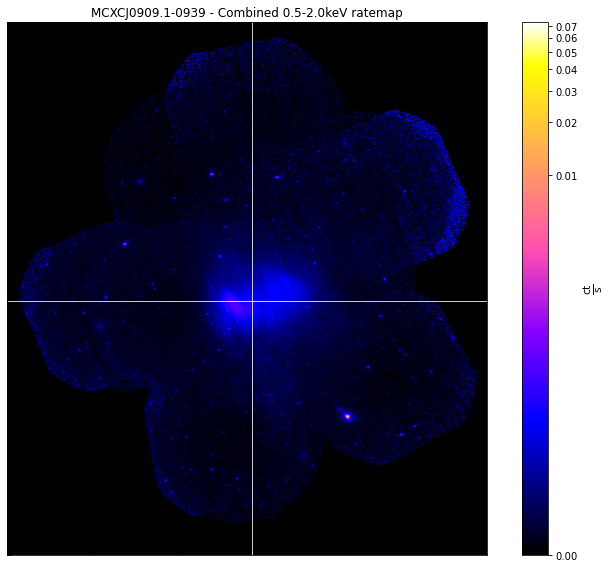


-----------------------------------------------------
Source Name - MCXCJ0909.1-0939
User Coordinates - (137.285, -9.666111111) degrees
X-ray Peak - (137.285, -9.666111111) degrees
nH - 0.0499 1e+22 / cm2
Redshift - 0.054
XMM ObsIDs - 14
PN Observations - 14
MOS1 Observations - 14
MOS2 Observations - 14
On-Axis - 0
With regions - 14
Total regions - 557
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 78
Exposure maps associated - 78
Combined Ratemaps associated - 1
Spectra associated - 39
R500 - 1143.8999999999999 kpc
R500 SNR - 1083.06
-----------------------------------------------------



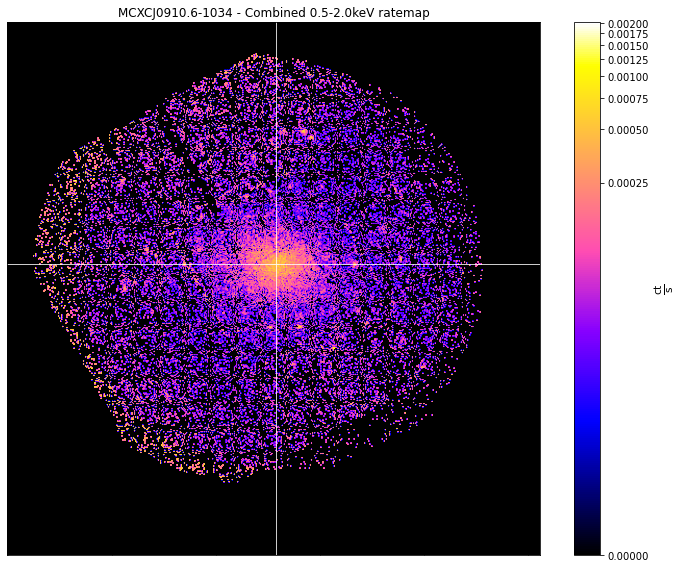


-----------------------------------------------------
Source Name - MCXCJ0910.6-1034
User Coordinates - (137.65125, -10.58111111) degrees
X-ray Peak - (137.65125, -10.58111111) degrees
nH - 0.0467 1e+22 / cm2
Redshift - 0.092
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 27
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 862.7 kpc
R500 SNR - 126.85
-----------------------------------------------------



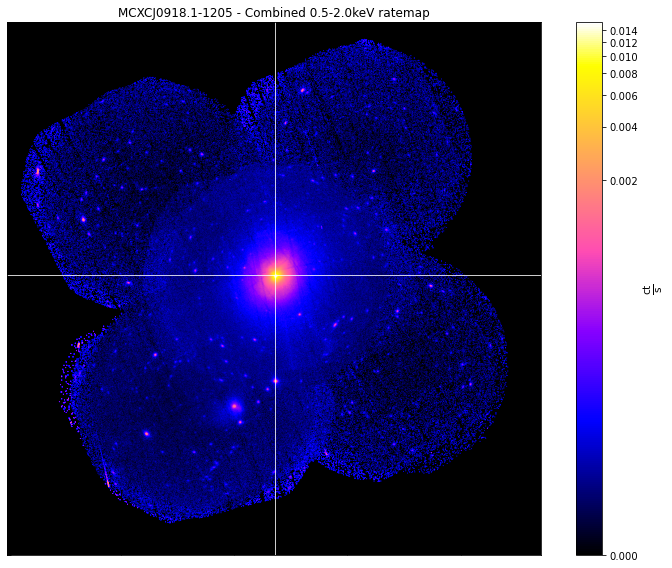


-----------------------------------------------------
Source Name - MCXCJ0918.1-1205
User Coordinates - (139.5270833, -12.09333333) degrees
X-ray Peak - (139.5270833, -12.09333333) degrees
nH - 0.0408 1e+22 / cm2
Redshift - 0.054
XMM ObsIDs - 11
PN Observations - 10
MOS1 Observations - 11
MOS2 Observations - 11
On-Axis - 4
With regions - 11
Total regions - 580
Obs with 1 detection - 4
Obs with >1 matches - 0
Images associated - 61
Exposure maps associated - 61
Combined Ratemaps associated - 1
Spectra associated - 26
R500 - 1065.8000000000002 kpc
R500 SNR - 1921.79
-----------------------------------------------------



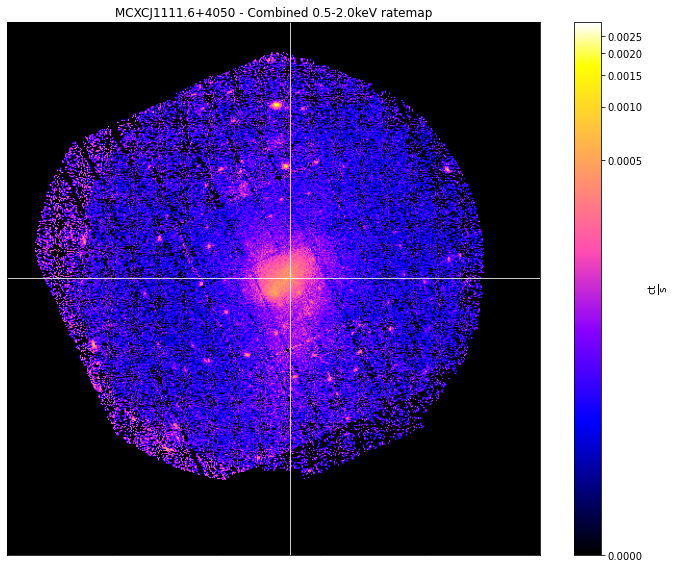


-----------------------------------------------------
Source Name - MCXCJ1111.6+4050
User Coordinates - (167.9104167, 40.8425) degrees
X-ray Peak - (167.9104167, 40.8425) degrees
nH - 0.0138 1e+22 / cm2
Redshift - 0.079
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 70
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 868.7 kpc
R500 SNR - 238.9
-----------------------------------------------------



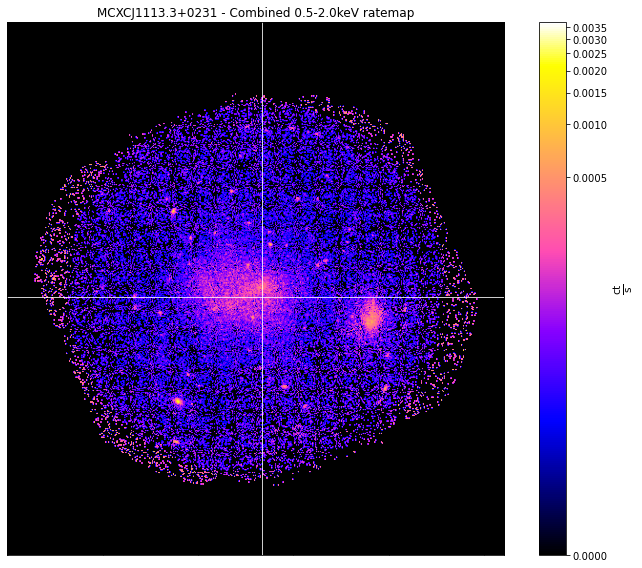


-----------------------------------------------------
Source Name - MCXCJ1113.3+0231
User Coordinates - (168.33625, 2.532222222) degrees
X-ray Peak - (168.33625, 2.532222222) degrees
nH - 0.0367 1e+22 / cm2
Redshift - 0.078
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 56
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 873.6 kpc
R500 SNR - 151.72
-----------------------------------------------------



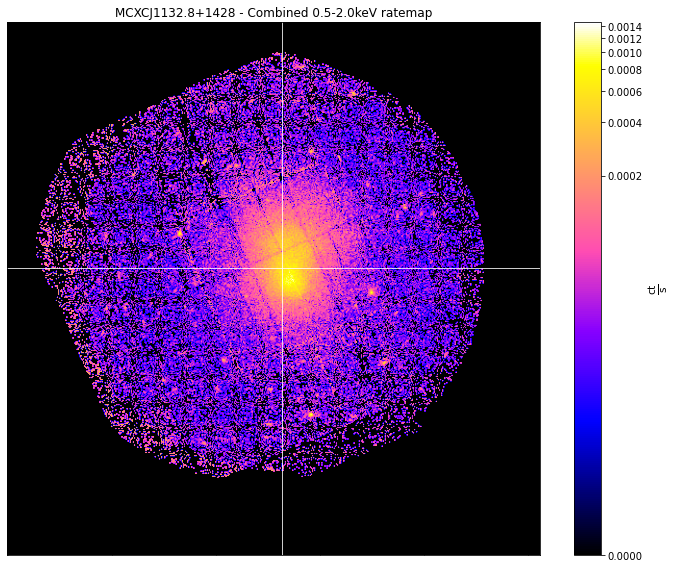


-----------------------------------------------------
Source Name - MCXCJ1132.8+1428
User Coordinates - (173.2208333, 14.46888889) degrees
X-ray Peak - (173.2208333, 14.46888889) degrees
nH - 0.0306 1e+22 / cm2
Redshift - 0.083
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 49
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 992.7 kpc
R500 SNR - 320.15
-----------------------------------------------------



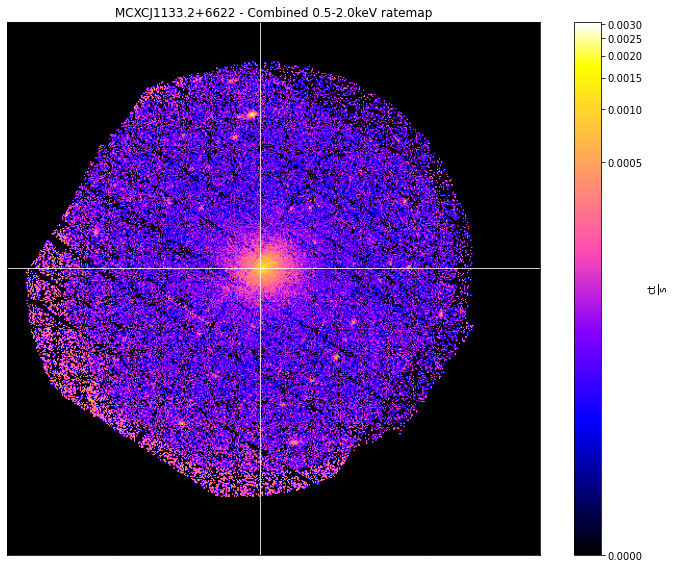


-----------------------------------------------------
Source Name - MCXCJ1133.2+6622
User Coordinates - (173.3195833, 66.37861111) degrees
X-ray Peak - (173.3195833, 66.37861111) degrees
nH - 0.0106 1e+22 / cm2
Redshift - 0.116
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 32
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 911.1 kpc
R500 SNR - 151.25
-----------------------------------------------------



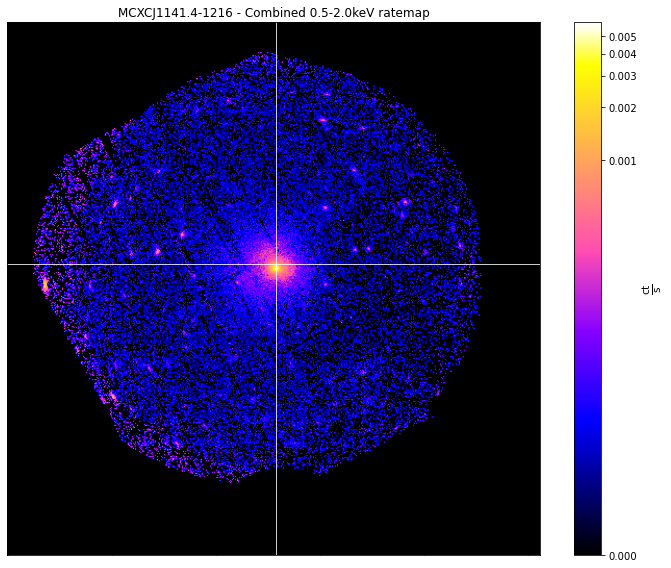


-----------------------------------------------------
Source Name - MCXCJ1141.4-1216
User Coordinates - (175.35125, -12.27222222) degrees
X-ray Peak - (175.35125, -12.27222222) degrees
nH - 0.025 1e+22 / cm2
Redshift - 0.12
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 61
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 954.8 kpc
R500 SNR - 198.03
-----------------------------------------------------



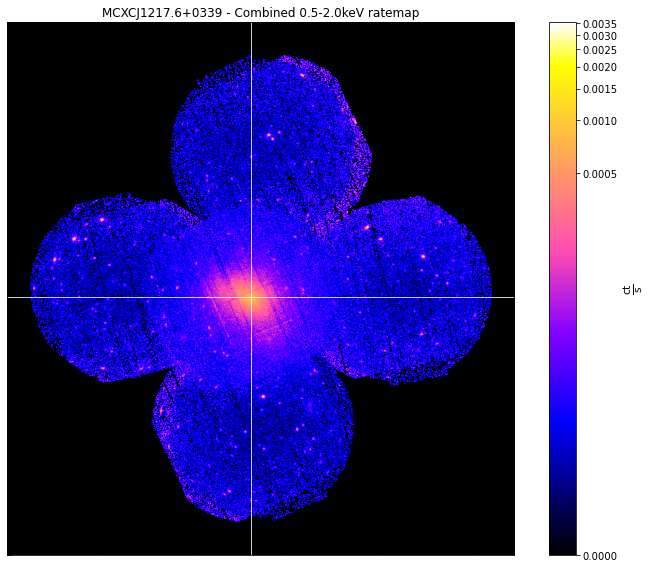


-----------------------------------------------------
Source Name - MCXCJ1217.6+0339
User Coordinates - (184.4191667, 3.6625) degrees
X-ray Peak - (184.4191667, 3.6625) degrees
nH - 0.0167 1e+22 / cm2
Redshift - 0.077
XMM ObsIDs - 5
PN Observations - 5
MOS1 Observations - 5
MOS2 Observations - 5
On-Axis - 1
With regions - 5
Total regions - 252
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 30
Exposure maps associated - 30
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 1054.8 kpc
R500 SNR - 410.29
-----------------------------------------------------



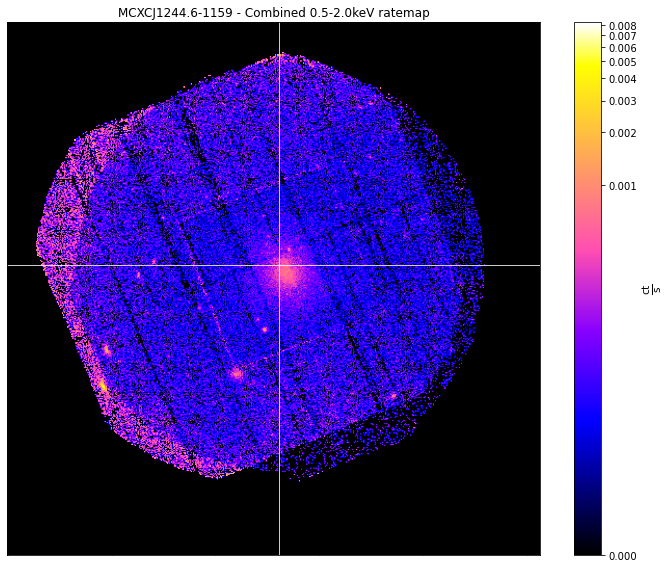


-----------------------------------------------------
Source Name - MCXCJ1244.6-1159
User Coordinates - (191.1583333, -11.98527778) degrees
X-ray Peak - (191.1583333, -11.98527778) degrees
nH - 0.0345 1e+22 / cm2
Redshift - 0.096
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 3
With regions - 3
Total regions - 40
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 906.5999999999999 kpc
R500 SNR - 117.41
-----------------------------------------------------



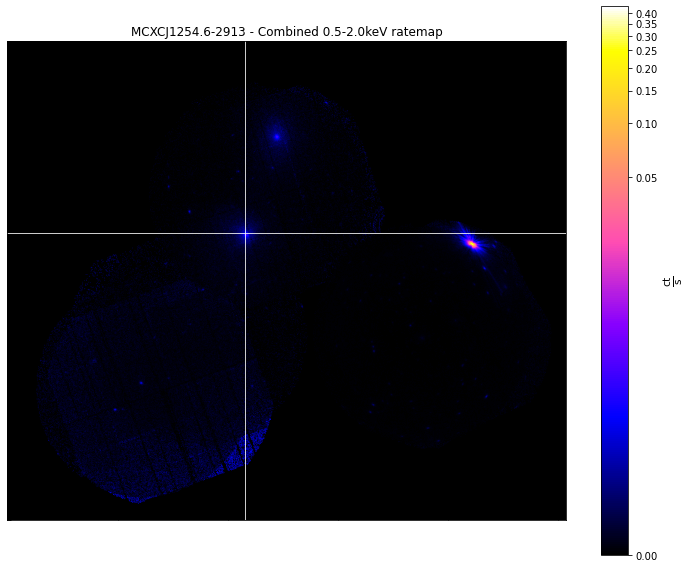


-----------------------------------------------------
Source Name - MCXCJ1254.6-2913
User Coordinates - (193.6725, -29.22333333) degrees
X-ray Peak - (193.6725, -29.22333333) degrees
nH - 0.0605 1e+22 / cm2
Redshift - 0.054
XMM ObsIDs - 5
PN Observations - 5
MOS1 Observations - 5
MOS2 Observations - 5
On-Axis - 0
With regions - 5
Total regions - 288
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 30
Exposure maps associated - 30
Combined Ratemaps associated - 1
Spectra associated - 11
R500 - 885.5 kpc
R500 SNR - 242.43
-----------------------------------------------------



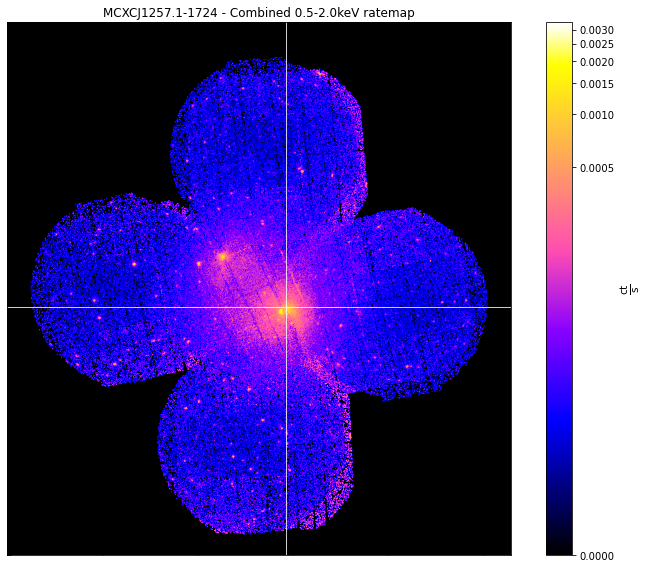


-----------------------------------------------------
Source Name - MCXCJ1257.1-1724
User Coordinates - (194.2904167, -17.40027778) degrees
X-ray Peak - (194.2904167, -17.40027778) degrees
nH - 0.0419 1e+22 / cm2
Redshift - 0.047
XMM ObsIDs - 5
PN Observations - 5
MOS1 Observations - 5
MOS2 Observations - 5
On-Axis - 0
With regions - 5
Total regions - 259
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 30
Exposure maps associated - 30
Combined Ratemaps associated - 1
Spectra associated - 11
R500 - 994.4 kpc
R500 SNR - 366.31
-----------------------------------------------------



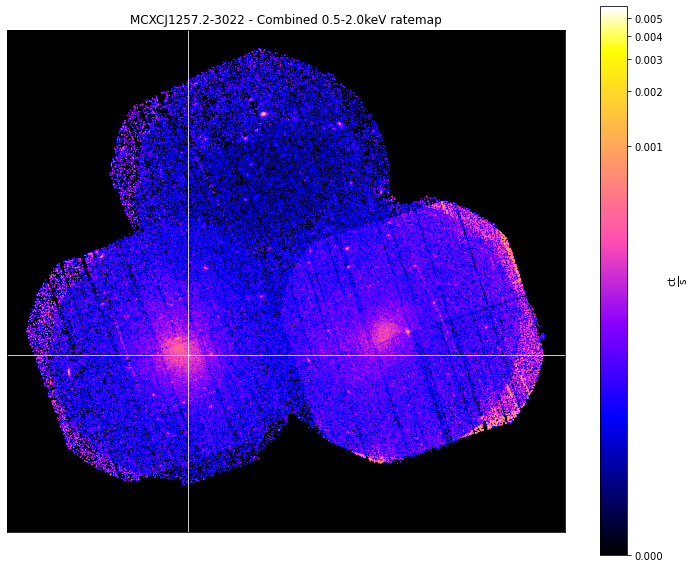


-----------------------------------------------------
Source Name - MCXCJ1257.2-3022
User Coordinates - (194.3204167, -30.37694444) degrees
X-ray Peak - (194.3204167, -30.37694444) degrees
nH - 0.0624 1e+22 / cm2
Redshift - 0.055
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 1
With regions - 4
Total regions - 86
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 920.1 kpc
R500 SNR - 188.49
-----------------------------------------------------



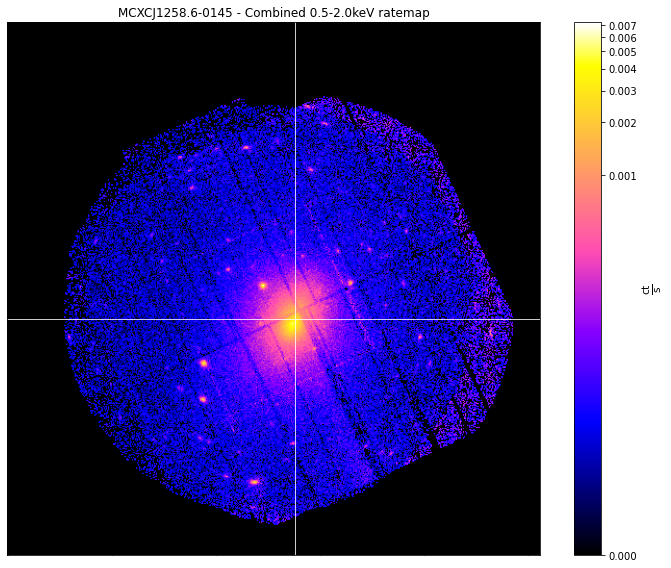


-----------------------------------------------------
Source Name - MCXCJ1258.6-0145
User Coordinates - (194.67125, -1.756944444) degrees
X-ray Peak - (194.67125, -1.756944444) degrees
nH - 0.0128 1e+22 / cm2
Redshift - 0.084
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 76
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1101.5 kpc
R500 SNR - 529.64
-----------------------------------------------------



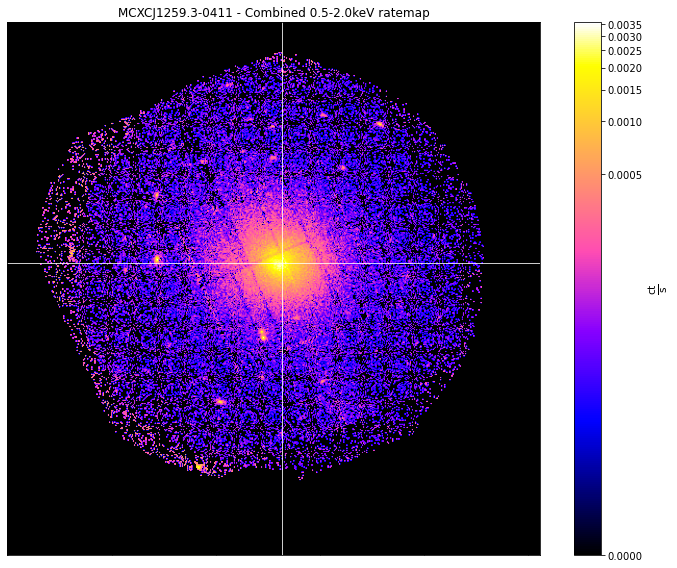


-----------------------------------------------------
Source Name - MCXCJ1259.3-0411
User Coordinates - (194.8395833, -4.194722222) degrees
X-ray Peak - (194.8395833, -4.194722222) degrees
nH - 0.0153 1e+22 / cm2
Redshift - 0.084
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 33
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1125.2 kpc
R500 SNR - 317.93
-----------------------------------------------------



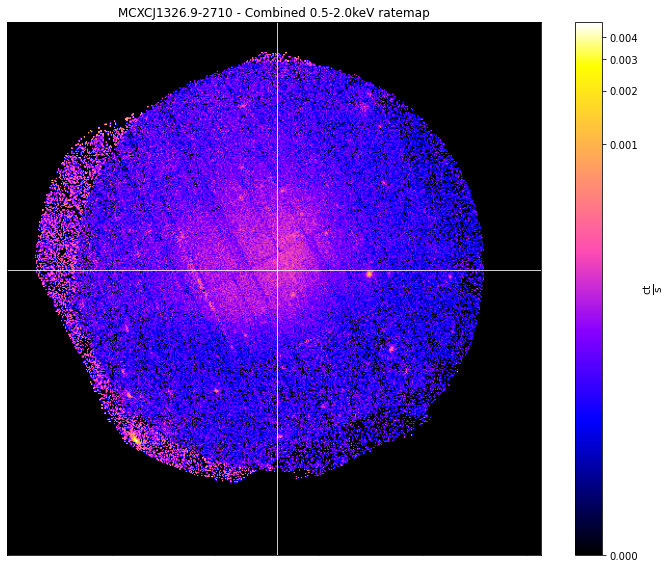


-----------------------------------------------------
Source Name - MCXCJ1326.9-2710
User Coordinates - (201.725, -27.18333333) degrees
X-ray Peak - (201.725, -27.18333333) degrees
nH - 0.0402 1e+22 / cm2
Redshift - 0.046
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 3
With regions - 3
Total regions - 50
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 969.4000000000001 kpc
R500 SNR - nan
-----------------------------------------------------



/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:2962: RuntimeWarning: invalid value encountered in double_scalars
  av_back = (self.data * back_mask).sum() / back_area


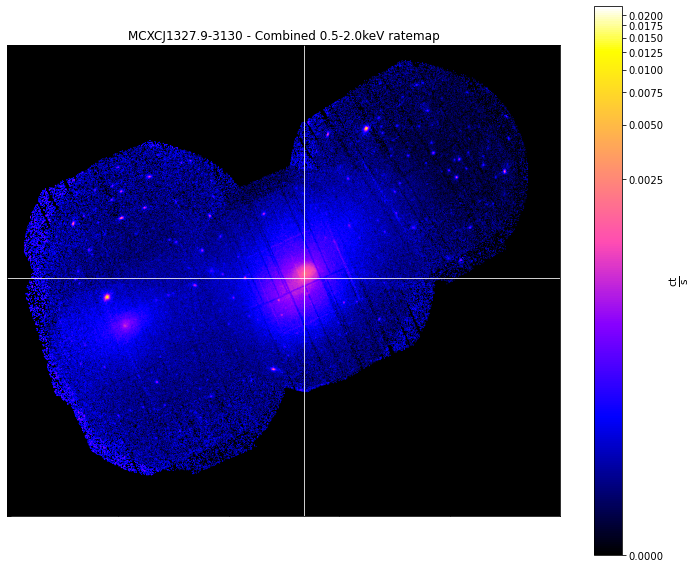


-----------------------------------------------------
Source Name - MCXCJ1327.9-3130
User Coordinates - (201.9895833, -31.5025) degrees
X-ray Peak - (201.9895833, -31.5025) degrees
nH - 0.0367 1e+22 / cm2
Redshift - 0.048
XMM ObsIDs - 5
PN Observations - 5
MOS1 Observations - 5
MOS2 Observations - 5
On-Axis - 1
With regions - 5
Total regions - 213
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 30
Exposure maps associated - 30
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 1101.0 kpc
R500 SNR - 703.23
-----------------------------------------------------



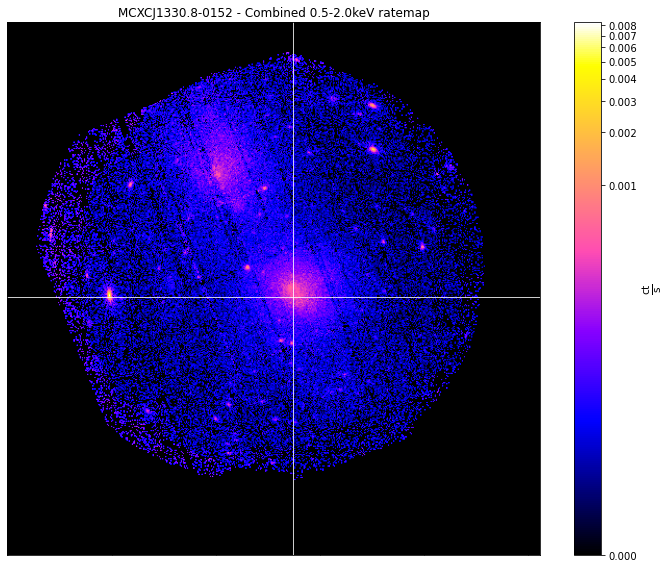


-----------------------------------------------------
Source Name - MCXCJ1330.8-0152
User Coordinates - (202.7079167, -1.872777778) degrees
X-ray Peak - (202.7079167, -1.872777778) degrees
nH - 0.0267 1e+22 / cm2
Redshift - 0.085
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 69
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 996.8000000000001 kpc
R500 SNR - 212.87
-----------------------------------------------------



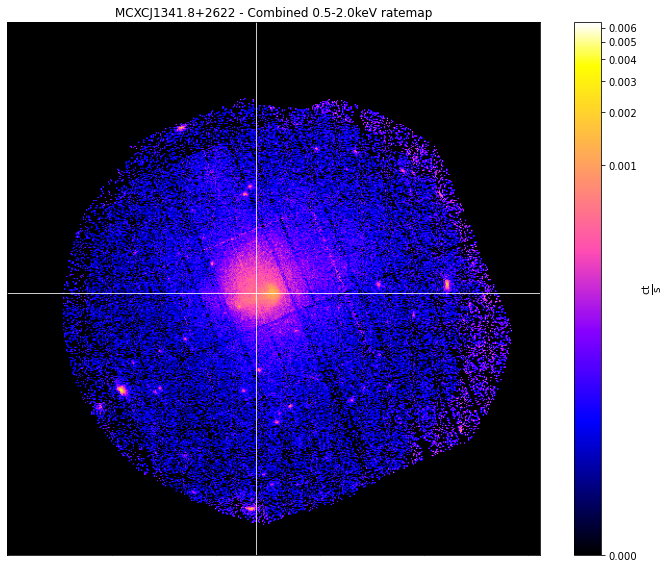


-----------------------------------------------------
Source Name - MCXCJ1341.8+2622
User Coordinates - (205.4741667, 26.37194444) degrees
X-ray Peak - (205.4741667, 26.37194444) degrees
nH - 0.00958 1e+22 / cm2
Redshift - 0.072
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 49
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 933.3000000000001 kpc
R500 SNR - 307.63
-----------------------------------------------------



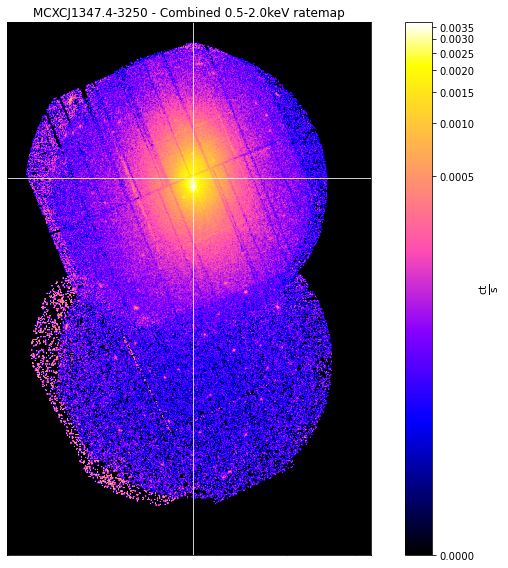


-----------------------------------------------------
Source Name - MCXCJ1347.4-3250
User Coordinates - (206.8683333, -32.84972222) degrees
X-ray Peak - (206.8683333, -32.84972222) degrees
nH - 0.0389 1e+22 / cm2
Redshift - 0.039
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 1
With regions - 2
Total regions - 63
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 1151.4 kpc
R500 SNR - 879.26
-----------------------------------------------------



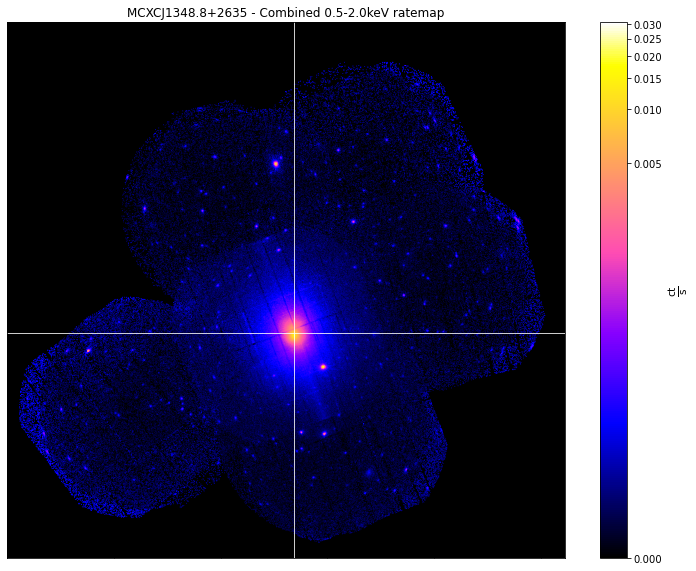


-----------------------------------------------------
Source Name - MCXCJ1348.8+2635
User Coordinates - (207.2208333, 26.59555556) degrees
X-ray Peak - (207.2208333, 26.59555556) degrees
nH - 0.01 1e+22 / cm2
Redshift - 0.062
XMM ObsIDs - 6
PN Observations - 6
MOS1 Observations - 6
MOS2 Observations - 6
On-Axis - 1
With regions - 6
Total regions - 407
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 36
Exposure maps associated - 36
Combined Ratemaps associated - 1
Spectra associated - 15
R500 - 1223.6 kpc
R500 SNR - 1224.04
-----------------------------------------------------



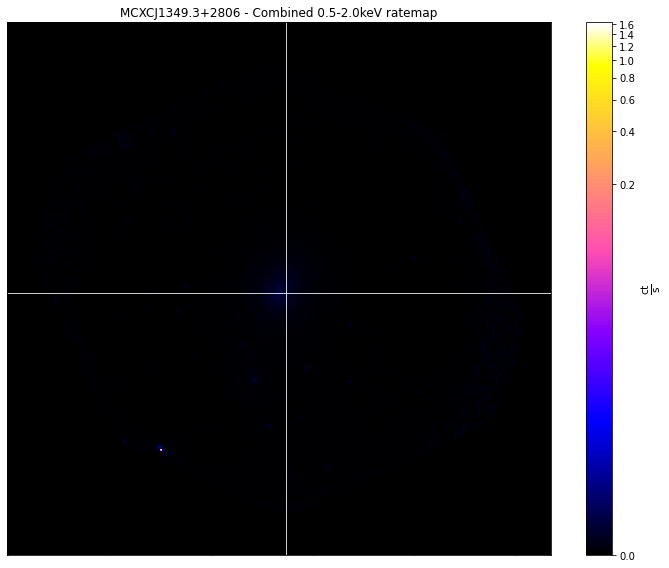


-----------------------------------------------------
Source Name - MCXCJ1349.3+2806
User Coordinates - (207.34, 28.10361111) degrees
X-ray Peak - (207.34, 28.10361111) degrees
nH - 0.0104 1e+22 / cm2
Redshift - 0.075
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 85
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 903.3 kpc
R500 SNR - 205.84
-----------------------------------------------------



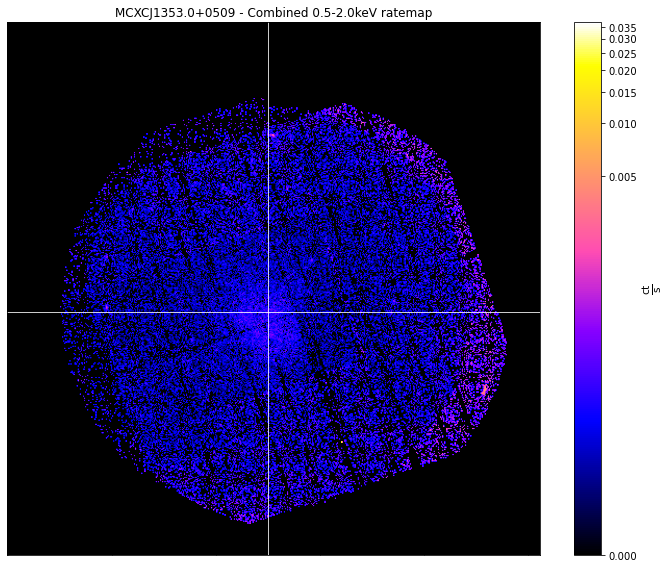


-----------------------------------------------------
Source Name - MCXCJ1353.0+0509
User Coordinates - (208.2541667, 5.155) degrees
X-ray Peak - (208.2541667, 5.155) degrees
nH - 0.0192 1e+22 / cm2
Redshift - 0.079
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 6
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 865.7 kpc
R500 SNR - 99.38
-----------------------------------------------------



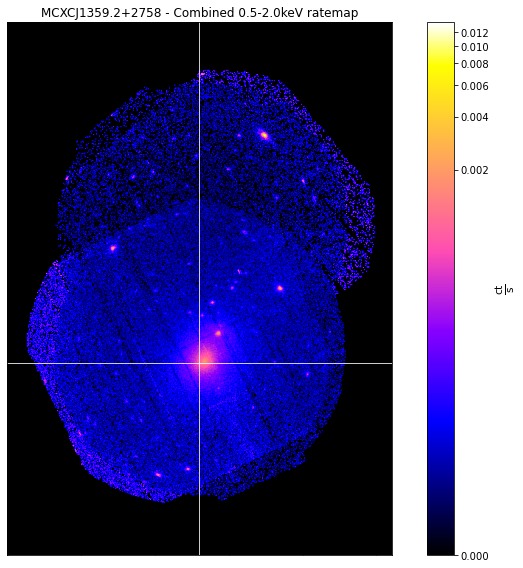


-----------------------------------------------------
Source Name - MCXCJ1359.2+2758
User Coordinates - (209.8229167, 27.97277778) degrees
X-ray Peak - (209.8229167, 27.97277778) degrees
nH - 0.0126 1e+22 / cm2
Redshift - 0.061
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 2
With regions - 3
Total regions - 116
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 869.3 kpc
R500 SNR - 316.89
-----------------------------------------------------



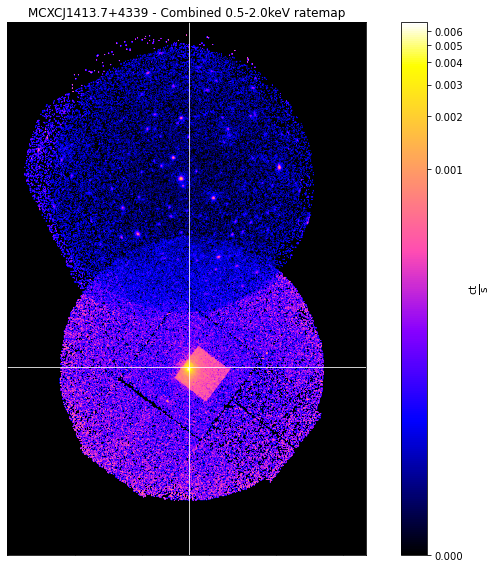


-----------------------------------------------------
Source Name - MCXCJ1413.7+4339
User Coordinates - (213.43125, 43.66333333) degrees
X-ray Peak - (213.43125, 43.66333333) degrees
nH - 0.0078 1e+22 / cm2
Redshift - 0.089
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 1
With regions - 2
Total regions - 102
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 5
R500 - 857.3 kpc
R500 SNR - 181.77
-----------------------------------------------------



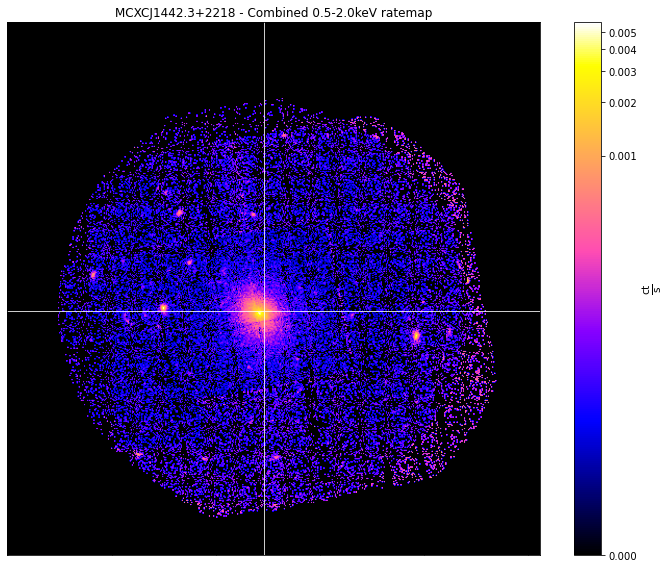


-----------------------------------------------------
Source Name - MCXCJ1442.3+2218
User Coordinates - (220.5766667, 22.30472222) degrees
X-ray Peak - (220.5766667, 22.30472222) degrees
nH - 0.0233 1e+22 / cm2
Redshift - 0.09
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 32
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 908.3 kpc
R500 SNR - 175.7
-----------------------------------------------------



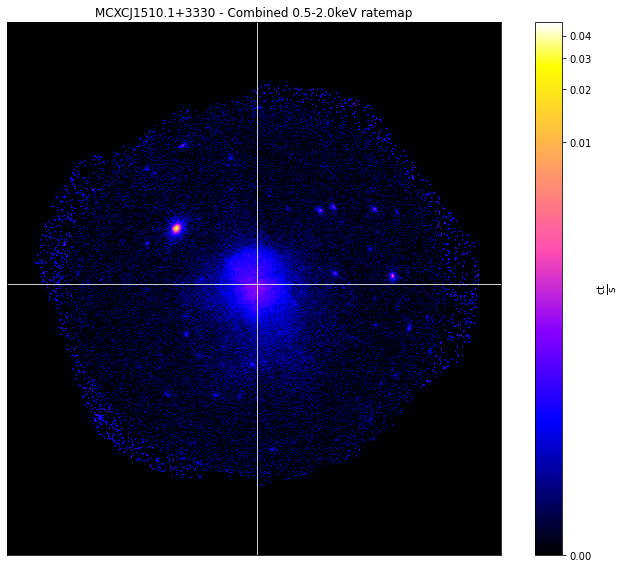


-----------------------------------------------------
Source Name - MCXCJ1510.1+3330
User Coordinates - (227.54875, 33.51472222) degrees
X-ray Peak - (227.54875, 33.51472222) degrees
nH - 0.0149 1e+22 / cm2
Redshift - 0.113
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 66
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 1086.6 kpc
R500 SNR - 307.84
-----------------------------------------------------



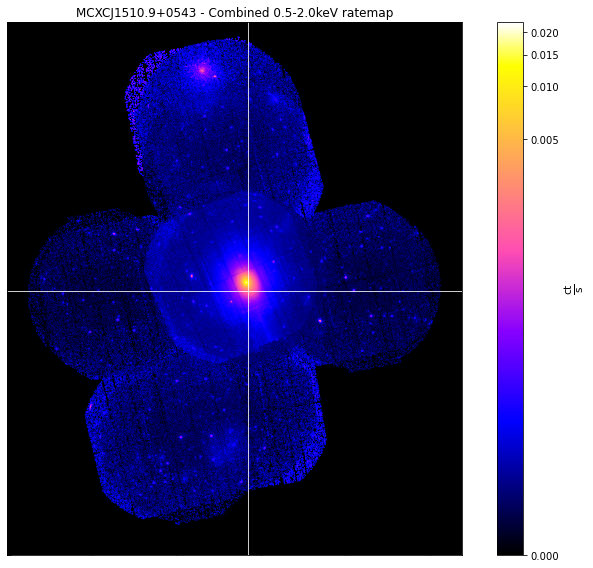


-----------------------------------------------------
Source Name - MCXCJ1510.9+0543
User Coordinates - (227.7291667, 5.72) degrees
X-ray Peak - (227.7291667, 5.72) degrees
nH - 0.0302 1e+22 / cm2
Redshift - 0.077
XMM ObsIDs - 11
PN Observations - 11
MOS1 Observations - 11
MOS2 Observations - 11
On-Axis - 5
With regions - 11
Total regions - 543
Obs with 1 detection - 5
Obs with >1 matches - 0
Images associated - 66
Exposure maps associated - 66
Combined Ratemaps associated - 1
Spectra associated - 20
R500 - 1334.4 kpc
R500 SNR - 1992.93
-----------------------------------------------------



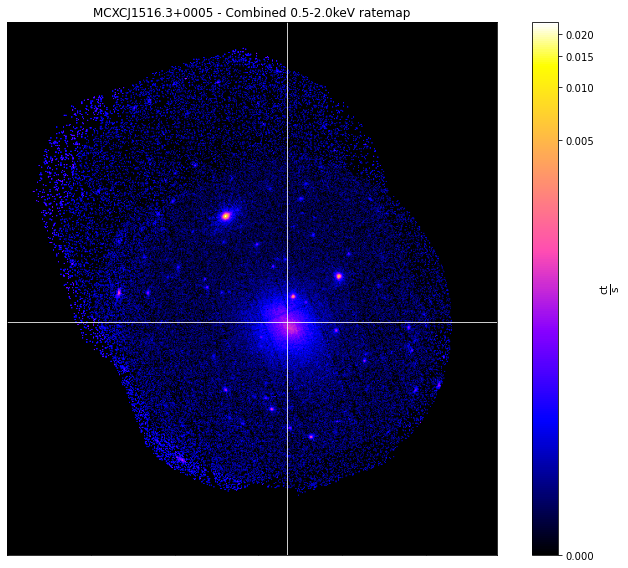


-----------------------------------------------------
Source Name - MCXCJ1516.3+0005
User Coordinates - (229.08, 0.097777778) degrees
X-ray Peak - (229.08, 0.097777778) degrees
nH - 0.043 1e+22 / cm2
Redshift - 0.118
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 1
With regions - 2
Total regions - 102
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 933.6999999999999 kpc
R500 SNR - 250.94
-----------------------------------------------------



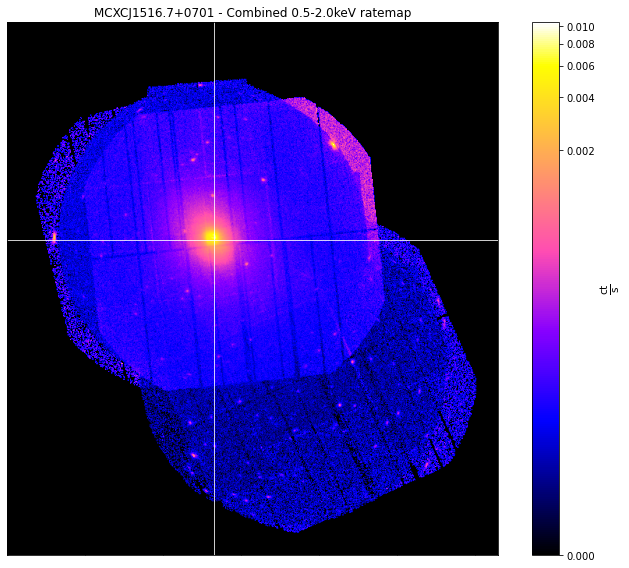


-----------------------------------------------------
Source Name - MCXCJ1516.7+0701
User Coordinates - (229.1833333, 7.018611111) degrees
X-ray Peak - (229.1833333, 7.018611111) degrees
nH - 0.0262 1e+22 / cm2
Redshift - 0.035
XMM ObsIDs - 13
PN Observations - 13
MOS1 Observations - 13
MOS2 Observations - 13
On-Axis - 12
With regions - 13
Total regions - 298
Obs with 1 detection - 12
Obs with >1 matches - 0
Images associated - 78
Exposure maps associated - 78
Combined Ratemaps associated - 1
Spectra associated - 39
R500 - 946.5 kpc
R500 SNR - 1477.26
-----------------------------------------------------



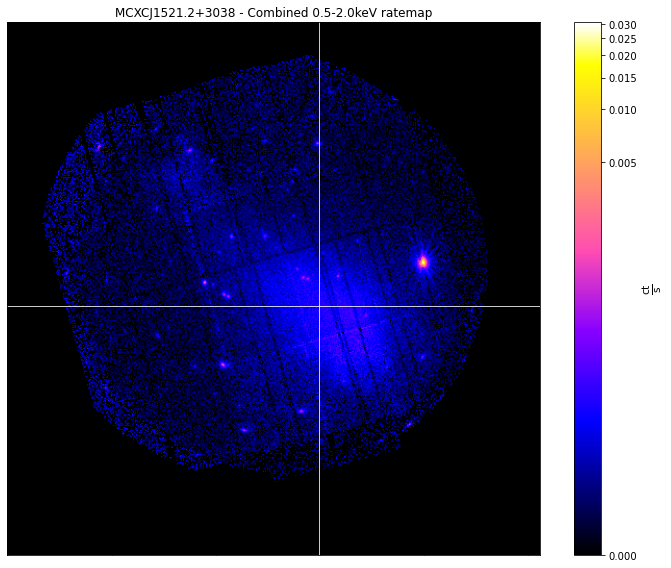


-----------------------------------------------------
Source Name - MCXCJ1521.2+3038
User Coordinates - (230.3208333, 30.64) degrees
X-ray Peak - (230.3208333, 30.64) degrees
nH - 0.0165 1e+22 / cm2
Redshift - 0.078
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 59
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 976.6 kpc
R500 SNR - 391.35
-----------------------------------------------------



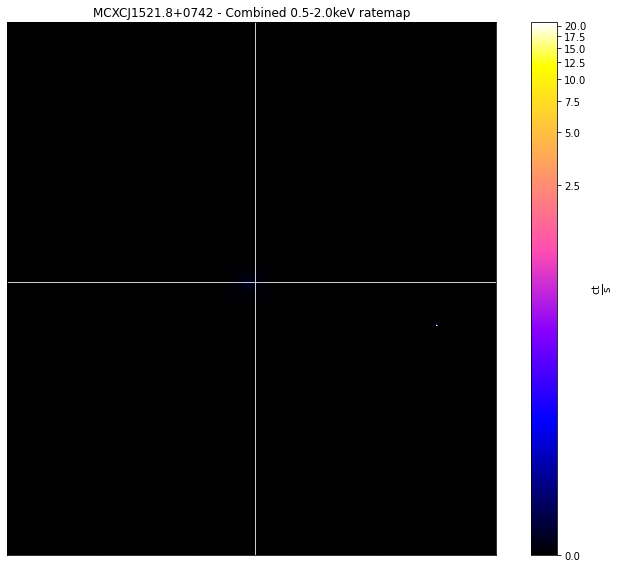


-----------------------------------------------------
Source Name - MCXCJ1521.8+0742
User Coordinates - (230.4583333, 7.708888889) degrees
X-ray Peak - (230.4583333, 7.708888889) degrees
nH - 0.0281 1e+22 / cm2
Redshift - 0.044
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 3
With regions - 3
Total regions - 133
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 13
Exposure maps associated - 13
Combined Ratemaps associated - 1
Spectra associated - 7
R500 - 947.3000000000001 kpc


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:2962: RuntimeWarning: invalid value encountered in double_scalars
  av_back = (self.data * back_mask).sum() / back_area


R500 SNR - nan
-----------------------------------------------------



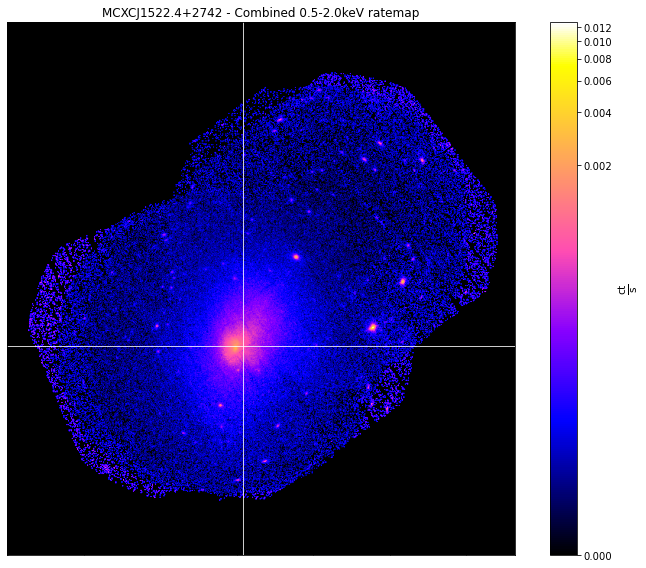


-----------------------------------------------------
Source Name - MCXCJ1522.4+2742
User Coordinates - (230.6104167, 27.70944444) degrees
X-ray Peak - (230.6104167, 27.70944444) degrees
nH - 0.0322 1e+22 / cm2
Redshift - 0.072
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 2
With regions - 3
Total regions - 131
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 1048.0 kpc
R500 SNR - 532.24
-----------------------------------------------------



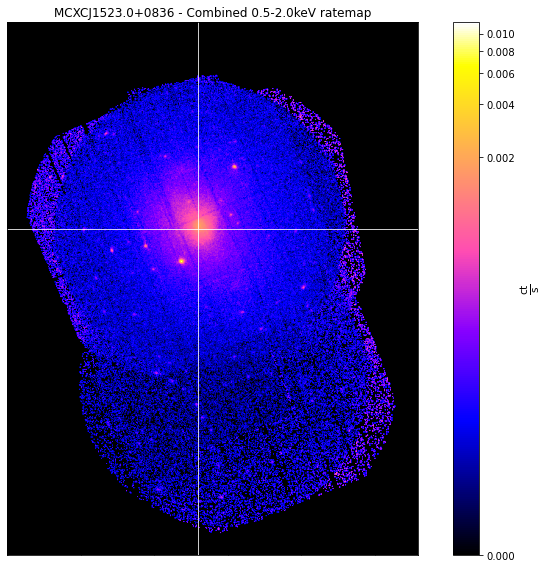


-----------------------------------------------------
Source Name - MCXCJ1523.0+0836
User Coordinates - (230.7725, 8.6025) degrees
X-ray Peak - (230.7725, 8.6025) degrees
nH - 0.0256 1e+22 / cm2
Redshift - 0.036
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 2
With regions - 3
Total regions - 96
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 902.0 kpc
R500 SNR - 570.15
-----------------------------------------------------



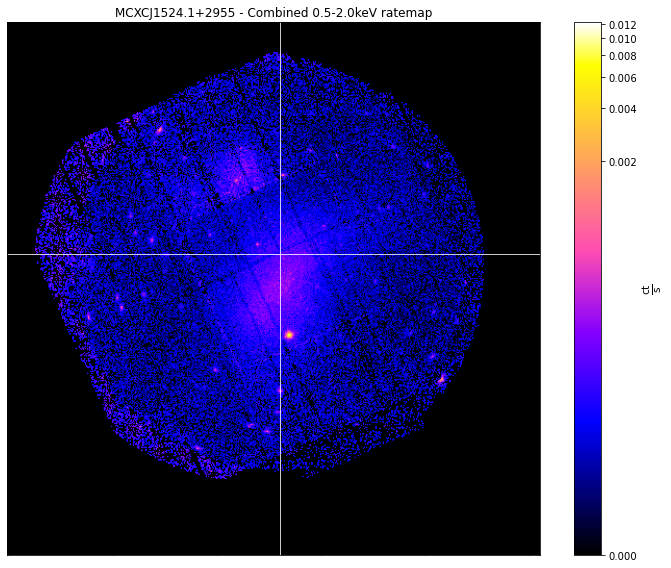


-----------------------------------------------------
Source Name - MCXCJ1524.1+2955
User Coordinates - (231.0408333, 29.92111111) degrees
X-ray Peak - (231.0408333, 29.92111111) degrees
nH - 0.0184 1e+22 / cm2
Redshift - 0.114
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 49
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1129.2 kpc
R500 SNR - 245.49
-----------------------------------------------------



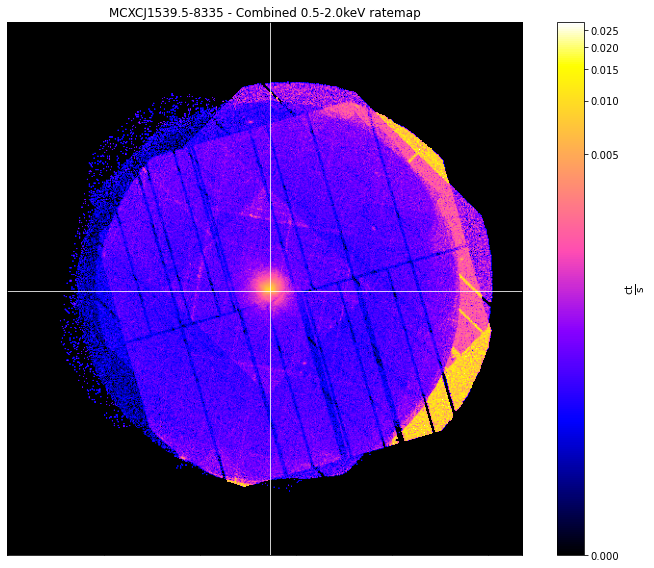


-----------------------------------------------------
Source Name - MCXCJ1539.5-8335
User Coordinates - (234.89125, -83.59222222) degrees
X-ray Peak - (234.89125, -83.59222222) degrees
nH - 0.0768 1e+22 / cm2
Redshift - 0.073
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 2
With regions - 3
Total regions - 47
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 1013.8000000000001 kpc
R500 SNR - 80.57
-----------------------------------------------------



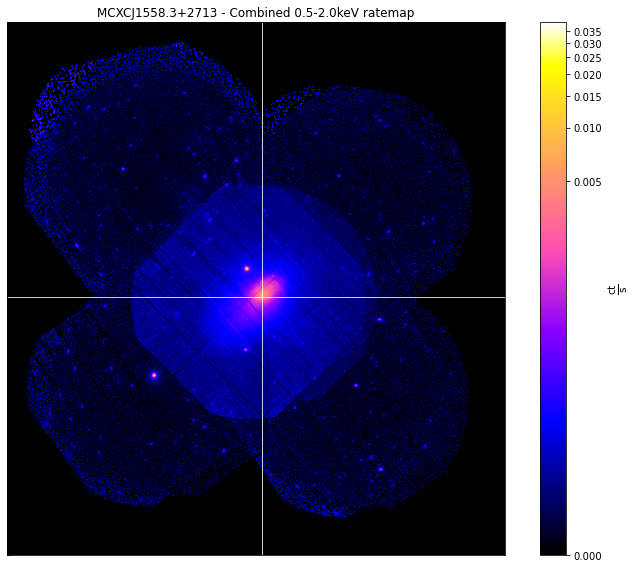


-----------------------------------------------------
Source Name - MCXCJ1558.3+2713
User Coordinates - (239.5858333, 27.22694444) degrees
X-ray Peak - (239.5858333, 27.22694444) degrees
nH - 0.0389 1e+22 / cm2
Redshift - 0.089
XMM ObsIDs - 9
PN Observations - 9
MOS1 Observations - 9
MOS2 Observations - 9
On-Axis - 3
With regions - 9
Total regions - 400
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 54
Exposure maps associated - 54
Combined Ratemaps associated - 1
Spectra associated - 22
R500 - 1380.3000000000002 kpc
R500 SNR - 1242.81
-----------------------------------------------------



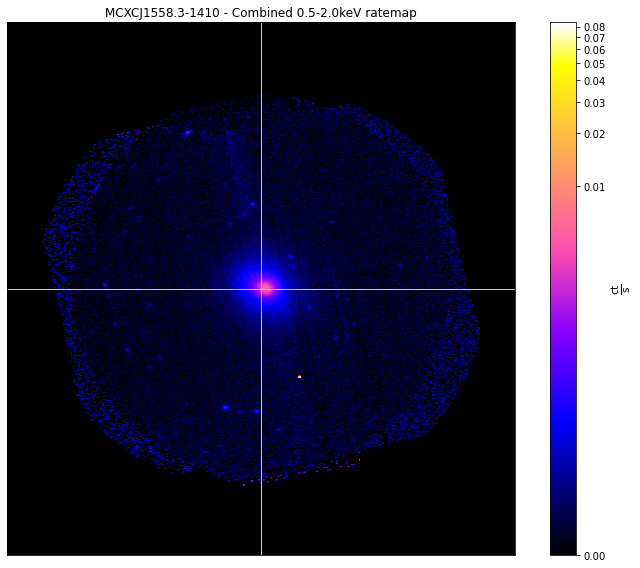


-----------------------------------------------------
Source Name - MCXCJ1558.3-1410
User Coordinates - (239.5966667, -14.16777778) degrees
X-ray Peak - (239.5966667, -14.16777778) degrees
nH - 0.105 1e+22 / cm2
Redshift - 0.097
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 4
With regions - 4
Total regions - 92
Obs with 1 detection - 4
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 12
R500 - 1074.5 kpc
R500 SNR - 512.02
-----------------------------------------------------



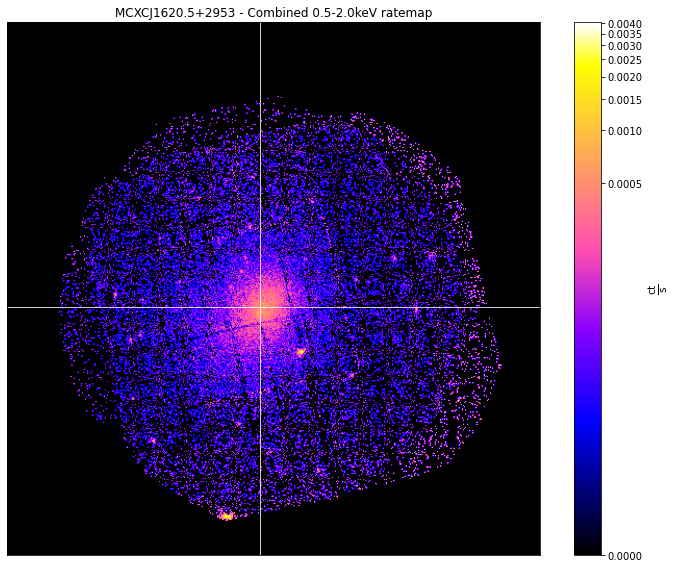


-----------------------------------------------------
Source Name - MCXCJ1620.5+2953
User Coordinates - (245.1320833, 29.89527778) degrees
X-ray Peak - (245.1320833, 29.89527778) degrees
nH - 0.0293 1e+22 / cm2
Redshift - 0.097
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 26
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 937.6 kpc
R500 SNR - 174.45
-----------------------------------------------------



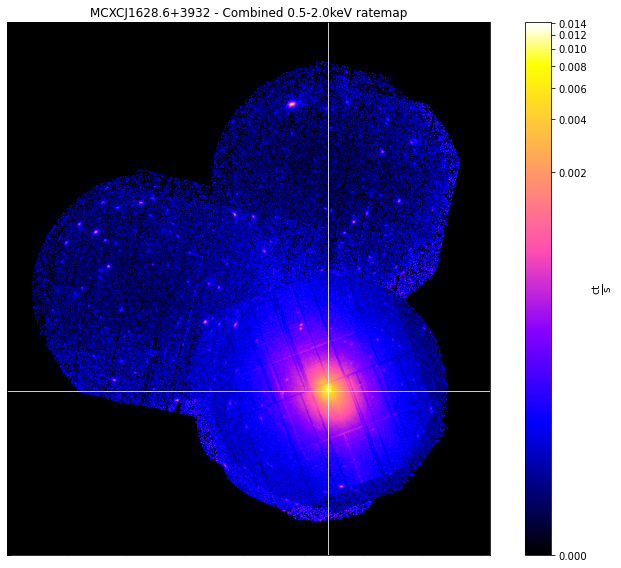


-----------------------------------------------------
Source Name - MCXCJ1628.6+3932
User Coordinates - (247.1583333, 39.54861111) degrees
X-ray Peak - (247.1583333, 39.54861111) degrees
nH - 0.00805 1e+22 / cm2
Redshift - 0.03
XMM ObsIDs - 7
PN Observations - 7
MOS1 Observations - 7
MOS2 Observations - 7
On-Axis - 5
With regions - 7
Total regions - 344
Obs with 1 detection - 5
Obs with >1 matches - 0
Images associated - 42
Exposure maps associated - 42
Combined Ratemaps associated - 1
Spectra associated - 20
R500 - 1004.0 kpc
R500 SNR - 2186.62
-----------------------------------------------------



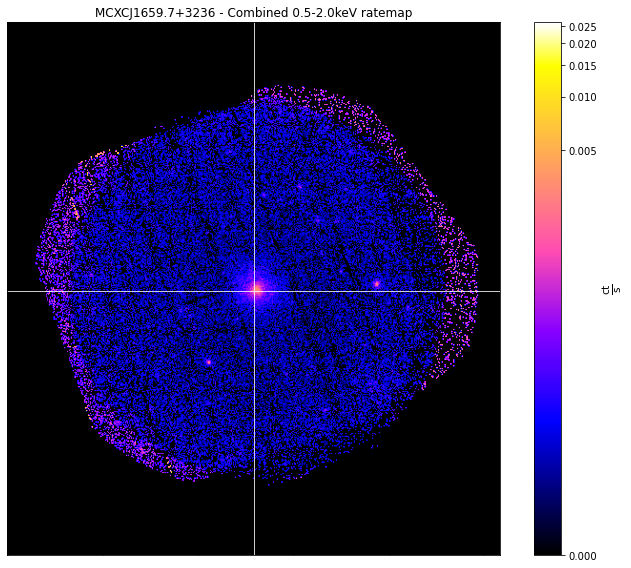


-----------------------------------------------------
Source Name - MCXCJ1659.7+3236
User Coordinates - (254.9366667, 32.61361111) degrees
X-ray Peak - (254.9366667, 32.61361111) degrees
nH - 0.019 1e+22 / cm2
Redshift - 0.101
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 3
With regions - 3
Total regions - 24
Obs with 1 detection - 3
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 867.3 kpc
R500 SNR - 105.0
-----------------------------------------------------



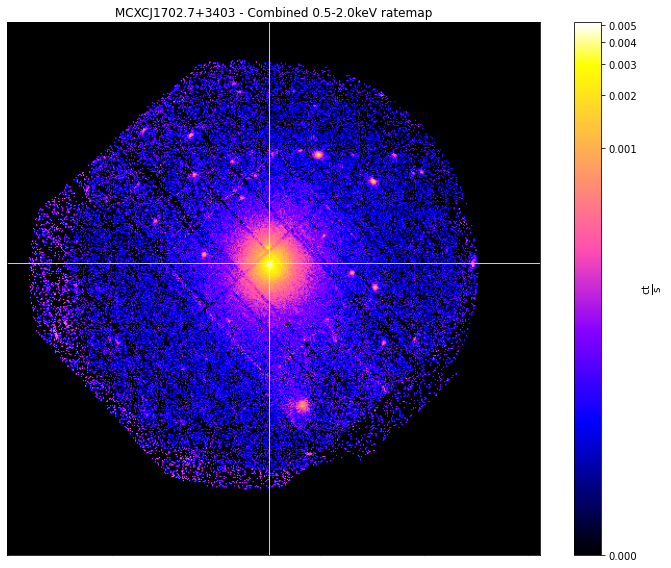


-----------------------------------------------------
Source Name - MCXCJ1702.7+3403
User Coordinates - (255.67875, 34.06194444) degrees
X-ray Peak - (255.67875, 34.06194444) degrees
nH - 0.018 1e+22 / cm2
Redshift - 0.095
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 63
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1129.5 kpc
R500 SNR - 445.57
-----------------------------------------------------



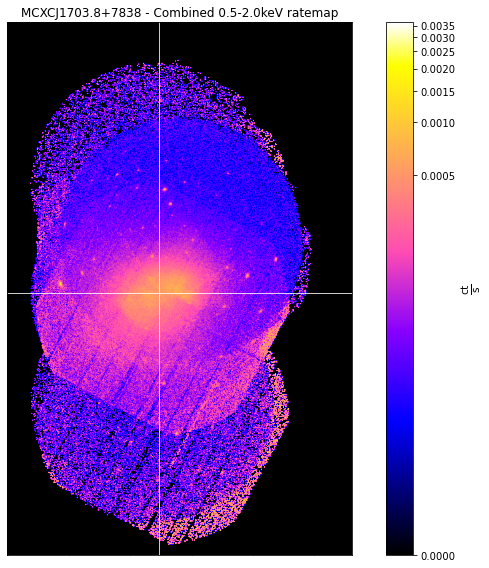


-----------------------------------------------------
Source Name - MCXCJ1703.8+7838
User Coordinates - (255.9533333, 78.64444444) degrees
X-ray Peak - (255.9533333, 78.64444444) degrees
nH - 0.0426 1e+22 / cm2
Redshift - 0.058
XMM ObsIDs - 6
PN Observations - 6
MOS1 Observations - 6
MOS2 Observations - 6
On-Axis - 1
With regions - 6
Total regions - 109
Obs with 1 detection - 4
Obs with >1 matches - 0
Images associated - 36
Exposure maps associated - 36
Combined Ratemaps associated - 1
Spectra associated - 18
R500 - 1122.4 kpc
R500 SNR - 572.34
-----------------------------------------------------



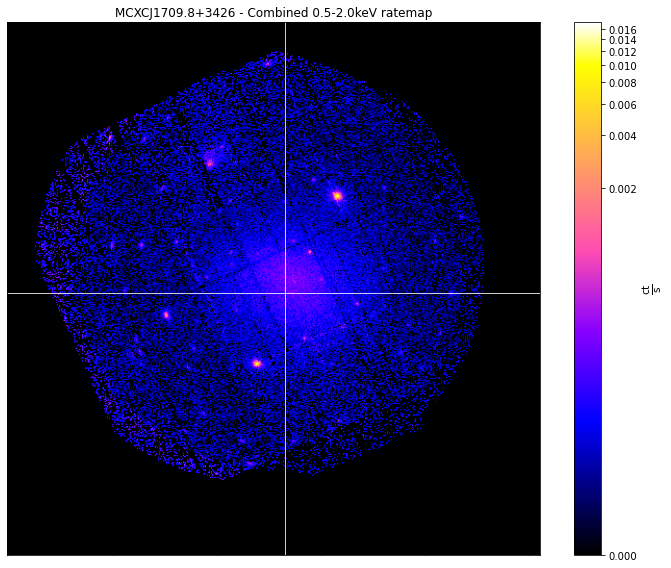


-----------------------------------------------------
Source Name - MCXCJ1709.8+3426
User Coordinates - (257.4533333, 34.44055556) degrees
X-ray Peak - (257.4533333, 34.44055556) degrees
nH - 0.0218 1e+22 / cm2
Redshift - 0.08
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 55
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 964.4000000000001 kpc
R500 SNR - 244.55
-----------------------------------------------------



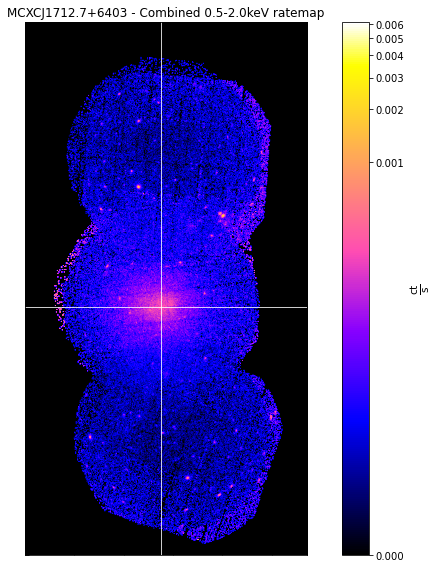


-----------------------------------------------------
Source Name - MCXCJ1712.7+6403
User Coordinates - (258.1966667, 64.06138889) degrees
X-ray Peak - (258.1966667, 64.06138889) degrees
nH - 0.0239 1e+22 / cm2
Redshift - 0.081
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 2
With regions - 4
Total regions - 120
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 8
R500 - 1067.8000000000002 kpc
R500 SNR - 235.44
-----------------------------------------------------



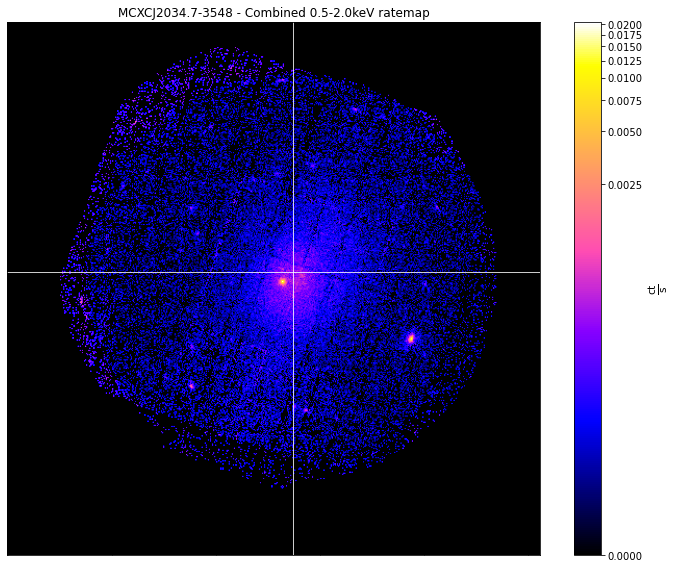


-----------------------------------------------------
Source Name - MCXCJ2034.7-3548
User Coordinates - (308.6995833, -35.81333333) degrees
X-ray Peak - (308.6995833, -35.81333333) degrees
nH - 0.0292 1e+22 / cm2
Redshift - 0.089
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 33
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1063.7 kpc
R500 SNR - 224.78
-----------------------------------------------------



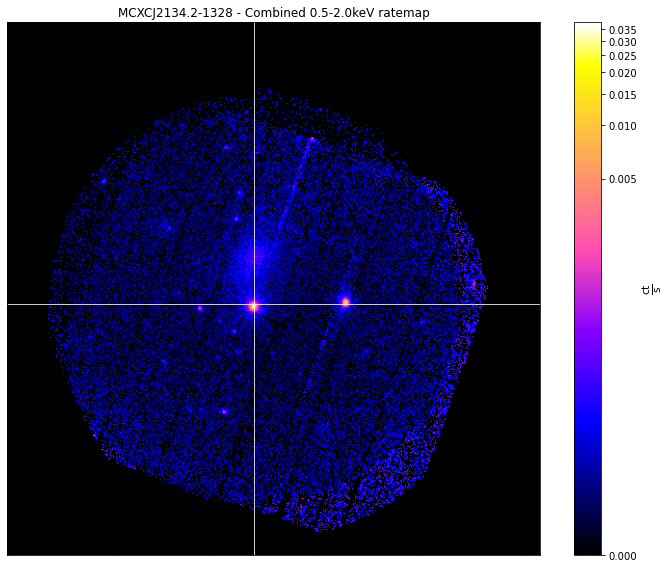


-----------------------------------------------------
Source Name - MCXCJ2134.2-1328
User Coordinates - (323.56875, -13.48) degrees
X-ray Peak - (323.56875, -13.48) degrees
nH - 0.0512 1e+22 / cm2
Redshift - 0.09
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 44
Obs with 1 detection - 0
Obs with >1 matches - 2
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 960.4 kpc
R500 SNR - 167.82
-----------------------------------------------------



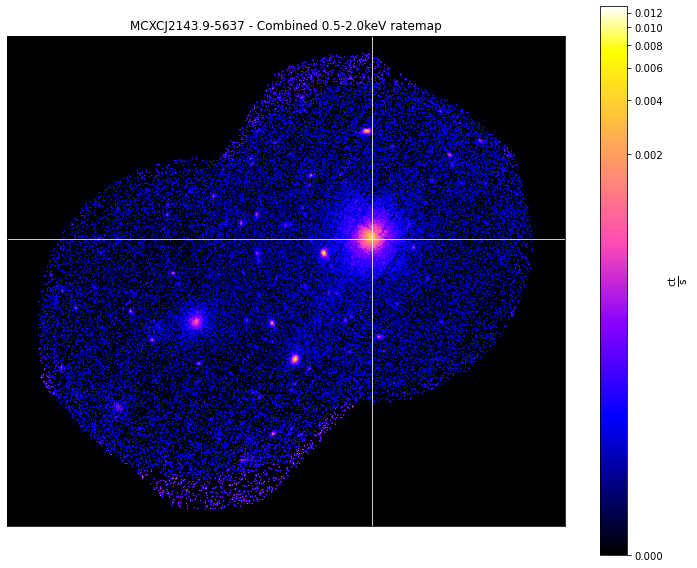


-----------------------------------------------------
Source Name - MCXCJ2143.9-5637
User Coordinates - (325.9929167, -56.62638889) degrees
X-ray Peak - (325.9929167, -56.62638889) degrees
nH - 0.0298 1e+22 / cm2
Redshift - 0.082
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 1
With regions - 2
Total regions - 93
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 4
R500 - 951.4 kpc
R500 SNR - 233.07
-----------------------------------------------------



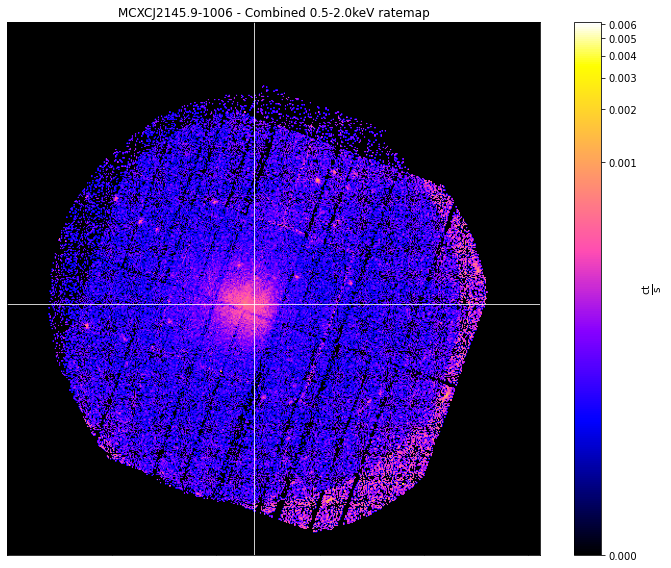


-----------------------------------------------------
Source Name - MCXCJ2145.9-1006
User Coordinates - (326.4783333, -10.10444444) degrees
X-ray Peak - (326.4783333, -10.10444444) degrees
nH - 0.0387 1e+22 / cm2
Redshift - 0.081
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 36
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 871.5 kpc
R500 SNR - 157.9
-----------------------------------------------------



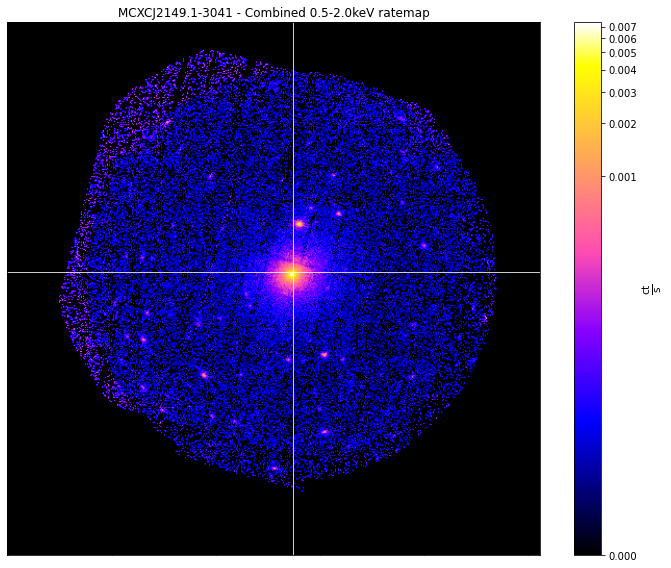


-----------------------------------------------------
Source Name - MCXCJ2149.1-3041
User Coordinates - (327.2808333, -30.69861111) degrees
X-ray Peak - (327.2808333, -30.69861111) degrees
nH - 0.0163 1e+22 / cm2
Redshift - 0.118
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 56
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 971.3000000000001 kpc
R500 SNR - 249.12
-----------------------------------------------------



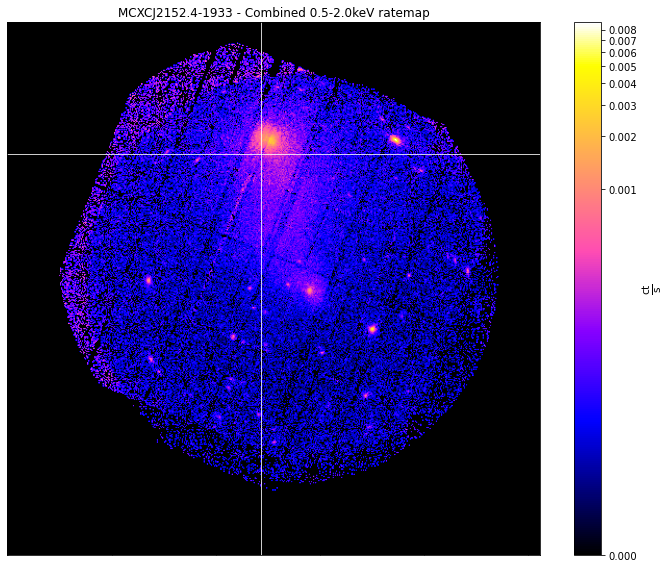


-----------------------------------------------------
Source Name - MCXCJ2152.4-1933
User Coordinates - (328.1, -19.565) degrees
X-ray Peak - (328.1, -19.565) degrees
nH - 0.0283 1e+22 / cm2
Redshift - 0.094
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 0
With regions - 1
Total regions - 53
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 943.3000000000001 kpc
R500 SNR - 181.74
-----------------------------------------------------



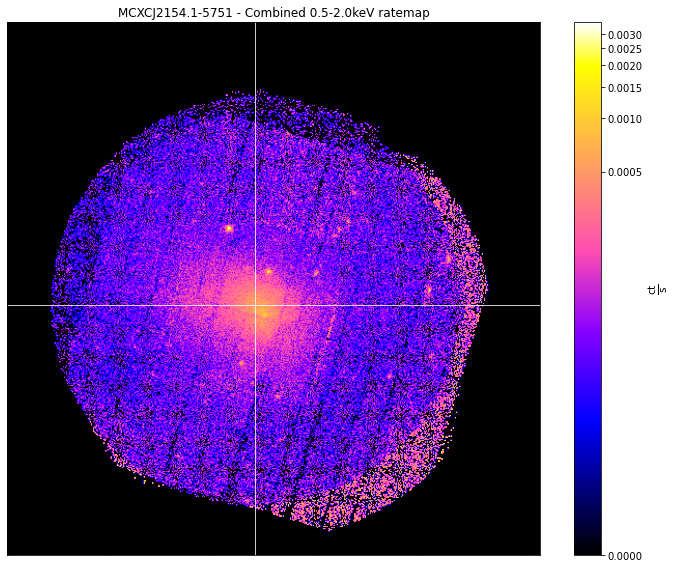


-----------------------------------------------------
Source Name - MCXCJ2154.1-5751
User Coordinates - (328.5383333, -57.85527778) degrees
X-ray Peak - (328.5383333, -57.85527778) degrees
nH - 0.0231 1e+22 / cm2
Redshift - 0.076
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 31
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 999.1 kpc
R500 SNR - 211.89
-----------------------------------------------------



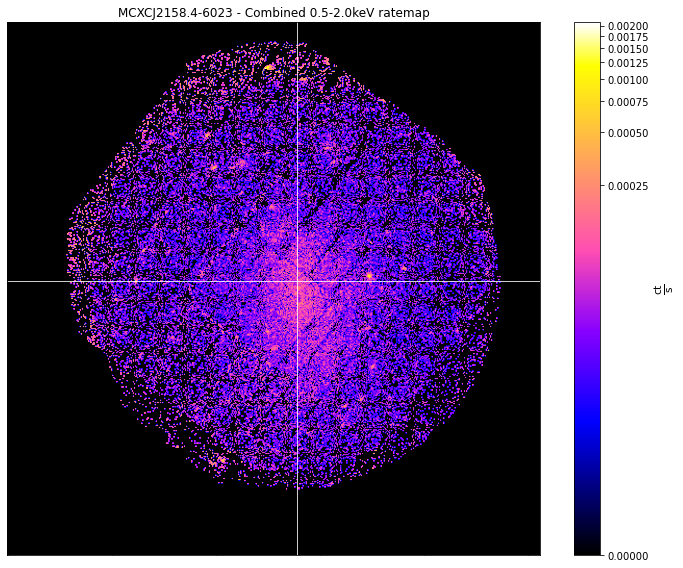


-----------------------------------------------------
Source Name - MCXCJ2158.4-6023
User Coordinates - (329.6133333, -60.39944444) degrees
X-ray Peak - (329.6133333, -60.39944444) degrees
nH - 0.0292 1e+22 / cm2
Redshift - 0.075
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 33
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 868.5 kpc
R500 SNR - 142.71
-----------------------------------------------------



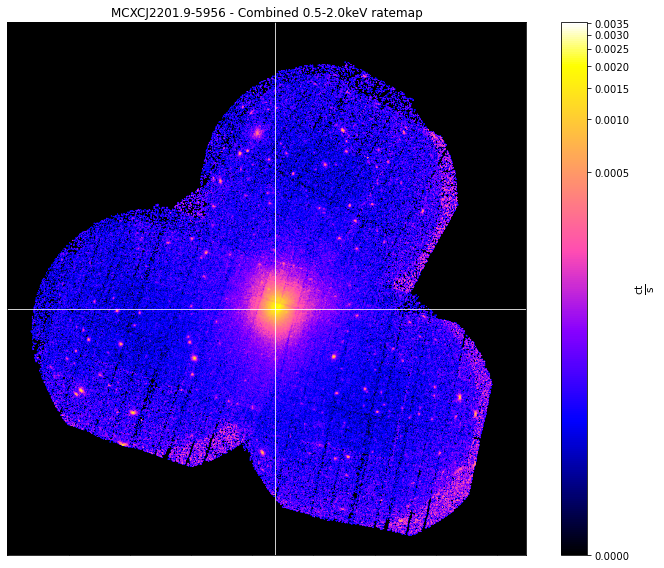


-----------------------------------------------------
Source Name - MCXCJ2201.9-5956
User Coordinates - (330.4833333, -59.94944444) degrees
X-ray Peak - (330.4833333, -59.94944444) degrees
nH - 0.0277 1e+22 / cm2
Redshift - 0.098
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 1
With regions - 4
Total regions - 179
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 12
R500 - 1136.7 kpc
R500 SNR - 466.81
-----------------------------------------------------



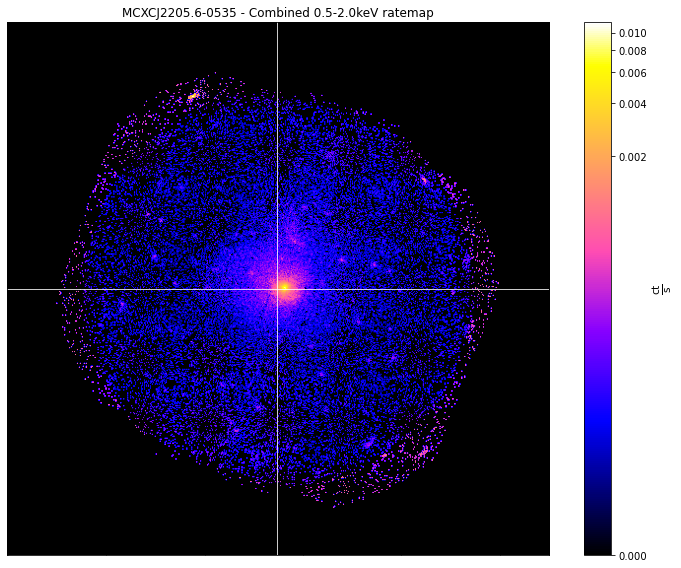


-----------------------------------------------------
Source Name - MCXCJ2205.6-0535
User Coordinates - (331.41875, -5.593333333) degrees
X-ray Peak - (331.41875, -5.593333333) degrees
nH - 0.0526 1e+22 / cm2
Redshift - 0.058
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 50
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 886.1999999999999 kpc
R500 SNR - 198.39
-----------------------------------------------------



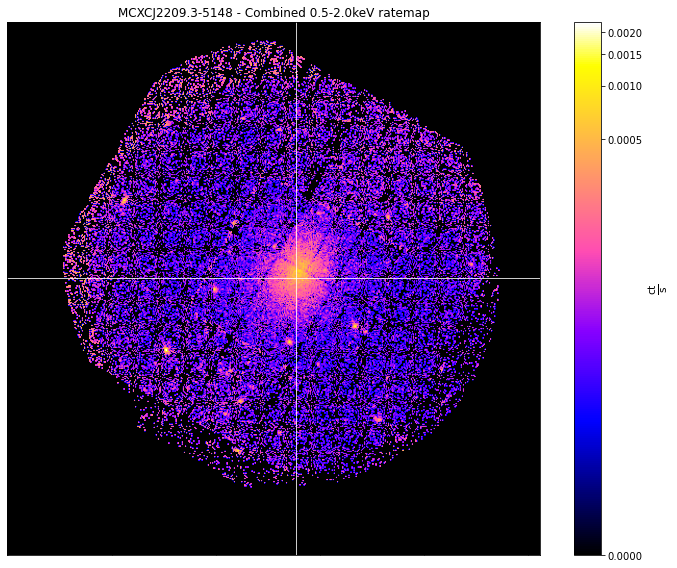


-----------------------------------------------------
Source Name - MCXCJ2209.3-5148
User Coordinates - (332.3470833, -51.815) degrees
X-ray Peak - (332.3470833, -51.815) degrees
nH - 0.0144 1e+22 / cm2
Redshift - 0.106
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 30
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 923.9000000000001 kpc
R500 SNR - 144.57
-----------------------------------------------------



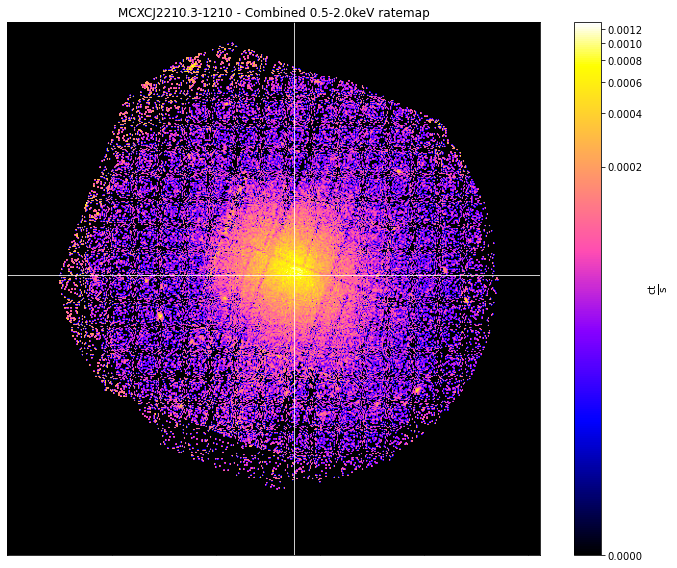


-----------------------------------------------------
Source Name - MCXCJ2210.3-1210
User Coordinates - (332.5820833, -12.17611111) degrees
X-ray Peak - (332.5820833, -12.17611111) degrees
nH - 0.0399 1e+22 / cm2
Redshift - 0.085
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 19
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1044.5 kpc
R500 SNR - 282.52
-----------------------------------------------------



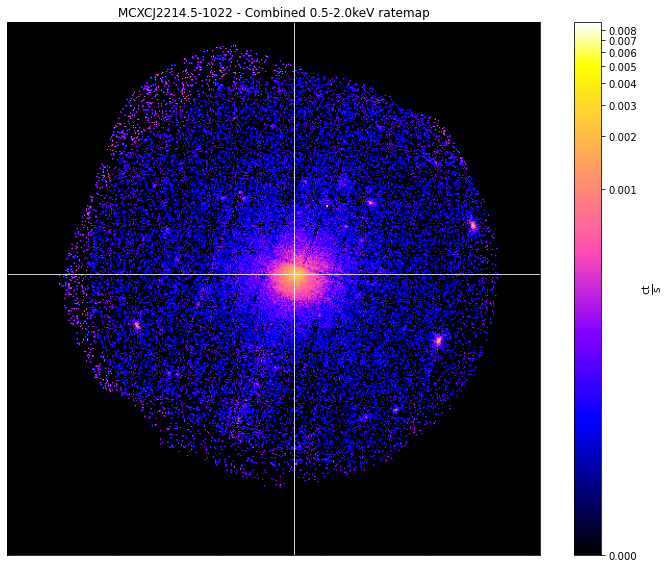


-----------------------------------------------------
Source Name - MCXCJ2214.5-1022
User Coordinates - (333.6358333, -10.37166667) degrees
X-ray Peak - (333.6358333, -10.37166667) degrees
nH - 0.0422 1e+22 / cm2
Redshift - 0.098
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 32
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1044.2 kpc
R500 SNR - 242.04
-----------------------------------------------------



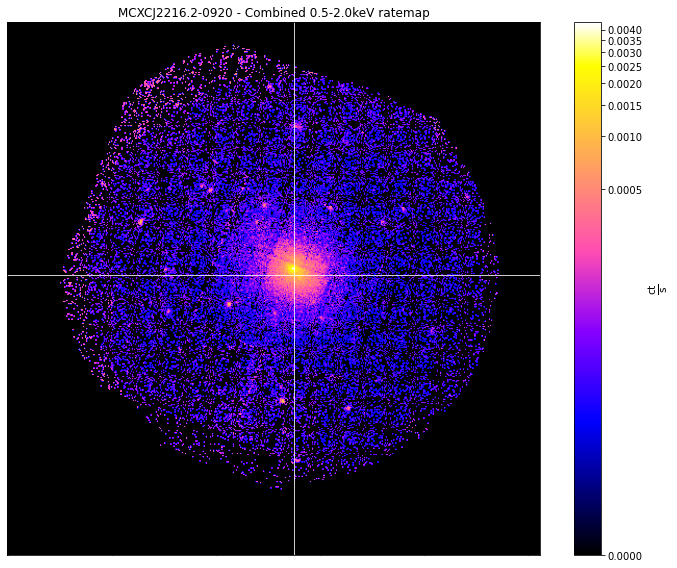


-----------------------------------------------------
Source Name - MCXCJ2216.2-0920
User Coordinates - (334.0645833, -9.34) degrees
X-ray Peak - (334.0645833, -9.34) degrees
nH - 0.0482 1e+22 / cm2
Redshift - 0.082
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 25
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 922.0 kpc
R500 SNR - 205.94
-----------------------------------------------------



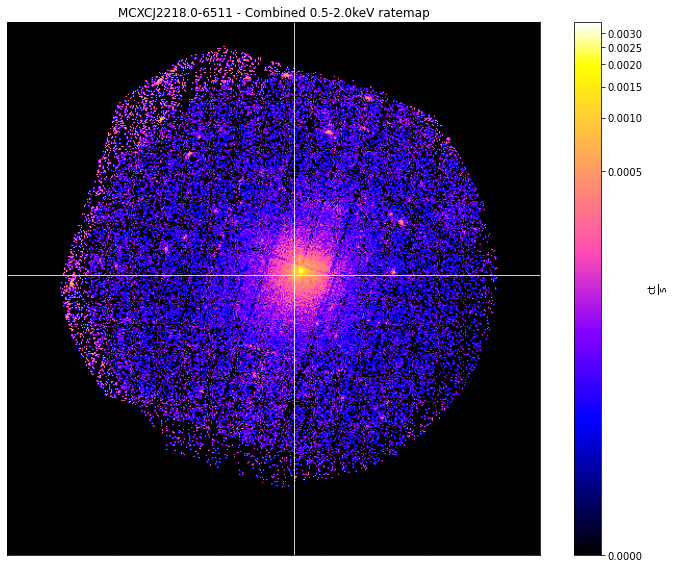


-----------------------------------------------------
Source Name - MCXCJ2218.0-6511
User Coordinates - (334.5229167, -65.185) degrees
X-ray Peak - (334.5229167, -65.185) degrees
nH - 0.0214 1e+22 / cm2
Redshift - 0.095
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 39
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 964.4000000000001 kpc
R500 SNR - 208.88
-----------------------------------------------------



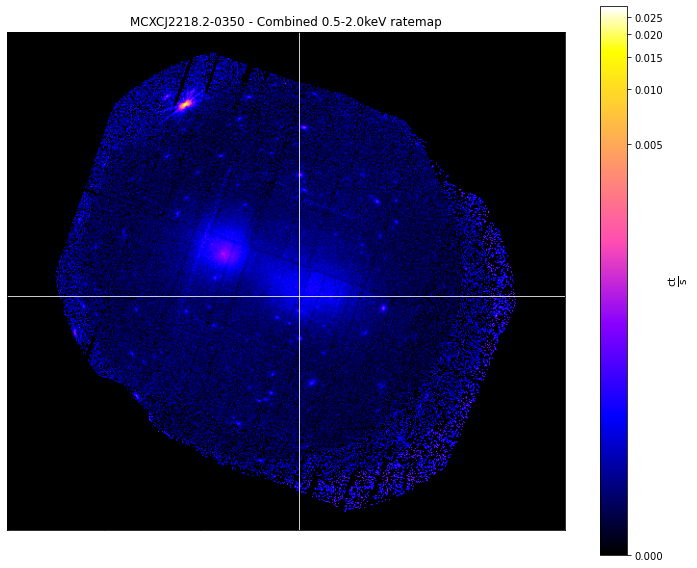


-----------------------------------------------------
Source Name - MCXCJ2218.2-0350
User Coordinates - (334.57125, -3.834166667) degrees
X-ray Peak - (334.57125, -3.834166667) degrees
nH - 0.0586 1e+22 / cm2
Redshift - 0.09
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 33
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 952.6 kpc
R500 SNR - 301.81
-----------------------------------------------------



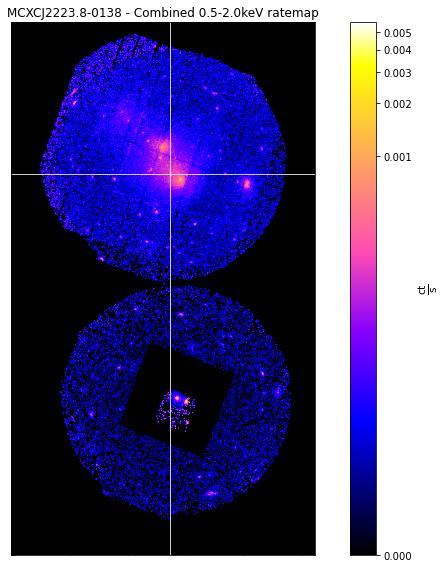


-----------------------------------------------------
Source Name - MCXCJ2223.8-0138
User Coordinates - (335.9704167, -1.637777778) degrees
X-ray Peak - (335.9704167, -1.637777778) degrees
nH - 0.0516 1e+22 / cm2
Redshift - 0.091
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 1
With regions - 2
Total regions - 91
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 971.6 kpc
R500 SNR - 267.76
-----------------------------------------------------



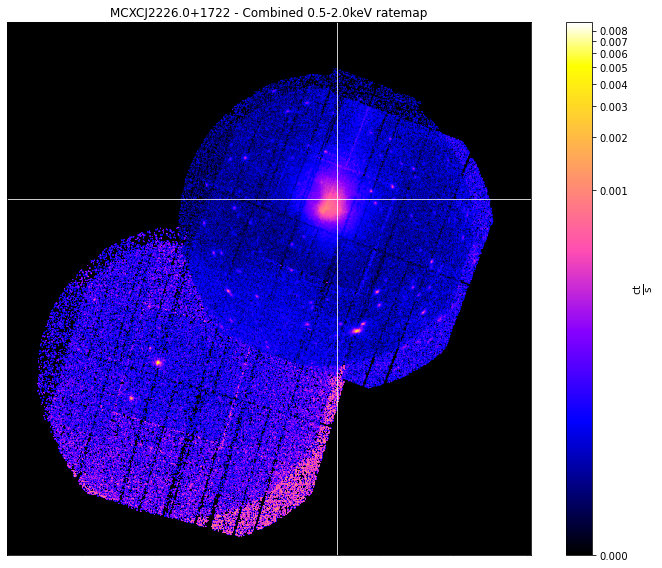


-----------------------------------------------------
Source Name - MCXCJ2226.0+1722
User Coordinates - (336.5108333, 17.37805556) degrees
X-ray Peak - (336.5108333, 17.37805556) degrees
nH - 0.0508 1e+22 / cm2
Redshift - 0.107
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 1
With regions - 2
Total regions - 95
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 5
R500 - 941.4 kpc
R500 SNR - 440.66
-----------------------------------------------------



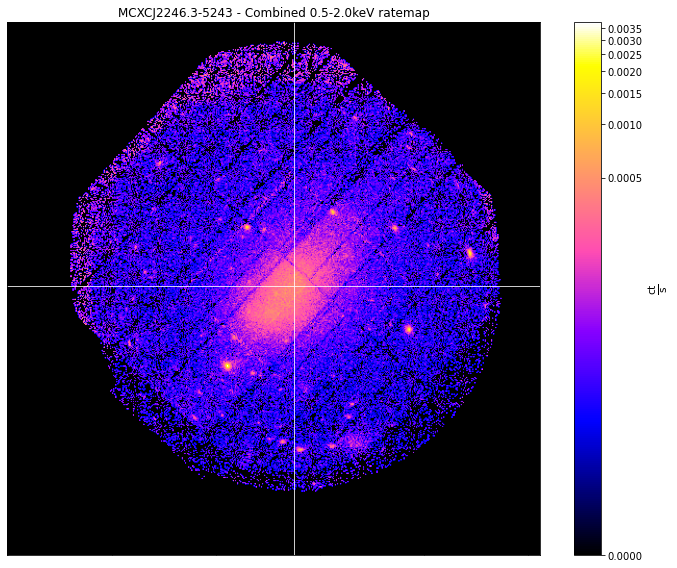


-----------------------------------------------------
Source Name - MCXCJ2246.3-5243
User Coordinates - (341.5775, -52.72944444) degrees
X-ray Peak - (341.5775, -52.72944444) degrees
nH - 0.00973 1e+22 / cm2
Redshift - 0.096
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 70
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1028.8999999999999 kpc
R500 SNR - 312.55
-----------------------------------------------------



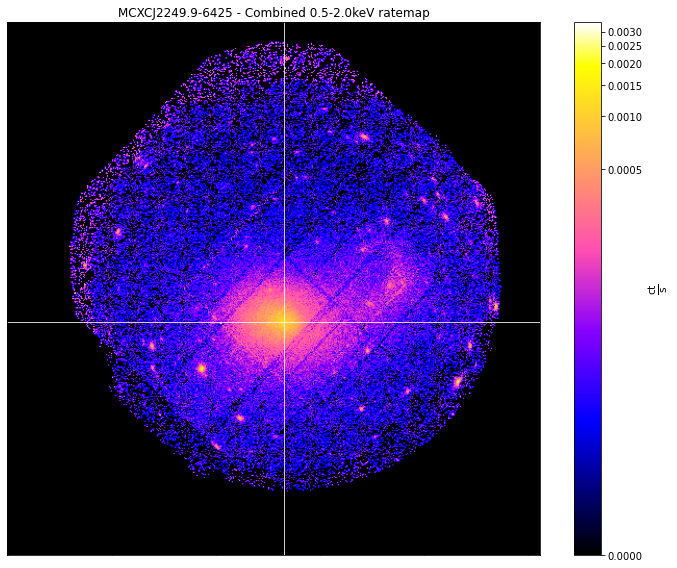


-----------------------------------------------------
Source Name - MCXCJ2249.9-6425
User Coordinates - (342.4875, -64.42944444) degrees
X-ray Peak - (342.4875, -64.42944444) degrees
nH - 0.0219 1e+22 / cm2
Redshift - 0.094
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 63
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1051.0 kpc
R500 SNR - 374.19
-----------------------------------------------------



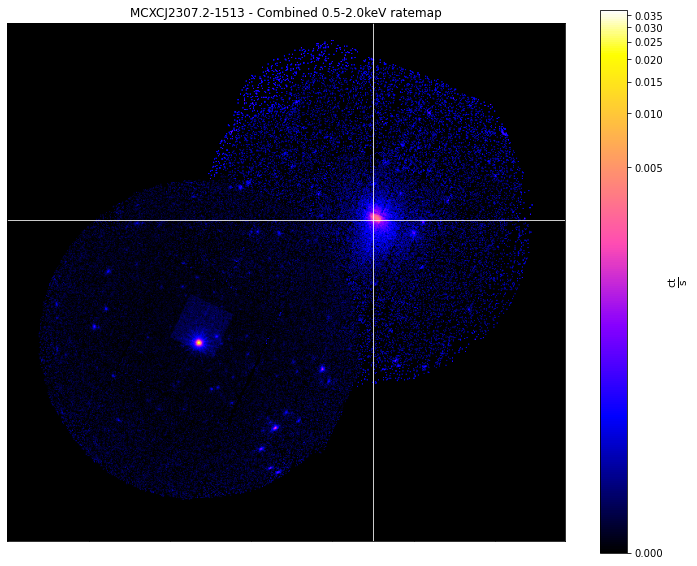


-----------------------------------------------------
Source Name - MCXCJ2307.2-1513
User Coordinates - (346.81375, -15.22833333) degrees
X-ray Peak - (346.81375, -15.22833333) degrees
nH - 0.0261 1e+22 / cm2
Redshift - 0.111
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 1
With regions - 2
Total regions - 104
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 5
R500 - 921.5 kpc
R500 SNR - 162.33
-----------------------------------------------------



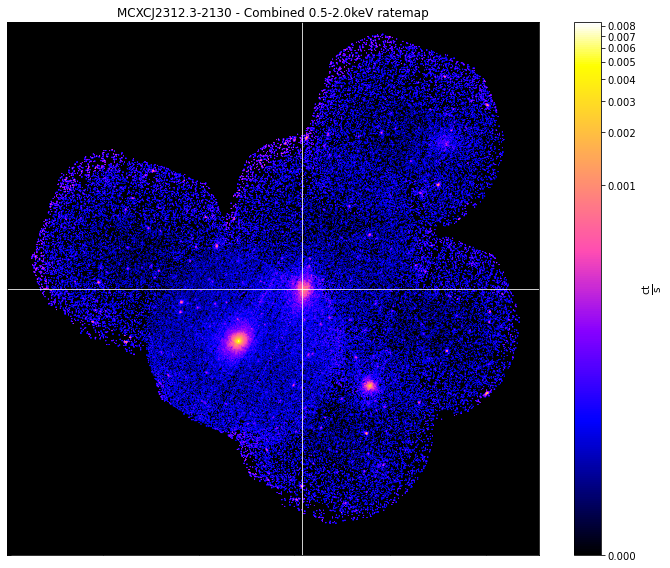


-----------------------------------------------------
Source Name - MCXCJ2312.3-2130
User Coordinates - (348.08625, -21.50055556) degrees
X-ray Peak - (348.08625, -21.50055556) degrees
nH - 0.0175 1e+22 / cm2
Redshift - 0.111
XMM ObsIDs - 6
PN Observations - 6
MOS1 Observations - 6
MOS2 Observations - 6
On-Axis - 0
With regions - 6
Total regions - 150
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 36
Exposure maps associated - 36
Combined Ratemaps associated - 1
Spectra associated - 11
R500 - 906.5 kpc
R500 SNR - 113.63
-----------------------------------------------------



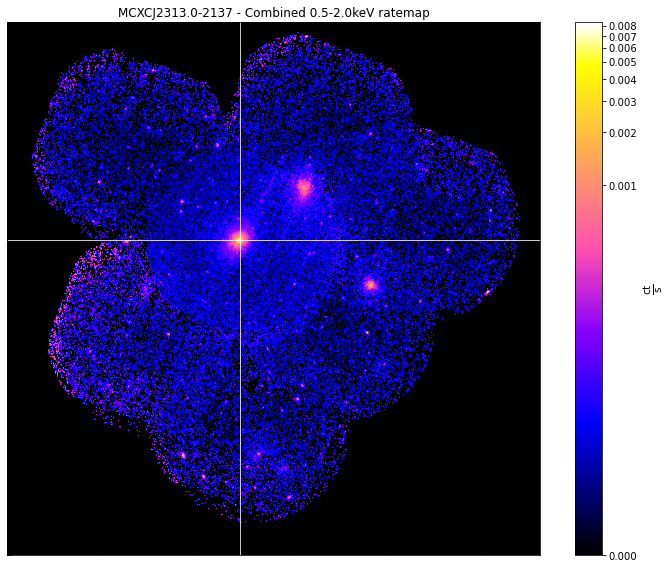


-----------------------------------------------------
Source Name - MCXCJ2313.0-2137
User Coordinates - (348.25375, -21.63194444) degrees
X-ray Peak - (348.25375, -21.63194444) degrees
nH - 0.0181 1e+22 / cm2
Redshift - 0.087
XMM ObsIDs - 7
PN Observations - 7
MOS1 Observations - 7
MOS2 Observations - 7
On-Axis - 1
With regions - 7
Total regions - 163
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 42
Exposure maps associated - 42
Combined Ratemaps associated - 1
Spectra associated - 11
R500 - 928.6 kpc
R500 SNR - 199.8
-----------------------------------------------------



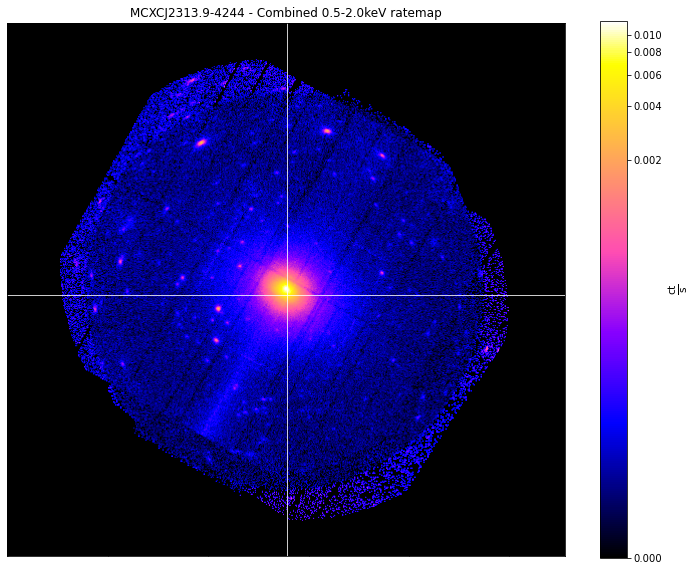


-----------------------------------------------------
Source Name - MCXCJ2313.9-4244
User Coordinates - (348.4941667, -42.73388889) degrees
X-ray Peak - (348.4941667, -42.73388889) degrees
nH - 0.00914 1e+22 / cm2
Redshift - 0.056
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 233
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 980.1999999999999 kpc
R500 SNR - 1006.75
-----------------------------------------------------



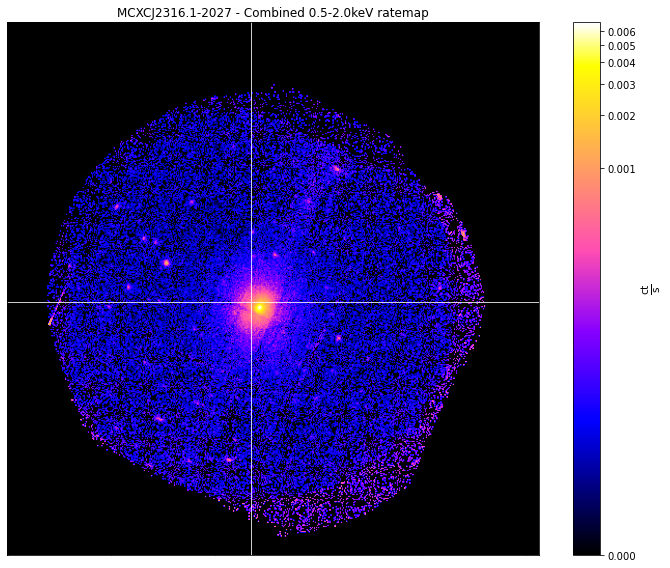


-----------------------------------------------------
Source Name - MCXCJ2316.1-2027
User Coordinates - (349.03125, -20.45527778) degrees
X-ray Peak - (349.03125, -20.45527778) degrees
nH - 0.019 1e+22 / cm2
Redshift - 0.082
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 59
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 890.5999999999999 kpc
R500 SNR - 260.95
-----------------------------------------------------



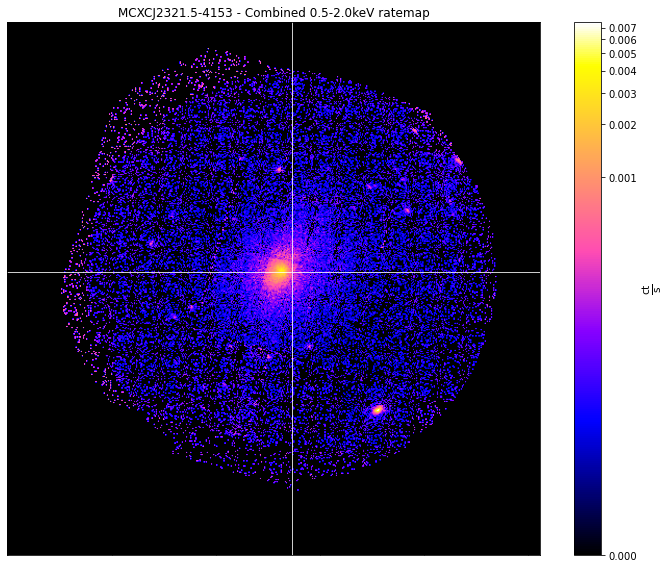


-----------------------------------------------------
Source Name - MCXCJ2321.5-4153
User Coordinates - (350.3891667, -41.89888889) degrees
X-ray Peak - (350.3891667, -41.89888889) degrees
nH - 0.0151 1e+22 / cm2
Redshift - 0.089
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 19
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 941.5 kpc
R500 SNR - 179.56
-----------------------------------------------------



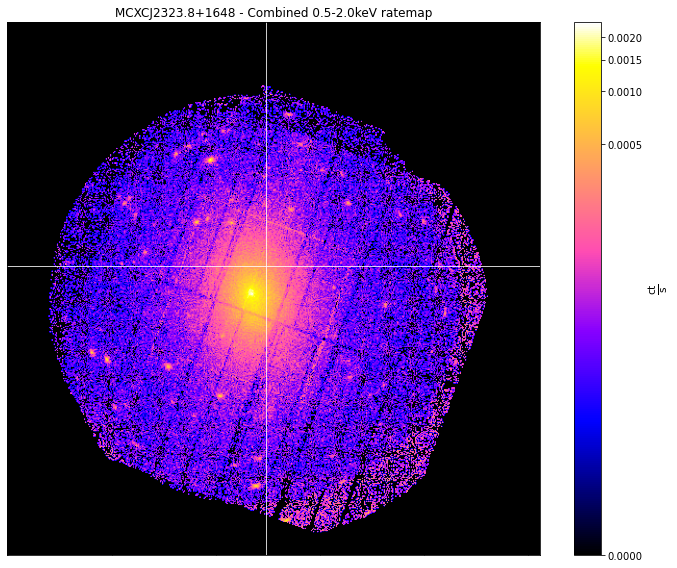


-----------------------------------------------------
Source Name - MCXCJ2323.8+1648
User Coordinates - (350.9729167, 16.80888889) degrees
X-ray Peak - (350.9729167, 16.80888889) degrees
nH - 0.0296 1e+22 / cm2
Redshift - 0.042
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 60
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 876.0 kpc
R500 SNR - 374.71
-----------------------------------------------------



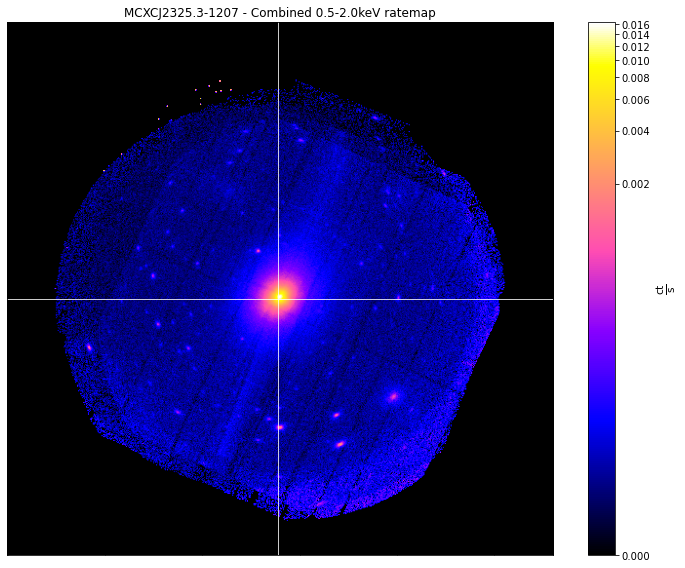


-----------------------------------------------------
Source Name - MCXCJ2325.3-1207
User Coordinates - (351.3333333, -12.12722222) degrees
X-ray Peak - (351.3333333, -12.12722222) degrees
nH - 0.0225 1e+22 / cm2
Redshift - 0.085
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 4
With regions - 4
Total regions - 262
Obs with 1 detection - 4
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 12
R500 - 1106.6000000000001 kpc
R500 SNR - 1120.28
-----------------------------------------------------



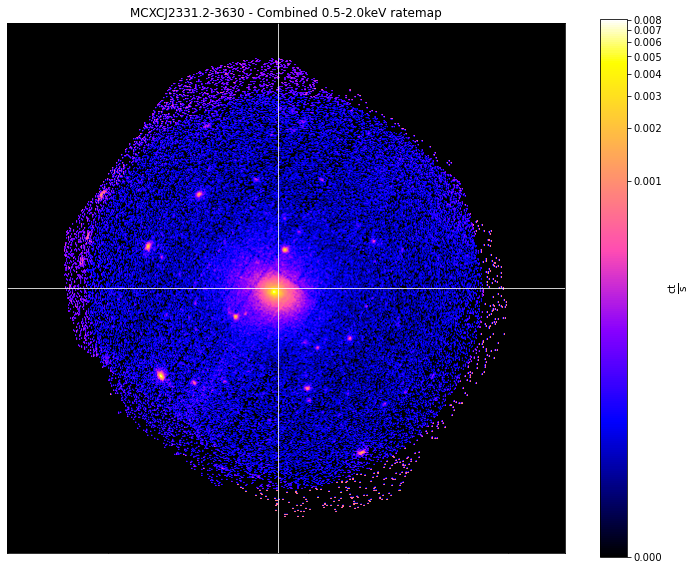


-----------------------------------------------------
Source Name - MCXCJ2331.2-3630
User Coordinates - (352.8029167, -36.50666667) degrees
X-ray Peak - (352.8029167, -36.50666667) degrees
nH - 0.0137 1e+22 / cm2
Redshift - 0.096
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 58
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 1017.2000000000002 kpc
R500 SNR - 284.38
-----------------------------------------------------



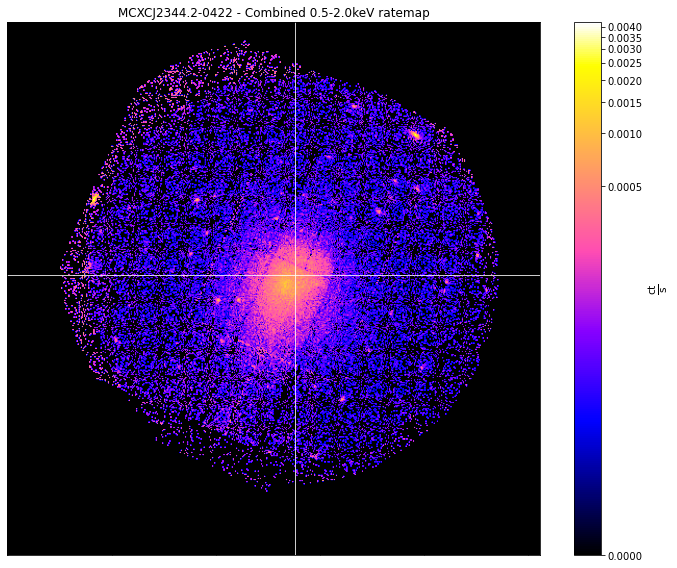


-----------------------------------------------------
Source Name - MCXCJ2344.2-0422
User Coordinates - (356.0666667, -4.3675) degrees
X-ray Peak - (356.0666667, -4.3675) degrees
nH - 0.0333 1e+22 / cm2
Redshift - 0.079
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 35
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 972.7 kpc
R500 SNR - 241.22
-----------------------------------------------------



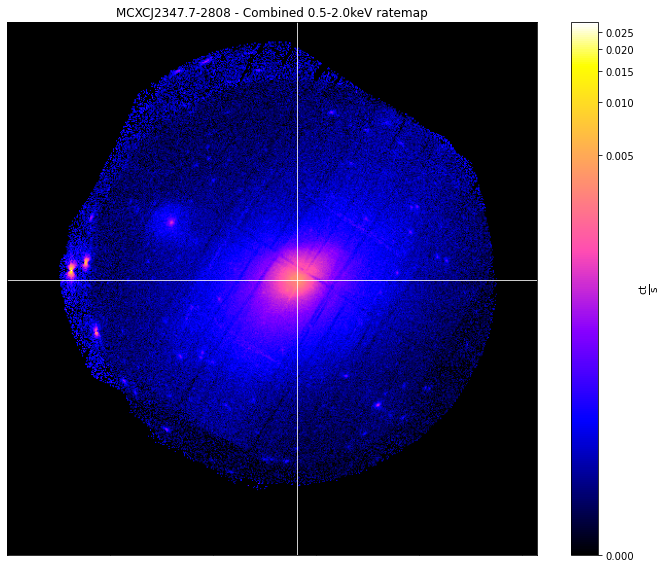


-----------------------------------------------------
Source Name - MCXCJ2347.7-2808
User Coordinates - (356.93, -28.14138889) degrees
X-ray Peak - (356.93, -28.14138889) degrees
nH - 0.0138 1e+22 / cm2
Redshift - 0.03
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 2
With regions - 2
Total regions - 123
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 886.3 kpc


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:2962: RuntimeWarning: invalid value encountered in double_scalars
  av_back = (self.data * back_mask).sum() / back_area


R500 SNR - nan
-----------------------------------------------------



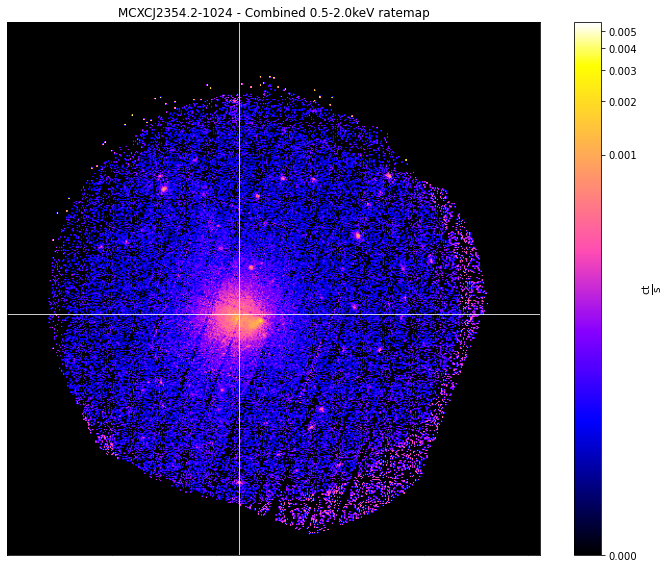


-----------------------------------------------------
Source Name - MCXCJ2354.2-1024
User Coordinates - (358.5558333, -10.41277778) degrees
X-ray Peak - (358.5558333, -10.41277778) degrees
nH - 0.0283 1e+22 / cm2
Redshift - 0.076
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 52
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 911.3 kpc
R500 SNR - 232.06
-----------------------------------------------------



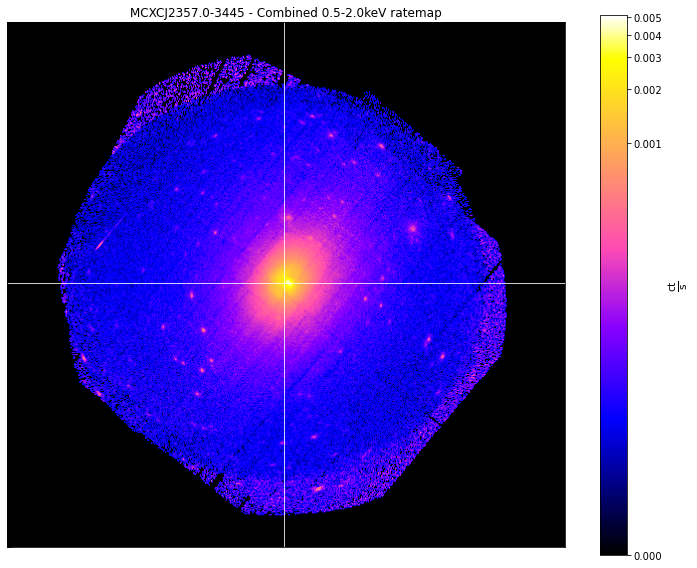


-----------------------------------------------------
Source Name - MCXCJ2357.0-3445
User Coordinates - (359.2595833, -34.76055556) degrees
X-ray Peak - (359.2595833, -34.76055556) degrees
nH - 0.0108 1e+22 / cm2
Redshift - 0.048
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 4
With regions - 4
Total regions - 245
Obs with 1 detection - 4
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 12
R500 - 964.0 kpc
R500 SNR - nan
-----------------------------------------------------



/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:2962: RuntimeWarning: invalid value encountered in double_scalars
  av_back = (self.data * back_mask).sum() / back_area


In [7]:
for src in lovoccs_noclean:
    if src.name in det:
        rt = src.get_combined_ratemaps()
        rt.view(src.ra_dec)
        src.info()

## Which galaxy clusters have XMM observations but aren't detected?

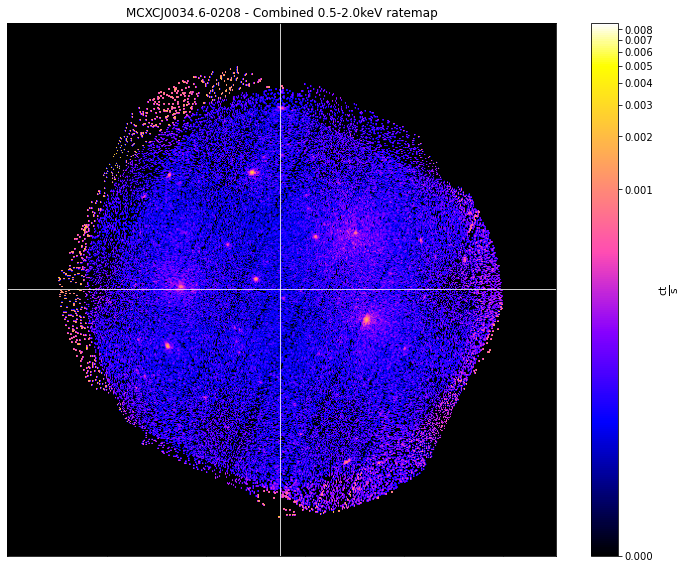


-----------------------------------------------------
Source Name - MCXCJ0034.6-0208
User Coordinates - (8.65, -2.14) degrees
X-ray Peak - (8.65, -2.14) degrees
nH - 0.0288 1e+22 / cm2
Redshift - 0.081
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 4
With regions - 4
Total regions - 35
Obs with 1 detection - 0
Obs with >1 matches - 0
Images associated - 21
Exposure maps associated - 21
Combined Ratemaps associated - 1
Spectra associated - 12
R500 - 897.2 kpc
R500 SNR - 105.91
-----------------------------------------------------



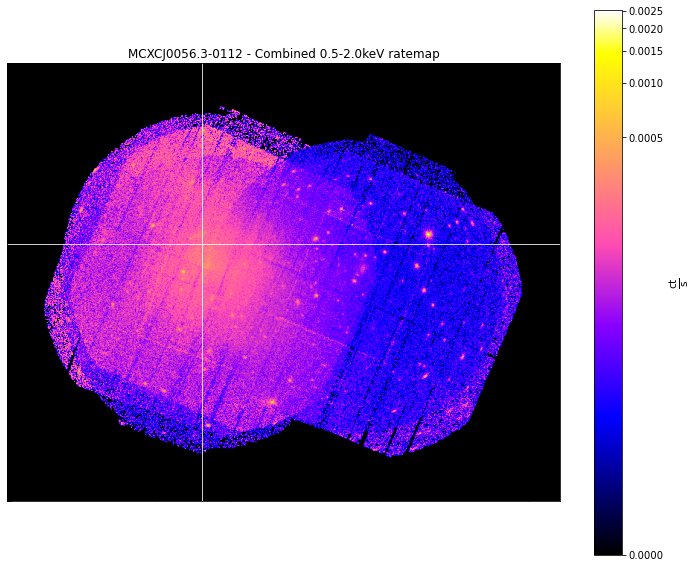


-----------------------------------------------------
Source Name - MCXCJ0056.3-0112
User Coordinates - (14.07625, -1.216666667) degrees
X-ray Peak - (14.07625, -1.216666667) degrees
nH - 0.0328 1e+22 / cm2
Redshift - 0.044
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 2
With regions - 4
Total regions - 198
Obs with 1 detection - 0
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 12
R500 - 941.3000000000001 kpc
R500 SNR - 714.64
-----------------------------------------------------



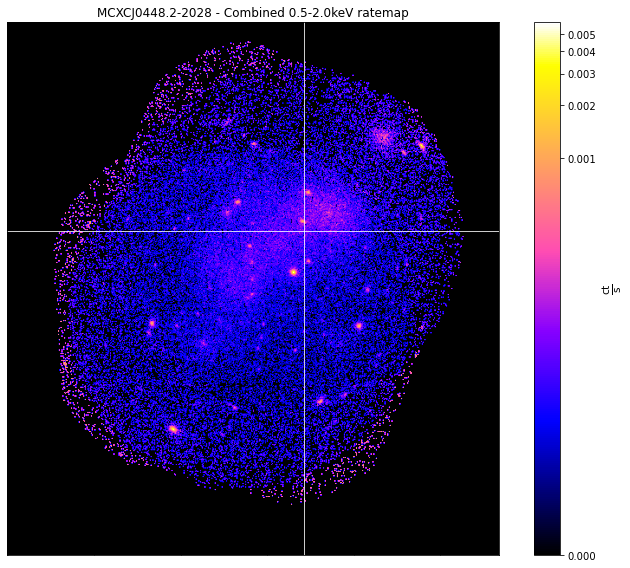


-----------------------------------------------------
Source Name - MCXCJ0448.2-2028
User Coordinates - (72.05083333, -20.46972222) degrees
X-ray Peak - (72.05083333, -20.46972222) degrees
nH - 0.0365 1e+22 / cm2
Redshift - 0.072
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 1
With regions - 3
Total regions - 92
Obs with 1 detection - 0
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 862.0 kpc
R500 SNR - 152.55
-----------------------------------------------------



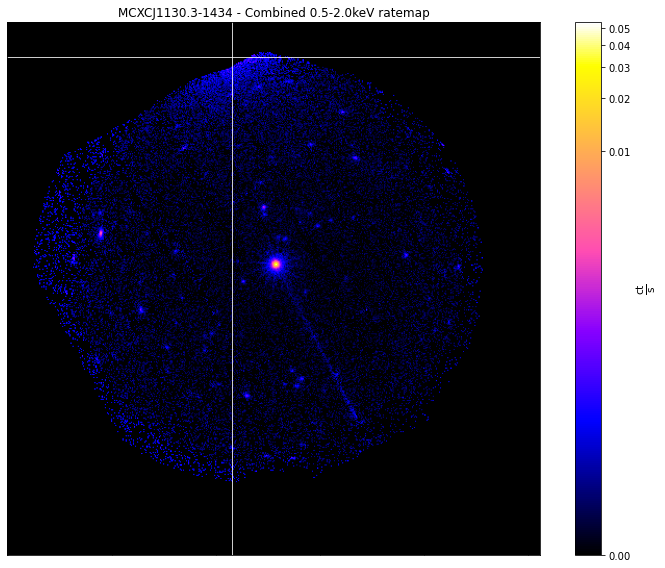


-----------------------------------------------------
Source Name - MCXCJ1130.3-1434
User Coordinates - (172.58125, -14.58305556) degrees
X-ray Peak - (172.58125, -14.58305556) degrees
nH - 0.0339 1e+22 / cm2
Redshift - 0.107
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 0
With regions - 1
Total regions - 63
Obs with 1 detection - 0
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 1026.2 kpc
R500 SNR - 69.38
-----------------------------------------------------



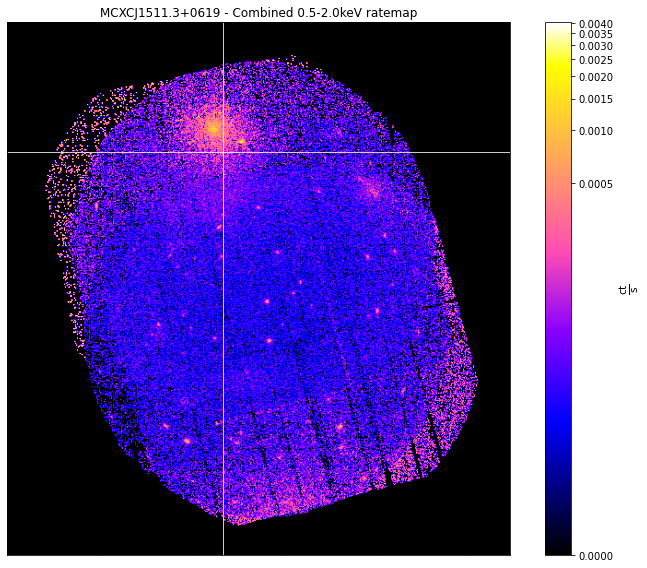


-----------------------------------------------------
Source Name - MCXCJ1511.3+0619
User Coordinates - (227.8479167, 6.318888889) degrees
X-ray Peak - (227.8479167, 6.318888889) degrees
nH - 0.0269 1e+22 / cm2
Redshift - 0.082
XMM ObsIDs - 2
PN Observations - 2
MOS1 Observations - 2
MOS2 Observations - 2
On-Axis - 0
With regions - 2
Total regions - 80
Obs with 1 detection - 0
Obs with >1 matches - 0
Images associated - 12
Exposure maps associated - 12
Combined Ratemaps associated - 1
Spectra associated - 6
R500 - 918.3 kpc
R500 SNR - 91.77
-----------------------------------------------------



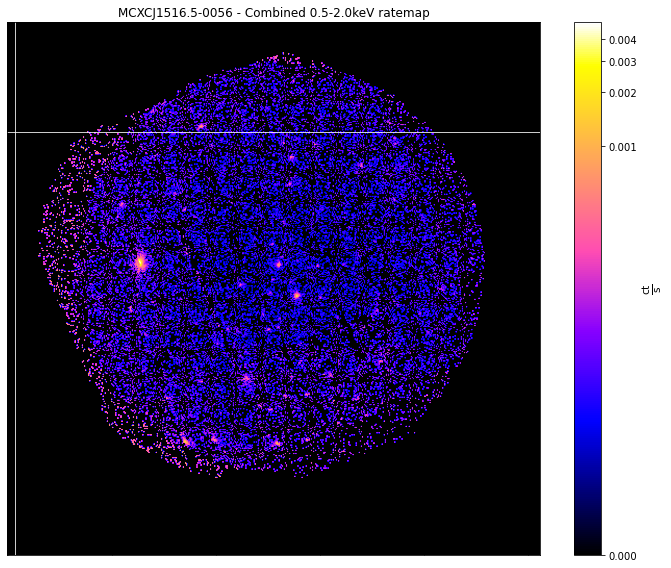


-----------------------------------------------------
Source Name - MCXCJ1516.5-0056
User Coordinates - (229.1416667, 0.948888889) degrees
X-ray Peak - (229.1416667, 0.948888889) degrees
nH - 0.0375 1e+22 / cm2
Redshift - 0.12
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 0
With regions - 1
Total regions - 47
Obs with 1 detection - 0
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 0
R500 - 883.9 kpc
R500 SNR - 14.72
-----------------------------------------------------



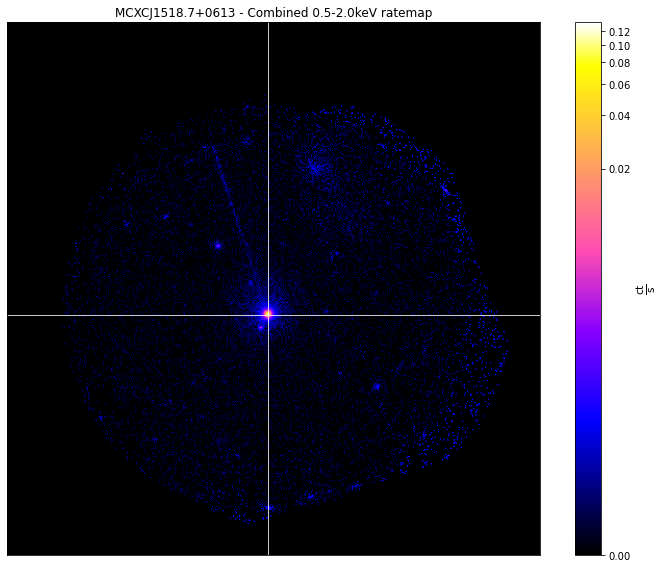


-----------------------------------------------------
Source Name - MCXCJ1518.7+0613
User Coordinates - (229.69, 6.231111111) degrees
X-ray Peak - (229.69, 6.231111111) degrees
nH - 0.0291 1e+22 / cm2
Redshift - 0.102
XMM ObsIDs - 1
PN Observations - 1
MOS1 Observations - 1
MOS2 Observations - 1
On-Axis - 1
With regions - 1
Total regions - 31
Obs with 1 detection - 1
Obs with >1 matches - 0
Images associated - 6
Exposure maps associated - 6
Combined Ratemaps associated - 1
Spectra associated - 3
R500 - 997.9 kpc
R500 SNR - 177.61
-----------------------------------------------------



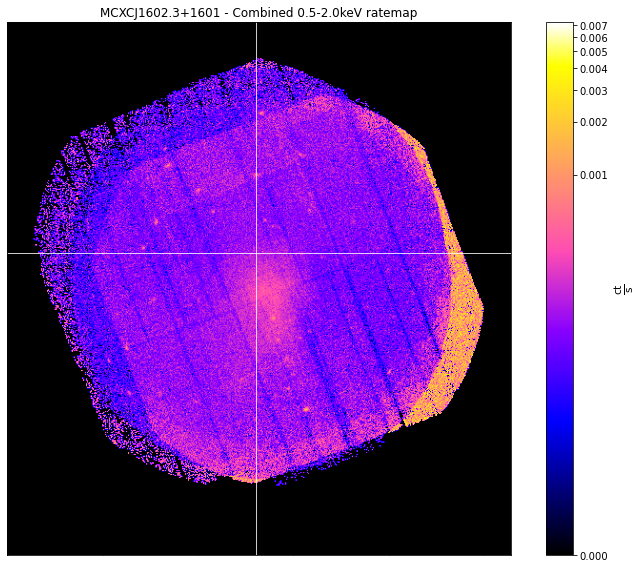


-----------------------------------------------------
Source Name - MCXCJ1602.3+1601
User Coordinates - (240.5779167, 16.02) degrees
X-ray Peak - (240.5779167, 16.02) degrees
nH - 0.0268 1e+22 / cm2
Redshift - 0.035
XMM ObsIDs - 4
PN Observations - 4
MOS1 Observations - 4
MOS2 Observations - 4
On-Axis - 4
With regions - 4
Total regions - 69
Obs with 1 detection - 0
Obs with >1 matches - 0
Images associated - 24
Exposure maps associated - 24
Combined Ratemaps associated - 1
Spectra associated - 12
R500 - 935.1 kpc
R500 SNR - nan
-----------------------------------------------------



/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:2962: RuntimeWarning: invalid value encountered in double_scalars
  av_back = (self.data * back_mask).sum() / back_area


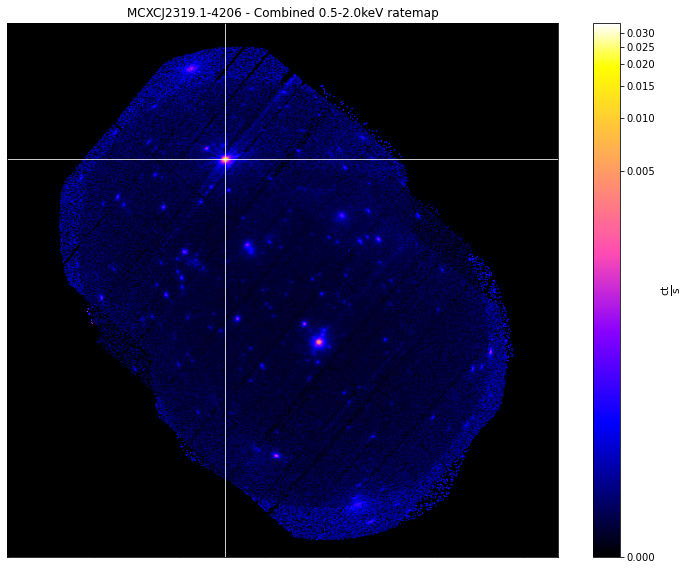


-----------------------------------------------------
Source Name - MCXCJ2319.1-4206
User Coordinates - (349.775, -42.11388889) degrees
X-ray Peak - (349.775, -42.11388889) degrees
nH - 0.0135 1e+22 / cm2
Redshift - 0.045
XMM ObsIDs - 5
PN Observations - 5
MOS1 Observations - 5
MOS2 Observations - 5
On-Axis - 0
With regions - 5
Total regions - 398
Obs with 1 detection - 2
Obs with >1 matches - 0
Images associated - 30
Exposure maps associated - 30
Combined Ratemaps associated - 1
Spectra associated - 15
R500 - 936.6999999999999 kpc
R500 SNR - 262.54
-----------------------------------------------------



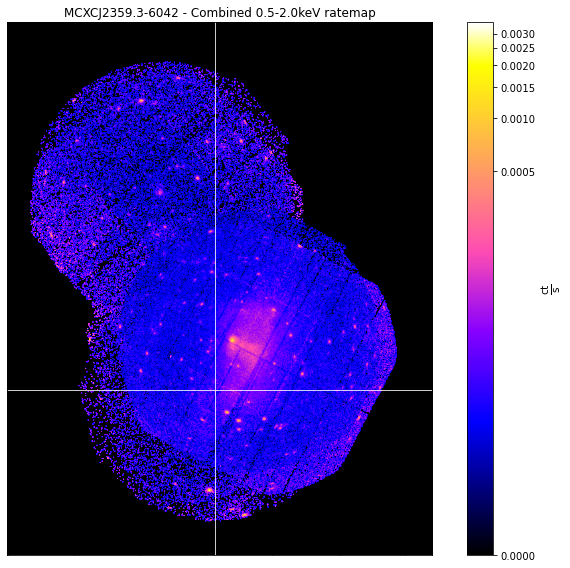


-----------------------------------------------------
Source Name - MCXCJ2359.3-6042
User Coordinates - (359.83, -60.7) degrees
X-ray Peak - (359.83, -60.7) degrees
nH - 0.012 1e+22 / cm2
Redshift - 0.099
XMM ObsIDs - 3
PN Observations - 3
MOS1 Observations - 3
MOS2 Observations - 3
On-Axis - 1
With regions - 3
Total regions - 197
Obs with 1 detection - 0
Obs with >1 matches - 0
Images associated - 18
Exposure maps associated - 18
Combined Ratemaps associated - 1
Spectra associated - 9
R500 - 857.1999999999999 kpc
R500 SNR - 110.32
-----------------------------------------------------



In [8]:
for src in lovoccs_noclean:
    if src.name not in det:
        rt = src.get_combined_ratemaps()
        rt.view(src.ra_dec)
        src.info()

Notes:
* MCXC J0034.6-0208 - not detected by XCS/matches by XGA, and no obvious cluster at the coordinates, though 2-3 extended sources nearby. Given ROSAT's positional error and PSF the extended sources could have been blended.
* MCXC J1130.3-1434 - Actually off of the observation, would have been caught by XGA if clean_obs was turned on when sample was declared, but I wanted to load all the nearby observations.
* MCXC J1516.5-0056 - Same situation as above, actually off of the detector.
* MCXC J1413.7+4339 - Initially was not convinced this is a galaxy cluster. It was targeted by XMM as a blazar, went to the legacy survey sky viewer 

In [9]:
non_det_need_obs = ['MCXCJ1130.3-1434', 'MCXCJ1516.5-0056']

## Which clusters need XMM observations 

In [117]:
need_obs = sample[(~sample['name'].isin(lovoccs_noclean.names)) 
                  | (sample['name'].isin(non_det_need_obs))].reset_index(drop=True)
obs_sample = sample[~sample['name'].isin(need_obs['name'])].reset_index(drop=True)
need_obs.to_csv('unobserved_subsample.csv', index=False)
need_obs.head(10)

,name,MCXC,ra,dec,redshift,L500,M500,R500,alt_name,other_names,Notes
0,MCXCJ0028.6-2338,J0028.6-2338,7.163750,-23.637222,0.1120,1.404549,2.3285,0.9024,RXCJ0028.6-2338,A42,NaN
1,MCXCJ0041.7+2124,J0041.7+2124,10.446250,21.413889,0.1014,1.000012,1.9071,0.8473,RXCJ0041.7+2124,A84,NaN
2,MCXCJ0043.8+2424,J0043.8+2424,10.967083,24.401944,0.0830,1.839590,2.8014,0.9690,ZwCl235,ZwCl235,NaN
3,MCXCJ0049.8+2426,J0049.8+2426,12.452083,24.441111,0.0815,1.042960,1.9841,0.8641,A104,A104,NaN
4,MCXCJ0052.7-8015,J0052.7-8015,13.187083,-80.266389,0.1141,3.393306,3.9812,1.0783,RXCJ0052.7-8015,A2837,NaN
5,MCXCJ0107.8-3643,J0107.8-3643,16.954583,-36.727222,0.1186,1.156778,2.0589,0.8642,RXCJ0107.8-3643,A2871,NaN
6,MCXCJ0212.8-4707,J0212.8-4707,33.224583,-47.132778,0.1150,1.162194,2.0701,0.8668,RXCJ0212.8-4707,A2988,NaN
7,MCXCJ0704.4+6318,J0704.4+6318,106.102083,63.316111,0.0980,1.576739,2.5235,0.9312,RXCJ0704.4+6318,A566,NaN
8,MCXCJ0726.0+4122,J0726.0+4122,111.502083,41.382222,0.1120,1.171477,2.0846,0.8697,RXCJ0726.0+4122,A580,NaN
9,MCXCJ0736.4+3925,J0736.4+3925,114.105833,39.433333,0.1177,2.518069,3.3105,1.0128,RXCJ0736.4+3925,NaN,C


## Setting colours

In [48]:
obs_col = 'lightsteelblue'
noobs_col = 'teal'

## Checking the degree radii - XMM FoV is ~0.25$^\circ$ (15 arcmin)

### For the previously observed sample

In [13]:
obs_ang_r500s = obs_sample.apply(lambda x: rad_to_ang(Quantity(x.R500, 'Mpc'), 
                                                         x.redshift).value, axis=1)
print(Quantity(obs_ang_r500s.values, 'deg').to('arcmin'))

[ 7.06190281  7.36060513 11.89100177  8.41530364  8.2125156   8.46490969
  9.31560608  9.46045097 18.11500538  8.45436242  7.40629868 17.45411231
 13.71526024  7.39382277  8.53316517 13.10624866 14.26855585 10.21623813
 12.76230483  9.32221679 11.85257588 15.08102634  7.60945305 18.28500793
 16.26315812 24.72845612 10.14084318 17.50478446  8.16206951 16.39457459
  9.3479102   9.55371117 10.2175212   7.00079746  7.15022512 11.72691248
  8.20333097 13.50395054 17.29418564 13.79469593 11.20413367 11.44520309
 17.38040694 18.8846486  10.06405783 10.9241086  23.98770224 16.47152779
 10.26258373  9.37997585 11.87926611  8.3227648   8.72136187  8.54161544
 14.83541146  9.62929893  7.06380672 21.74216127  8.57375378 10.71759447
 17.56536767 12.28217544 20.60817075  8.77525663 11.80669047 13.34635364
  9.66022223 21.48029055  8.41403283 27.05164461  7.50358853 10.31553023
 16.09715424 10.28381191 11.2971225  10.28509481  9.25843806  9.89971964
  9.2306386   7.33215719  8.69627909 11.18748512  9

### For the sample that need observations

In [14]:
need_obs_ang_r500s = need_obs.apply(lambda x: rad_to_ang(Quantity(x.R500, 'Mpc'), 
                                                         x.redshift).value, axis=1)
Quantity(need_obs_ang_r500s.values, 'deg').to('arcmin')

<Quantity [ 7.14878643,  7.32417056, 10.01697644,  9.08107227,  8.40523036,
            6.5141656 ,  6.71063964,  8.29605043,  6.88973799,  7.68475847,
            7.32797046,  6.78384375,  6.93214346,  9.1337437 ,  6.68651778,
            6.49448244,  8.47461871,  7.21084036,  7.9068692 ,  7.07216786,
            7.13182953,  6.42920567, 11.08329205,  7.55096088,  8.4227738 ,
            7.13424143,  6.60495915,  7.71212873,  8.92413415,  7.28543035,
            6.51781577, 10.42694019,  7.90285929,  7.56351851] arcmin>

The good news is that the $R_{500}$s of all of the LoVoCCs clusters that require XMM observations are less than 15 arcmin, which is the approximate FoV of XMM - thus mosaics should not be required for any basic XMM analysis of these clusters.

## MCXC properties of LoVoCCs clusters

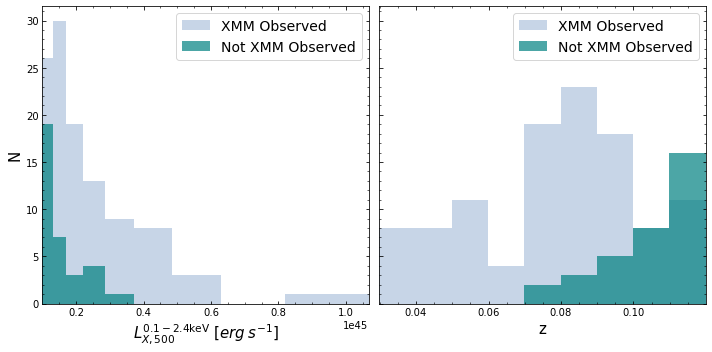

In [118]:
fig, ax_arr = plt.subplots(ncols=2, figsize=(10, 5), sharey='row')

ax = ax_arr[0]
ax.minorticks_on()
ax.tick_params(which='both', direction='in', top=True, right=True)

l_max = sample['L500'].values.max()*1e+44
l_min = sample['L500'].values.min()*1e+44
l_bins = np.logspace(np.log10(l_min), np.log10(l_max), num=10)

ax.hist(obs_sample['L500']*1e+44, bins=l_bins, label='XMM Observed', 
         color=obs_col, alpha=0.7, density=False, histtype='stepfilled')
ax.hist(need_obs['L500']*1e+44, bins=l_bins, label='Not XMM Observed', 
         color=noobs_col, alpha=0.7, density=False, histtype='stepfilled')

ax.set_xlabel(r'$L^{\rm{0.1-2.4keV}}_{X,500}$ [$erg\:s^{-1}$]', fontsize=15)
ax.set_ylabel('N', fontsize=15)
# ax.set_xscale('log')
ax.set_xlim(l_min, l_max)

ax.legend(fontsize=14)

ax = ax_arr[1]
ax.minorticks_on()
ax.tick_params(which='both', direction='in', top=True, right=True)

z_max = sample['redshift'].values.max()
z_min = sample['redshift'].values.min()
z_bins = np.linspace(z_min, z_max, num=10)

ax.hist(obs_sample['redshift'], bins=z_bins, label='XMM Observed', 
         color=obs_col, alpha=0.7, density=False, histtype='stepfilled')
ax.hist(need_obs['redshift'], bins=z_bins, label='Not XMM Observed', 
         color=noobs_col, alpha=0.7, density=False, histtype='stepfilled')
ax.set_xlim(z_min, z_max)

ax.set_xlabel(r'z', fontsize=15)
# ax.set_ylabel('N', fontsize=15)
ax.legend(fontsize=14)

plt.tight_layout()
plt.savefig('lovoccs_Lx_z_dist.pdf')
plt.show()

## Loading in an XGA-fitted temperature-luminosity scaling relation

I previously fit this temperature-luminosity relation using the XGA LIRA interface, and load it in here to predict cluster temperatures from their MCXC luminosities for use in an artificial spectrum. Predicting temperatures from luminosities for this task is somewhat circular, but given that there aren't ROSAT-measured temperatures for the MCXC clusters, it is acceptable.

The data used for this relation are taken from the Lovisari et al. Planck-ESZ clusters (https://arxiv.org/abs/2002.11740), and were particularly chosen because of the measurement of luminosities within a 0.1-2.4keV energy band - this is the energy band used for MCXC luminosities.

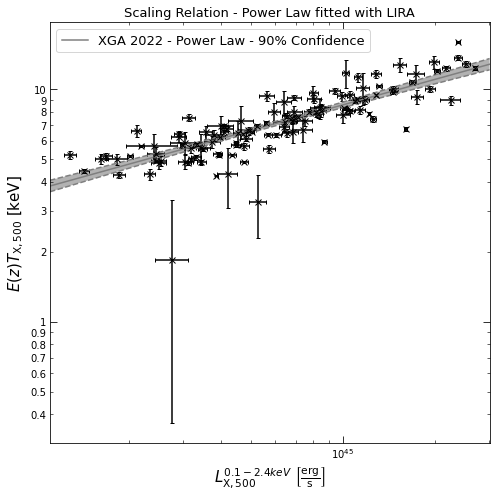

In [42]:
with open('lovisari_T500vsL_0.12.4_500.xgarel', 'rb') as reado:
    t_l_rel = pickle.load(reado)
t_l_rel.view(figsize=(7, 7))

## Predicting temperatures from luminosity

In [57]:
# Reading out the luminosities 
ls = need_obs['L500'].values*1e+44*Unit('erg/s')
# Passing luminosities into the predict method of the scaling relation, then dividing by E(z) to
#  to retrieve just the temperature.
pred_t = t_l_rel.predict(ls) / cosmo.efunc(need_obs['redshift'])
pred_t

<Quantity [3.97479614, 3.53077873, 4.44655277, 3.6196112 , 5.47337858,
           3.69187256, 3.70467009, 4.17384542, 3.72085222, 4.90176697,
           3.63763562, 3.99164003, 3.65330016, 3.92859596, 3.74259371,
           3.62178274, 4.98920492, 3.78273017, 5.08815623, 4.12094242,
           4.36557856, 3.66976472, 4.01996003, 3.53834327, 3.78246329,
           3.5275248 , 3.84605328, 4.2663457 , 4.7562144 , 3.80638327,
           3.53089471, 4.19870346, 3.63588761, 3.80073243] keV>

## Calculate fluxes from MCXC $L_{500}$ - REMOVE

In [191]:
need_obs['flux'] = ((need_obs['L500'].values*1e+44*Unit('erg/s'))/
                    (4*np.pi*(Planck15.luminosity_distance(
                        need_obs['redshift'].values)**2))).to('erg/(s cm^2)').value
need_obs['flux'].values

array([4.07685719e-12, 3.59094446e-12, 1.01058825e-11, 5.95455199e-12,
       9.46428127e-12, 2.96880113e-12, 3.18720847e-12, 6.08903628e-12,
       3.40034020e-12, 6.56932823e-12, 3.76286183e-12, 3.65467866e-12,
       3.35178887e-12, 6.83915858e-12, 3.21050669e-12, 2.86440901e-12,
       8.37279053e-12, 3.85449123e-12, 7.40382708e-12, 4.20495573e-12,
       4.67450265e-12, 2.85741857e-12, 1.07474066e-11, 3.85138921e-12,
       5.41197210e-12, 3.38552067e-12, 3.25611966e-12, 5.36503390e-12,
       8.71869188e-12, 3.97999290e-12, 2.77848823e-12, 1.00858386e-11,
       4.43473114e-12, 4.31148336e-12])

## Performing spectrum simulations

In [58]:
print(COUNTRATE_CONV_SCRIPT)
with open(COUNTRATE_CONV_SCRIPT, 'r') as c_script:
    script = c_script.read()

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/xspec_scripts/cr_conv_calc.xcm


In [190]:
print(script)

#  This code is a part of X-ray: Generate and Analyse (XGA), a module designed for the XMM Cluster Survey (XCS).
#  Last modified by David J Turner (david.turner@sussex.ac.uk) 25/08/2020, 11:49. Copyright (c) David J Turner

# This XSPEC script requires parameter's to be filled in by XGA before running.

# The purpose of this script is to calculate count-rate to flux and count-rate to luminosity conversion constants
# These have several uses, upper limit luminosities for instance, as well as making scaling brightness profiles
#  for stacking (see xga.sourcetools.stack).

# This loads the XGA fakeit readout script.
# source

# Allow the user to select the abundance table to use
abund {ab}

# The source object cosmology is used to setup XSPEC cosmo
cosmo {H0} {q0} {lamb0}

# Set up a list of paths to the RMFs we'll be using for fakeit
set rmf_paths {rmf}
# Do the same thing for the corresponding ARFs
set arf_paths {arf}
# Purely for my own convenience, I'm going to add corresponding list

In [40]:
# This is one of XCS' recent observations of DES clusters
DONOR_OBS = "0864080901"

# Setting up paths to files required for simulating XMM spectrum - these will be filled in with ObsID
#  and instrument when required
arf_path = "/its/home/dt237/xmm_obs/data/{o}/ecfs/{o}_{i}_exp1arf.fits"
rmf_path = "/its/home/dt237/xmm_obs/data/{o}/ecfs/{o}_{i}_exp1rmf.fits"
spec_path = "/its/home/dt237/xmm_obs/data/{o}/ecfs/{o}_{i}_exp1spec.fits"

In [ ]:
arfs_str = " ".join([arf_path.format(o=DONOR_OBS, i='pn'), 
                     arf_path.format(o=DONOR_OBS, i='mos1'), 
                     arf_path.format(o=DONOR_OBS, i='mos2')])
arfs_str = "{" + arfs_str + "}"
rmfs_str = " ".join([rmf_path.format(o=DONOR_OBS, i='pn'), 
                     rmf_path.format(o=DONOR_OBS, i='mos1'), 
                     rmf_path.format(o=DONOR_OBS, i='mos2')])
rmfs_str = "{" + rmfs_str + "}"

obs_str = "{" + " ".join([DONOR_OBS, DONOR_OBS, DONOR_OBS]) + "}"
inst_str = "{" + " ".join(['PN', 'MOS1', 'MOS2']) + "}"

lo_lims = "{0.5 0.1 0.01}"
hi_lims = "{2.0 2.4 100.0}"

In [119]:
# Reading out the luminosities 
obs_ls = obs_sample['L500'].values*1e+44*Unit('erg/s')
# Passing luminosities into the predict method of the scaling relation, then dividing by E(z) to
#  to retrieve just the temperature.
obs_pred_t = t_l_rel.predict(obs_ls) / cosmo.efunc(obs_sample['redshift'])

with tqdm(total=len(obs_sample), desc="") as onwards:
    for row_ind, row in obs_sample.iterrows():
        if not os.path.exists("sim_outputs/{}".format(row['name'])):
            os.makedirs("sim_outputs/{}".format(row['name']))
        
        outfile = os.getcwd()+"/sim_outputs/{}/sim.csv".format(row['name'])
        scfile = os.getcwd()+"/sim_outputs/{}/sim.xcm".format(row['name'])

        nh = nh_lookup(Quantity([row['ra'], row['dec']], 'deg'))[0].value
        temp = obs_pred_t[row_ind].value
        par_vals = "{" + " ".join([str(nh), str(temp), '0.3', str(row['redshift']), '1']) + "}"
        
        cur_script = script.format(ab='angr', H0=cosmo.H0.value, q0=0., lamb0=cosmo.Ode0, rmf=rmfs_str, 
                                   arf=arfs_str, obs=obs_str, inst=inst_str, m="tbabs*apec", 
                                   pn="{nH kT Abundanc Redshift norm}", pv=par_vals, lll=lo_lims, 
                                   lul=hi_lims, redshift=str(row['redshift']), of=outfile, rid=randint(0, 1e+8))
        
        with open(scfile, 'w') as scripto:
            scripto.write(cur_script)
                
        out, err = Popen("xspec - " + scfile, shell=True, stdout=PIPE, stderr=PIPE).communicate()
        onwards.update(1)

100%|███████████████████████████████████████████████████████████████████████| 110/110 [02:30<00:00,  1.36s/it]


In [186]:
obs_comb_exps = []
for row_ind, row in obs_sample.iterrows():
    outfile = os.getcwd()+"/sim_outputs/{}/sim.csv".format(row['name'])
    
    mcxc_lum = row['L500']*1e+44
    fak_info = pd.read_csv(outfile)

    sim_lum = fak_info.loc[1, 'Lx_{}PN'.format(DONOR_OBS)] * 10**44
    lum_rat = mcxc_lum / sim_lum
    
    pn_sim_cnt_rate_124 = fak_info.loc[1, 'rate_{}PN'.format(DONOR_OBS)]
    pn_sim_cnt_rate_52 = fak_info.loc[0, 'rate_{}PN'.format(DONOR_OBS)]
    pn_cr_124_to_52 = pn_sim_cnt_rate_52/pn_sim_cnt_rate_124
    m1_sim_cnt_rate_124 = fak_info.loc[1, 'rate_{}MOS1'.format(DONOR_OBS)]
    m1_sim_cnt_rate_52 = fak_info.loc[0, 'rate_{}MOS1'.format(DONOR_OBS)]
    m1_cr_124_to_52 = m1_sim_cnt_rate_52/m1_sim_cnt_rate_124
    m2_sim_cnt_rate_124 = fak_info.loc[1, 'rate_{}MOS2'.format(DONOR_OBS)]
    m2_sim_cnt_rate_52 = fak_info.loc[0, 'rate_{}MOS2'.format(DONOR_OBS)]
    m2_cr_124_to_52 = m2_sim_cnt_rate_52/m2_sim_cnt_rate_124
        
    pn_cr = fak_info.loc[1, 'rate_{}PN'.format(DONOR_OBS)] * lum_rat * pn_cr_124_to_52
    m1_cr = fak_info.loc[1, 'rate_{}MOS1'.format(DONOR_OBS)] * lum_rat * m1_cr_124_to_52
    m2_cr = fak_info.loc[1, 'rate_{}MOS2'.format(DONOR_OBS)] * lum_rat * m2_cr_124_to_52
    
    rel_src = lovoccs_noclean[row['name']]
    
    if len(rel_src.obs_ids) == 1:
        o = rel_src.obs_ids[0]
    else:
        ra, dec = rel_src.ra_dec.value
        matches = simple_xmm_match(ra, dec, Quantity(5, 'arcmin'))[0]
        matches = matches[matches['dist'] == matches['dist'].min()]
        o = matches['ObsID'].values[0]
    
    cnt_pn = rel_src.get_counts('r500', rel_src.ra_dec, Quantity(0.5, 'keV'), Quantity(2.0, 'keV'), o, 'mos2'))
    
#     comb_exp = Quantity(target_cnts/(pn_cr+m1_cr+m2_cr), 's')    
#     comb_exp = Quantity((target_cnts/pn_cr)+(target_cnts/m1_cr)+(target_cnts/m2_cr), 's')
    
    print(comb_exp, '\n')

-665.7050023375414 ct
65752.58740591345 s 

3522.34533692423 ct
65752.58740591345 s 

16463.874195321085 ct
65752.58740591345 s 

23642.418320935176 ct
65752.58740591345 s 

17679.84012612402 ct
65752.58740591345 s 

18652.021804264627 ct
65752.58740591345 s 



NoMatchFoundError: No XMM observation found within 5.0 arcmin of ra=8.5579 dec=-2.0753 

In [355]:
rads = []
nhs = []
with tqdm(total=len(need_obs), desc="") as onwards:
    for row_ind, row in need_obs.iterrows():
        if not os.path.exists("sim_outputs/{}".format(row['name'])):
            os.makedirs("sim_outputs/{}".format(row['name']))
        
        outfile = os.getcwd()+"/sim_outputs/{}/sim.csv".format(row['name'])
        scfile = os.getcwd()+"/sim_outputs/{}/sim.xcm".format(row['name'])

        nh = nh_lookup(Quantity([row['ra'], row['dec']], 'deg'))[0].value
        nhs.append(nh)
        rads.append(rad_to_ang(Quantity(row['R500'], 'Mpc'), row['redshift'], cosmo).to('arcmin').value)
        
        temp = pred_t[row_ind].value
        par_vals = "{" + " ".join([str(nh), str(temp), '0.3', str(row['redshift']), '1']) + "}"
        cur_script = script.format(ab='angr', H0=cosmo.H0.value, q0=0., lamb0=cosmo.Ode0, rmf=rmfs_str, 
                                   arf=arfs_str, obs=obs_str, inst=inst_str, m="tbabs*apec", 
                                   pn="{nH kT Abundanc Redshift norm}", pv=par_vals, lll=lo_lims, 
                                   lul=hi_lims, redshift=str(row['redshift']), of=outfile, rid=randint(0, 1e+8))
        
        with open(scfile, 'w') as scripto:
            scripto.write(cur_script)
                
        out, err = Popen("xspec - " + scfile, shell=True, stdout=PIPE, stderr=PIPE).communicate()
        onwards.update(1)
nhs = Quantity(nhs)
rads = Quantity(rads)

100%|█████████████████████████████████████████████████████████████████████████| 34/34 [00:46<00:00,  1.37s/it]


In [62]:
PIX_SIDE = Quantity(200, 'kpc')

In [356]:
comb_exps = []
stretch_comb_exps = []
for row_ind, row in need_obs.iterrows():
    area = np.pi*Quantity(row['R500'], 'Mpc').to('kpc')**2
    big_pixel_area = PIX_SIDE**2
    stretch_target_cnts = (area/big_pixel_area).value*500

    outfile = os.getcwd()+"/sim_outputs/{}/sim.csv".format(row['name'])
    
    mcxc_lum = row['L500']*1e+44
    fak_info = pd.read_csv(outfile)

    sim_lum = fak_info.loc[1, 'Lx_{}PN'.format(DONOR_OBS)] * 10**44
    lum_rat = mcxc_lum / sim_lum
    
    pn_sim_cnt_rate_124 = fak_info.loc[1, 'rate_{}PN'.format(DONOR_OBS)]
    pn_sim_cnt_rate_52 = fak_info.loc[0, 'rate_{}PN'.format(DONOR_OBS)]
    pn_cr_124_to_52 = pn_sim_cnt_rate_52/pn_sim_cnt_rate_124
    m1_sim_cnt_rate_124 = fak_info.loc[1, 'rate_{}MOS1'.format(DONOR_OBS)]
    m1_sim_cnt_rate_52 = fak_info.loc[0, 'rate_{}MOS1'.format(DONOR_OBS)]
    m1_cr_124_to_52 = m1_sim_cnt_rate_52/m1_sim_cnt_rate_124
    m2_sim_cnt_rate_124 = fak_info.loc[1, 'rate_{}MOS2'.format(DONOR_OBS)]
    m2_sim_cnt_rate_52 = fak_info.loc[0, 'rate_{}MOS2'.format(DONOR_OBS)]
    m2_cr_124_to_52 = m2_sim_cnt_rate_52/m2_sim_cnt_rate_124
        
    pn_cr = fak_info.loc[1, 'rate_{}PN'.format(DONOR_OBS)] * lum_rat * pn_cr_124_to_52
    m1_cr = fak_info.loc[1, 'rate_{}MOS1'.format(DONOR_OBS)] * lum_rat * m1_cr_124_to_52
    m2_cr = fak_info.loc[1, 'rate_{}MOS2'.format(DONOR_OBS)] * lum_rat * m2_cr_124_to_52
    
    if pred_t[row_ind].value <= 1.5:
        target_cnts = 1000
    elif pred_t[row_ind].value <= 3.0 and pred_t[row_ind].value > 1.5:
        target_cnts = 1500
    elif pred_t[row_ind].value <= 5.0 and pred_t[row_ind].value > 3:
        target_cnts = 2000
    else:
        target_cnts = 2500
    target_cnts *= 10
    
    comb_exp = Quantity(target_cnts/(pn_cr+m1_cr+m2_cr), 's')
#     print(comb_exp)
    
#     comb_exp = Quantity((target_cnts/pn_cr)+(target_cnts/m1_cr)+(target_cnts/m2_cr), 's')
    
#     print(comb_exp, '\n')
#     print(row)
#     print('')
#     print(row['name'], row['flux'], pn_cr, m1_cr, m2_cr)
#     print('\n\n\n')
    
    comb_exps.append(comb_exp)
    stretch_comb_exp = Quantity(stretch_target_cnts/(pn_cr+m1_cr+m2_cr), 's')
    stretch_comb_exps.append(stretch_comb_exp)

comb_exps = Quantity(comb_exps)*1.3
stretch_comb_exps = Quantity(stretch_comb_exps)*1.3

comb_exps[comb_exps < Quantity(5000, 's')] = Quantity(5000, 's')
round_to = 500
comb_exps = np.ceil(comb_exps / round_to) * round_to
need_obs['req_exp'] = comb_exps.value
need_obs['req_exp_str'] = stretch_comb_exps.value
need_obs['nH'] = nhs.value
need_obs['pred_T'] = pred_t.value
need_obs['rad'] = rads.value

In [103]:
need_obs.iloc[np.argwhere(comb_exps == Quantity(5000, 's')).T[0]]

,name,MCXC,ra,dec,redshift,L500,M500,R500,alt_name,other_names,Notes,flux,req_exp,req_exp_str,nH,pred_T
2,MCXCJ0043.8+2424,J0043.8+2424,10.967083,24.401944,0.0830,1.839590,2.8014,0.9690,ZwCl235,ZwCl235,NaN,1.010588e-11,5000.0,7547.061305,0.0358,4.446553
16,MCXCJ1130.3-1434,J1130.3-1434,172.581250,-14.583056,0.1068,2.605129,3.4062,1.0262,RXCJ1130.3-1434,A1285,NaN,8.372791e-12,5000.0,10027.945636,0.0339,4.989205
22,MCXCJ1336.1+5912,J1336.1+5912,204.025417,59.207778,0.0701,1.370998,2.3626,0.9193,RXCJ1336.1+5912,A1767,NaN,1.074741e-11,5000.0,6078.823867,0.0149,4.019960
28,MCXCJ1539.8+3043,J1539.8+3043,234.952917,30.717222,0.0980,2.257681,3.1409,1.0017,RXCJ1539.8+3043,A2110,NaN,8.718692e-12,5000.0,8909.164064,0.0211,4.756214
31,MCXCJ2250.3+1054,J2250.3+1054,342.587500,10.902500,0.0768,1.558638,2.5431,0.9401,RXCJ2250.3+1054,A2495,NaN,1.008584e-11,5000.0,7306.013138,0.0441,4.198703


In [125]:
need_obs.head(5)

,name,MCXC,ra,dec,redshift,L500,M500,R500,alt_name,other_names,Notes,req_exp,req_exp_str,nH,pred_T
0,MCXCJ0028.6-2338,J0028.6-2338,7.163750,-23.637222,0.1120,1.404549,2.3285,0.9024,RXCJ0028.6-2338,A42,NaN,9494.549340,15181.071267,0.0141,3.974796
1,MCXCJ0041.7+2124,J0041.7+2124,10.446250,21.413889,0.1014,1.000012,1.9071,0.8473,RXCJ0041.7+2124,A84,NaN,11261.500681,15874.518828,0.0270,3.530779
2,MCXCJ0043.8+2424,J0043.8+2424,10.967083,24.401944,0.0830,1.839590,2.8014,0.9690,ZwCl235,ZwCl235,NaN,5000.000000,7547.061305,0.0358,4.446553
3,MCXCJ0049.8+2426,J0049.8+2426,12.452083,24.441111,0.0815,1.042960,1.9841,0.8641,A104,A104,NaN,7187.945286,10538.108432,0.0458,3.619611
4,MCXCJ0052.7-8015,J0052.7-8015,13.187083,-80.266389,0.1141,3.393306,3.9812,1.0783,RXCJ0052.7-8015,A2837,NaN,5631.548882,10285.536404,0.0551,5.473379


In [363]:
for_table = need_obs.copy()
for_table = for_table.drop(columns=['MCXC', 'alt_name', 'other_names', 'Notes', 'req_exp_str', 'pred_T', 
                                    'M500', 'R500'])
for_table = for_table[['name', 'ra', 'dec', 'nH', 'redshift', 'L500', 'rad', 'req_exp']]
for_table[['ra', 'dec', 'L500', 'redshift', 'rad']] = for_table[['ra', 'dec', 'L500', 'redshift', 'rad']].round(2)
for_table['nH'] = for_table['nH'].round(3)
for_table['req_exp'] /= 1000
del for_table['ra']
del for_table['dec']
for_table = for_table.rename(columns={'name': 'MCXC Name', 'redshift': 'z', 'req_exp': 'T', 'rad': 'R'})
for_table = for_table.sort_values('L500')
for_table['MCXC Name'] = for_table['MCXC Name'].apply(lambda x: x.strip('MCXC'))
print(for_table['T'].sum())
for_table.head(5)

332.5


,MCXC Name,nH,z,L500,R,T
1,J0041.7+2124,0.027,0.10,1.00,7.67,11.5
23,J1416.8-1158,0.053,0.10,1.00,7.90,11.5
25,J1459.0-0843,0.065,0.10,1.00,7.47,13.5
30,J2125.2-0657,0.067,0.12,1.02,6.82,16.5
3,J0049.8+2426,0.046,0.08,1.04,9.51,7.5


In [364]:
print(for_table.to_latex(index=False))

\begin{tabular}{lrrrrr}
\toprule
   MCXC Name &    nH &    z &  L500 &     R &    T \\
\midrule
J0041.7+2124 & 0.027 & 0.10 &  1.00 &  7.67 & 11.5 \\
J1416.8-1158 & 0.053 & 0.10 &  1.00 &  7.90 & 11.5 \\
J1459.0-0843 & 0.065 & 0.10 &  1.00 &  7.47 & 13.5 \\
J2125.2-0657 & 0.067 & 0.12 &  1.02 &  6.82 & 16.5 \\
J0049.8+2426 & 0.046 & 0.08 &  1.04 &  9.51 &  7.5 \\
J2350.5+2931 & 0.046 & 0.10 &  1.07 &  8.27 & 10.0 \\
J0759.7+5400 & 0.032 & 0.10 &  1.09 &  7.67 & 11.0 \\
J1027.9-0647 & 0.048 & 0.12 &  1.10 &  6.80 & 15.0 \\
J0821.0+0751 & 0.019 & 0.11 &  1.11 &  7.26 & 12.0 \\
J1332.9-2519 & 0.052 & 0.12 &  1.14 &  6.73 & 15.5 \\
J0212.8-4707 & 0.017 & 0.12 &  1.16 &  7.02 & 12.5 \\
J0107.8-3643 & 0.020 & 0.12 &  1.16 &  6.82 & 13.5 \\
J0726.0+4122 & 0.075 & 0.11 &  1.17 &  7.21 & 13.5 \\
J1431.1+2538 & 0.028 & 0.09 &  1.19 &  8.82 &  7.5 \\
J1006.6+2554 & 0.027 & 0.12 &  1.20 &  7.00 & 12.5 \\
J1139.4-3327 & 0.053 & 0.11 &  1.22 &  7.55 & 11.5 \\
J2359.9-3928 & 0.011 & 0.10 &  1.23 &  7

In [369]:
sample['L500'].min()

1.000012

In [86]:
comb_exps.sum()

<Quantity 325841.33891177 s>

In [75]:
stretch_comb_exps.sum()

<Quantity 499594.08339619 s>

In [46]:
for src in lovoccs_noclean:
    print(src.redshift)
    try:
        print([e.get_exp(src.ra_dec) for e in src.get_expmaps(lo_en=Quantity(0.5, 'keV'), 
                                                         hi_en=Quantity(2.0, 'keV'))])
    except ValueError:
        pass
    print('')

0.1164
[<Quantity 3037.0246582 s>, <Quantity 5803.31542969 s>, <Quantity 5639.02978516 s>]

0.1147
[<Quantity 7444.33056641 s>, <Quantity 12121.45800781 s>, <Quantity 12899.22167969 s>, <Quantity 4725.58789062 s>, <Quantity 15747.25195312 s>, <Quantity 16518.50976562 s>, <Quantity 1745.77172852 s>, <Quantity 5068.65283203 s>, <Quantity 5280.79248047 s>]

0.062
[<Quantity 8722.8125 s>, <Quantity 11018.63085938 s>, <Quantity 11936.01464844 s>]

0.1073
[<Quantity 18583.14453125 s>, <Quantity 26240.0625 s>, <Quantity 28254.0703125 s>]

0.094
[<Quantity 26713.98632812 s>, <Quantity 30639.421875 s>, <Quantity 30119.34375 s>]

0.094

0.0822
[<Quantity 0. s>, <Quantity 0. s>, <Quantity 1967.27429199 s>, <Quantity 996.83099365 s>, <Quantity 0. s>, <Quantity 4303.69580078 s>, <Quantity 7664.6875 s>, <Quantity 0. s>, <Quantity 4959.14404297 s>, <Quantity 926.23944092 s>, <Quantity 0. s>, <Quantity 1877.66137695 s>]

0.0812
[<Quantity 2689.59301758 s>, <Quantity 2698.37182617 s>, <Quantity 2635.39

[<Quantity 7652.95410156 s>, <Quantity 10929.75585938 s>, <Quantity 10413.1484375 s>, <Quantity 5868.20996094 s>, <Quantity 10232.359375 s>, <Quantity 10545.1875 s>]

0.0766

0.0817
[<Quantity 1697.25622559 s>, <Quantity 0. s>, <Quantity 11353.56445312 s>, <Quantity 0. s>, <Quantity 0. s>, <Quantity 0. s>]

0.1181
[<Quantity 20762.25 s>, <Quantity 25834.015625 s>, <Quantity 25948.38671875 s>, <Quantity 4680.89990234 s>, <Quantity 6243.72167969 s>, <Quantity 6620.890625 s>]

0.1198
[<Quantity 0. s>, <Quantity 0. s>, <Quantity 0. s>]

0.0353
[<Quantity 4212.68652344 s>, <Quantity 10695.68359375 s>, <Quantity 10833.67089844 s>, <Quantity 21998.08203125 s>, <Quantity 27098.15039062 s>, <Quantity 26489.49804688 s>, <Quantity 2342.58862305 s>, <Quantity 8139.47607422 s>, <Quantity 13021.14355469 s>, <Quantity 12337.69921875 s>, <Quantity 19827.69726562 s>, <Quantity 18599.33203125 s>, <Quantity 3108.12817383 s>, <Quantity 10786.43066406 s>, <Quantity 11320.43554688 s>, <Quantity 5153.1928710

[<Quantity 21465.61132812 s>, <Quantity 26564.1875 s>, <Quantity 27187.515625 s>]

0.0852
[<Quantity 54238.83984375 s>, <Quantity 50766.29296875 s>, <Quantity 49309.61328125 s>, <Quantity 536.15765381 s>, <Quantity 14363.08496094 s>, <Quantity 14345.40917969 s>, <Quantity 48609.0078125 s>, <Quantity 45933.01171875 s>, <Quantity 39614.73828125 s>, <Quantity 29888.59570312 s>, <Quantity 72162.484375 s>, <Quantity 78332.8515625 s>]

0.0957
[<Quantity 14942.93164062 s>, <Quantity 18703.08789062 s>, <Quantity 18858.1328125 s>, <Quantity 2534.69335938 s>, <Quantity 5969.84912109 s>, <Quantity 3825.65258789 s>]

0.0786
[<Quantity 8324.17675781 s>, <Quantity 3462.65087891 s>, <Quantity 12660.42675781 s>]

0.03
[<Quantity 24717.53710938 s>, <Quantity 28694.4921875 s>, <Quantity 27680.6171875 s>, <Quantity 40709.65625 s>, <Quantity 45816.3671875 s>, <Quantity 51974.7109375 s>]

0.0765
[<Quantity 11593.07617188 s>, <Quantity 17722.07617188 s>, <Quantity 17903.77539062 s>]

0.0475
[<Quantity 59758

In [47]:
for src in lovoccs_noclean:
    highest = 0
    for obs in src.instruments:
        cur_obs = 0
        for inst in src.instruments[obs]:
            cur_obs += src.get_counts('r500', src.ra_dec, Quantity(0.5, 'keV'), 
                                      Quantity(2.0, 'keV'), obs, inst)
        if cur_obs > highest:
            highest = cur_obs
    
    print(highest)

0
34596.25010752931 ct
71109.34265438234 ct
92336.8145915279 ct
80728.44783209133 ct
75151.13385178668 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area


4368.149756581518 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area


7788.085398219771 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

151362.44613858516 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area


114126.24496945867 ct
35266.830884757095 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

190973.241411269 ct
765829.3185927388 ct
62633.340651123275 ct
42689.65528114255 ct
89163.34062130254 ct
170492.50914254988 ct
58770.58593022842 ct
1259887.1969510405 ct
30660.30201552483 ct
98216.86286740596 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

2415.606697133698 ct
35583.00759994862 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

0


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area


266381.64215982397 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

242417.08140223016 ct
17547.9433360271 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area


589079.2178930761 ct
18109.25872620149 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

41106.59786554266 ct
92496.94973777936 ct
17187.284676858177 ct
2789.586493549687 ct
140172.46706488385 ct
36574.86266875356 ct
46637.72697497097 ct
205487.4872284327 ct
21259.083426515303 ct
73607.51449187518 ct
146173.67938454638 ct
86326.34132929126 ct
388480.2143185422 ct
123819.9705098753 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

0


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

48081.2405948253 ct
73601.33844848775 ct
137725.12584168132 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

33597.55619702085 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

314237.1375445036 ct
105655.51027887964 ct
15074.627208733626 ct
128509.46576556665 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')


0
36246.11541311824 ct
60462.168223512446 ct
1259767.5300539173 ct
12291.21180521059 ct
73680.08444077449 ct
0


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

182204.86552937835 ct
30836.34790894873 ct
225286.8114968351 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

0
195850.79002075328 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

20221.28320656746 ct
102656.70615402814 ct
143856.16366880323 ct
1007539.8395851409 ct
225771.86419030293 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

0
34375.706351286004 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

22395.209430075338 ct
9432.305077446917 ct
233415.84245591683 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

218967.9828401684 ct
96771.96527331925 ct
65888.3641575933 ct
66965.21529394976 ct
24791.772845234646 ct
61852.90784252143 ct
50067.26340866074 ct
73245.53346553542 ct
37640.552571586624 ct
86250.17903801777 ct
29939.70441022341 ct
188226.52805341885 ct
28696.411982849553 ct
27441.006103707354 ct
99578.7772811974 ct
65140.31018630834 ct
46254.7359433667 ct
54164.30779751239 ct
187098.4317360794 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area


100539.56648591965 ct
283790.9490199859 ct
141525.2812291665 ct
174252.47114063884 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area


28200.075973837804 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area


5256.02032731526 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: invalid value encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')


46761.58223199441 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')


0
58116.25045932521 ct
117898.10408808454 ct
35665.626689903365 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')


0
647581.5971719836 ct
90445.31176306811 ct
72975.70947660158 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

0
74861.42730971167 ct


/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quantity(tot_cnt - (bck_cnt*area_norm), 'ct')
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3022: RuntimeWarning: divide by zero encountered in double_scalars
  area_norm = src_area / back_area
/mnt/pact/dt237/code/PycharmProjects/XGA/xga/products/phot.py:3030: RuntimeWarning: invalid value encountered in double_scalars
  cnts = Quant

0
12843.693541042107 ct


## Positions of the LoVoCCs clusters - with extra information

In [11]:
all_obs = list(set([o for oset in lovoccs_noclean.obs_ids.values() for o in oset]))
pos_obs = match_obs_pos(all_obs)
xmm_pnt_ra = Quantity(pos_obs['RA_PNT'].values, 'deg')
xmm_pnt_dec = Quantity(pos_obs['DEC_PNT'].values, 'deg')

In [344]:
steps = 100
start_stop = SkyCoord([0, 0], [90, -90], frame='galactic', unit='deg').transform_to('fk5')

# line_path = SkyCoord(np.zeros(steps), np.linspace(90, -90, steps), frame='galactic', unit='deg').transform_to('fk5')
line_path = SkyCoord(np.linspace(0, 0, steps), np.linspace(90, -90, steps), frame='galactic', 
                     unit='deg').transform_to('fk5')
line_path = SkyCoord(np.linspace(359.94423568, 0, steps), np.linspace(-0.04616002, -90, steps), frame='galactic', 
                     unit='deg').transform_to('fk5')
359.94423568,-0.04616002

ra_erass = Quantity(line_path.ra, 'deg')
dec_erass = Quantity(line_path.dec, 'deg')

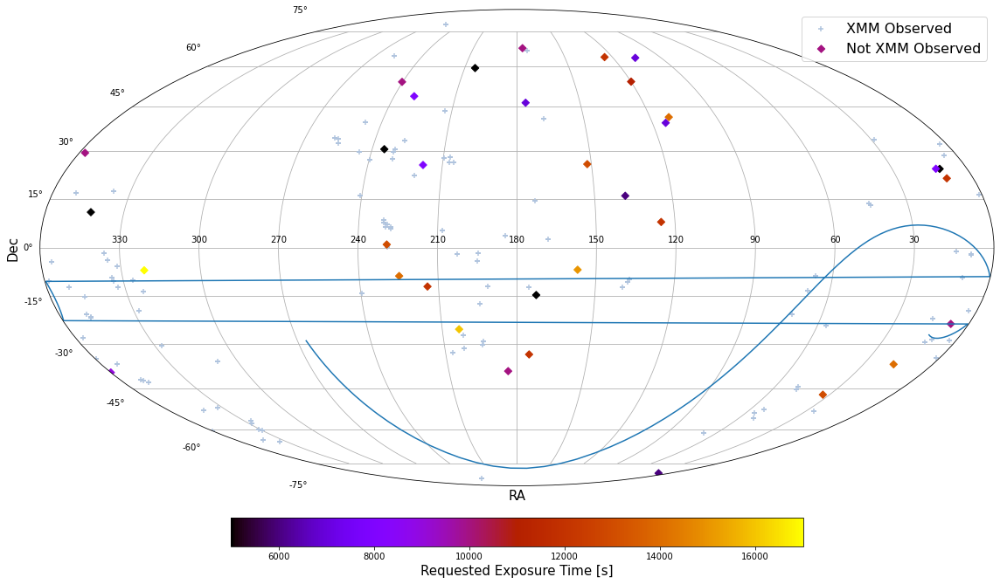

In [345]:
# Extract the RAs and Decs, shift them to the flipped x-axis astronomy 
#  convention, convert to radians
ra_xmm = Quantity(obs_sample['ra'].values-180, 'deg')
ra_xmm = -ra_xmm 
ra_xmm = ra_xmm.to('rad')
dec_xmm = Quantity(obs_sample['dec'].values, 'deg').to('rad')

ra_no_obs = Quantity(need_obs['ra'].values-180, 'deg')
ra_no_obs = -ra_no_obs 
ra_no_obs = ra_no_obs.to('rad')
dec_no_obs = Quantity(need_obs['dec'].values, 'deg').to('rad')

xmm_pnt_ra_rad = -(xmm_pnt_ra-Quantity(180, 'deg'))
xmm_pnt_ra_rad = xmm_pnt_ra_rad.to('rad')
xmm_pnt_dec_rad = xmm_pnt_dec.to('rad')

ra_erass_rad = -(ra_erass-Quantity(180, 'deg'))
ra_erass_rad = ra_erass_rad.to('rad')
dec_erass_rad = dec_erass.to('rad')

# Setting up the figure
fig = plt.figure(figsize=(16, 13))
# Adding a subplot specifically with the Mollweide projection
ax = fig.add_subplot(111, projection='mollweide' )
ax.scatter(ra_xmm, dec_xmm, marker='+', color=obs_col, label="XMM Observed", zorder=2)
to_obs = ax.scatter(ra_no_obs, dec_no_obs, marker='D', c=need_obs['req_exp'], 
                    label="Not XMM Observed", cmap='gnuplot', zorder=2)

plt.plot(ra_erass_rad, dec_erass_rad)

# for ra_ind, ra in enumerate(xmm_pnt_ra_rad):
#     dec = xmm_pnt_dec_rad[ra_ind]
#     # Create the artist with an approximate XMM field of view radius of 0.25 degrees (15 arcmin).
#     #  Edges are left darker to illustrate the boundaries of individual observations in the central
#     #  contiguous region
#     artist = Circle([ra.value, dec.value], 0.004363323, fill=True, fc='tab:gray', 
#                     ec='tab:gray', linewidth=1, 
#                     linestyle='solid', alpha=0.3)
#     ax.add_artist(artist)
# ax.scatter(xmm_pnt_ra_rad, xmm_pnt_dec_rad, marker='o', edgecolors='firebrick', alpha=0.6, zorder=1, 
#            fc="None", s=200)

# # Makes another artist for us to use in the legend, as otherwise we wouldn't get the correct circle next
# #  to XMM Observations
# circle = Line2D([0], [0], color="black", marker='o', markerfacecolor="tab:gray", 
#                 label='XMM Observations', markersize=14, linewidth=0, alpha=0.3)


# Set up a grid and custom hour labels for the RA axis
ax.grid(True)
ax.set_xticklabels(['330','300','270','240','210','180','150','120','90','60','30'])
# Create x and y axis labels
plt.xlabel('RA', fontsize=15)
plt.ylabel(r'Dec', fontsize=15)

plt.legend(fontsize=16)
cb = plt.colorbar(to_obs, location='bottom', shrink=0.6, pad=0.04)
cb.set_label(label='Requested Exposure Time [s]', size=15)
plt.tight_layout()
plt.savefig('lovoccs_loc.png')
plt.show()